# ``Taming Performance Variability''

### <font color='red'> Main notebook for analysis of memory performance</font>

In [1]:
import os, sys
import pandas as pd
import numpy as np
import string
import matplotlib.pyplot as plt
#import seaborn.apionly as sns
import seaborn as sns
import matplotlib.dates as md
from matplotlib import gridspec
import matplotlib.patches as patches
import datetime as dt
from collections import OrderedDict 
from collections import deque
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.regression.quantile_regression import QuantReg
import warnings
from scipy.stats import norm
from IPython.display import IFrame
from IPython.display import Markdown, display
from IPython.display import FileLink, FileLinks
from matplotlib.ticker import MaxNLocator

warnings.filterwarnings(action='once')

# With plot_show_and_save() defined below, there is no need for this configuration
# (all plots should use plot_show_and_save())
#%matplotlib inline

# Improve plot quality for retina displays
%config InlineBackend.figure_format = 'retina'

# Read all inputs from this directory
source_dir = "../data/raw-data/"
# Save all dataframes and plots into this directory 
dest_dir = "output/"

if not os.path.isdir(dest_dir):
    os.mkdir(dest_dir)

# db -- dictinary with keys - table names, values - dataframes with table data
db = {}

for f in os.listdir(source_dir):
    if ".csv" in f:
        db[os.path.splitext(f)[0]] = pd.read_csv(source_dir + f)
    
# Allows setting values in dataframe copies without warnings (default='warn')
pd.options.mode.chained_assignment = None 

# If vebose is set, additional debug info will be printed throughout the notebook
verbose = True
if verbose:
    print "Keys: ", db.keys()
    for k, df in db.iteritems():
        #print "Sample from %s:" % k 
        #print df.head(3), "\n\n" 
        print "Columns in %s:" % k, df.columns.tolist(), "\n"

####  Define default graphics parameters ###

####  Include common helper functions
sys.path.append("bench-lib/")
from common import *

/opt/conda/envs/py27/lib/python2.7/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


Keys:  ['disk_info', 'iperf3_info', 'iperf3_results', 'ping_results', 'env_info', 'membench_info', 'disk_results', 'fio_info', 'stream_info', 'network_info', 'mem_results', 'ping_info']
Columns in disk_info: ['run_uuid', 'timestamp', 'nodeid', 'nodeuuid', 'disk_name', 'disk_model', 'disk_serial', 'disk_size', 'npartitions', 'disk_type'] 

Columns in iperf3_info: ['run_uuid', 'timestamp', 'nodeid', 'nodeuuid', 'version', 'local_ip', 'local_port', 'remote_ip', 'remote_port', 'remote_nodeid', 'protocol', 'num_streams', 'buffer_size', 'omitted_intervals', 'duration', 'time_units'] 

Columns in iperf3_results: ['run_uuid', 'timestamp', 'nodeid', 'nodeuuid', 'reverse', 'retransmits', 'local_cpu_util', 'remote_cpu_util', 'median', 'max', 'min', 'mean', 'stdev', 'sum_sent', 'sum_received', 'units'] 

Columns in ping_results: ['run_uuid', 'timestamp', 'nodeid', 'nodeuuid', 'runtime', 'packets_sent', 'packets_received', 'packet_loss', 'max', 'min', 'mean', 'stdev', 'ipg', 'ewma', 'units'] 

Colu

In [2]:
# Print high-level info 

print "The earliest disk perf sample: ", dt.datetime.fromtimestamp(db['disk_results']['timestamp'].min())
print "The latest disk perf sample: ", dt.datetime.fromtimestamp(db['disk_results']['timestamp'].max())

print "The earliest memory perf sample: ", dt.datetime.fromtimestamp(db['mem_results']['timestamp'].min())
print "The latest memory perf sample: ", dt.datetime.fromtimestamp(db['mem_results']['timestamp'].max())

print "Total number of samples: ", len(db['mem_results'])

db['disk_results'].sample(20).T 

The earliest disk perf sample:  2017-05-20 09:18:32
The latest disk perf sample:  2018-04-04 18:12:08
The earliest memory perf sample:  2017-05-20 09:18:32
The latest memory perf sample:  2018-04-04 18:12:08
Total number of samples:  749712


,11205,70691,75200,35261,109416,39777,81809,42719,4933,14724,54092,14117,120824,29568,86999,38774,46857,126923,92890,55858
run_uuid,540d1c5c-06e2-4d36-b8c2-fa49cc156bda,bad0dcb0-c826-41f9-b78d-f834903e724f,6b5d973c-81ae-4c86-a2f3-6c4b0d4630b6,e6e624a6-0864-4e95-888b-96322c774b12,c30bbadb-ea45-4d44-a098-3f9f64a81327,f01dc998-ab32-4532-b211-e043f972f77b,0c2014fe-b088-436e-8ef1-732a9557aeca,475a4369-1afb-439c-8305-4d99afa7de92,b226f967-8822-4fd4-9581-6efeeb7b99a3,1c7bf97f-df8e-4831-87cd-8e1aa6243b6f,33381b2b-a630-471a-afe3-46ddf6ee7eda,f53653ed-5951-455d-aa7f-7679ab19feca,fb97c0db-e690-4b80-8559-8d7212182784,f02b55bc-3544-4248-8756-bcabb146be9c,bd3e8f16-7690-4630-a803-2f176db6a1bf,8931237e-602a-49dd-9663-04bca06def6b,14759411-2bc2-42cf-8b82-52f186e6fc4f,622d962a-9f64-4b0a-888f-9a2c6f240ae0,7c44721a-0673-494c-b1f9-38dbdbfeaf68,bef53534-419d-4d84-80c0-d319f27421ae
timestamp,1497011252,1508264817,1510038349,1500163475,1516693190,1500747992,1511400385,1501202763,1496147261,1497464795,1503080764,1497398799,1519307345,1499450741,1512479258,1500619568,1501742762,1520341929,1513625197,1503317165
nodeid,c220g2-011311,c220g2-011328,ms1345,ms0218,c220g1-031130,c220g2-011324,c220g2-011002,clnode054,c220g2-011118,c220g2-011124,c220g2-011306,ms0214,clnode094,ms0139,ms1316,clnode014,clnode096,ms1019,c220g1-031102,ms0202
nodeuuid,1942048c-e8ec-11e5-a488-a3bb994732a6,1812bc79-e8ec-11e5-a488-a3bb994732a6,e85ccf14-8ffe-11e6-8c08-a53a3a50acf8,68d2e6cc-72da-11e4-85c8-179a28bd1b8c,a99b4379-3c7e-11e6-b435-eb3e622294a9,186d0f6b-e8ec-11e5-a488-a3bb994732a6,1a9ff8c2-e8ec-11e5-a488-a3bb994732a6,d2497f36-d7f1-11e4-b34b-000099989701,4fb0e96f-e8d4-11e5-a488-a3bb994732a6,50f64291-e8d4-11e5-a488-a3bb994732a6,1a5ae701-e8ec-11e5-a488-a3bb994732a6,6934a203-72da-11e4-85c8-179a28bd1b8c,d5ba149b-d7f1-11e4-b34b-000099989701,46e271ac-72d5-11e4-85c8-179a28bd1b8c,e19ead88-8ffe-11e6-8c08-a53a3a50acf8,ce8adaf3-d7f1-11e4-b34b-000099989701,d5d10b1c-d7f1-11e4-b34b-000099989701,4c248ff9-8ffa-11e6-8c08-a53a3a50acf8,6ad9998c-3e70-11e6-b435-eb3e622294a9,6a5914d3-72da-11e4-85c8-179a28bd1b8c
testname,randread,write,read,read,read,randread,read,randwrite,randread,randwrite,randwrite,read,randwrite,randwrite,randwrite,write,read,randread,write,randwrite
runtime,720.253,55.839,13.6,55.109,21.407,720.319,58.426,720.009,720.278,45.19,45.094,54.549,720.458,720.002,15.813,197.111,92.87,157.095,122.522,720.319
size,2.1888e+06,1.04858e+07,1.04858e+07,1.04858e+07,1.04858e+07,2.08026e+06,1.04858e+07,1.0352e+06,2.10816e+06,1.04858e+07,1.04858e+07,1.04858e+07,1.07658e+06,1.4151e+06,1.04858e+07,1.04858e+07,1.04858e+07,1.04858e+07,1.04858e+07,1.42328e+06
max,3328,197528,816968,194888,492496,3216,199776,2088,3343,251968,256216,197272,1961,2000,787432,58192,121376,75184,104688,2003
min,0,154696,278392,157758,484632,0,154616,733,0,199448,203472,186696,0,1832,515343,49400,76461,62176,83928,0
mean,3039.07,187529,769595,190107,489876,2888.13,179334,1439.5,2928.22,231579,232170,192351,1494.35,1967.17,661878,53201.3,112829,66752.8,85587.6,1975.98


In [3]:
raw_mem_all, mem_all = process_memory(db)

print "Number of samples in raw_mem_all:", len(raw_mem_all)
print "Number of samples in mem_all:", len(mem_all)

Number of samples in raw_mem_all: 749712
Number of samples in mem_all: 741034


In [4]:
#mem_all.to_csv("memory.csv", index=False)

In [5]:
# Find a subset of configurations with more than a specified number of samples

count_thresh = 50 

selected_groups = db["mem_results"].groupby(['nodeid','testname', \
                                              "dvfs", "socket_num"]).size().reset_index().rename(columns={0:'count'})
selected_groups = selected_groups[selected_groups["count"] >= count_thresh].sort_values("count", ascending=False)

print "Number of unique configurations with >=%d samples: %d" % (count_thresh, len(selected_groups))
selected_groups.sample(10).T

Number of unique configurations with >=50 samples: 2186


,30280,50060,49646,49014,22355,31989,24048,34237,32586,30472
nodeid,clnode035,ms0406,ms0321,ms0221,c220g2-011311,clnode048,c220g2-011324,clnode065,clnode053,clnode036
testname,copy,add,scale,read_memory_loop,read_memory_avx,read_memory_sse_omp,read_memory_sse,write_memory_sse_omp,copy,write_memory_avx
dvfs,no,yes,yes,yes,yes,no,no,no,yes,no
socket_num,0,0,0,0,1,1,0,1,0,0
count,57,72,89,90,81,60,74,61,52,56


In [6]:
# Create a new dataframe with aggregate statistics for all samples that match found configurations

# Merging in this cell might take a long time

mem_aggr = selected_groups.copy() 

key_list = ["nodeid", "testname", "dvfs", "socket_num"]

for idx in range(len(mem_aggr)):
 
    # Find all samples that represent a particular configuration
    # It is important to use selected_groups.iloc, not mem_aggr.iloc
    # (otherwise, disk_type columns collide when merging)
    subset = pd.merge(selected_groups.iloc[[idx]], mem_all, on=key_list)
    
    idx_label = mem_aggr.index[idx]
    mem_aggr.at[idx_label, "mean_mean"] = subset["mean"].mean()
    mem_aggr.at[idx_label, "mean_min"] = subset["mean"].min()
    mem_aggr.at[idx_label, "stdev_mean"] = np.sqrt((subset["stdev"] ** 2).mean())
    mem_aggr.at[idx_label, "stdev_max"] = subset["stdev"].max()
       
    #disk_aggr.at[idx_label, "disk_type"] = column2val(subset_detailed, "disk_type") 
    #disk_aggr.at[idx_label, "disk_name"] = column2val(subset_detailed, "disk_name")  
    #disk_aggr.at[idx_label, "disk_model"] = column2val(subset_detailed, "disk_model")  
    mem_aggr.at[idx_label, "mem_clock_speed"] = column2val(subset, "mem_clock_speed")
    mem_aggr.at[idx_label, "hw_type"] = column2val(subset, "hw_type")
    mem_aggr.at[idx_label, "units"] = column2val(subset, "units")
    
mem_aggr.reset_index(inplace=True)
df2csv(mem_aggr, "mem_aggr.csv", dest_dir)
    
mem_aggr.sample(20).T

,1098,1563,520,563,1229,541,1250,1448,20,944,1942,1017,735,443,197,1272,908,1911,551,1631
index,34143,32009,23915,23245,30322,22065,30302,29768,49211,49347,32646,29770,22541,23332,22019,30383,29370,38104,23276,30336
nodeid,clnode065,clnode048,c220g2-011323,c220g2-011318,clnode035,c220g2-011308,clnode035,clnode031,ms0235,ms0245,clnode053,clnode031,c220g2-011312,c220g2-011318,c220g2-011308,clnode035,clnode027,clnode096,c220g2-011318,clnode035
testname,read_memory_loop_omp,write_memory_avx,read_memory_rep_lodsq,copy_omp,read_memory_sse,write_memory_rep_stosq,read_memory_loop_omp,copy,read_memory_loop_omp,add_omp,triad_omp,copy,write_memory_avx_omp,write_memory_nontemporal_avx_omp,triad,write_memory_nontemporal_sse_omp,write_memory_sse,read_memory_loop,read_memory_rep_lodsq_omp,triad
dvfs,yes,no,yes,no,yes,no,yes,no,yes,yes,yes,yes,no,no,yes,yes,yes,no,no,no
socket_num,1,1,1,1,0,1,0,0,0,0,0,0,1,0,1,1,0,0,0,0
count,65,60,75,75,62,75,62,60,95,67,52,65,73,75,79,62,68,53,75,57
mean_mean,39228.7,7543.08,10360.6,10175.2,10875.8,5363.95,39117.2,10063.6,27245.6,18693.2,27198.4,10063.6,6503.3,9806.81,10808.7,33516.7,7811.92,10612.6,18256.9,11308.5
mean_min,39179.1,7515.81,8535.77,10015.7,10850.6,5291.35,39051.8,10012.6,27089.4,18566.6,26922,9952.44,6448.14,9788.55,10705.6,33407.7,7788.01,10593.6,18072.9,11293.5
stdev_mean,29.7284,2.26841,884.901,53.2009,5.03348,5.78785,26.5855,29.8035,59.4445,206.036,58.9223,31.6969,22.879,33.5033,69.8802,63.7403,3.10844,4.0066,98.3918,28.346
stdev_max,97.86,4.2,1420.88,128.87,9.29,20.28,54.06,50.47,172.18,256.54,96.3,50.44,64.92,110.69,82.88,136.75,4.32,6.91,334.85,50.71


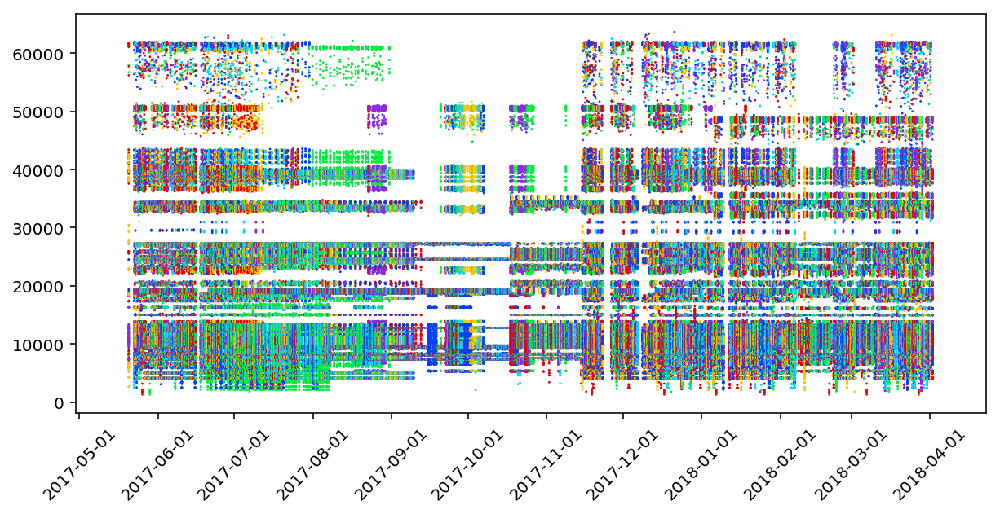

/notebooks/output/mem_timeline.pdf

In [7]:
# Plot all collected values versus timestamps (colors show different nodeid's) 

# This needs to be fixed; now this call uses the second implementation in common.py; needs to 
# differentiate two implementations better
color_map = get_cmap(mem_all, "nodeid")

fig, ax = plt.subplots(figsize=(10, 5))
ax.scatter([dt.datetime.fromtimestamp(ts) for ts in mem_all["timestamp"].tolist()],
           mem_all["mean"], 
           c = [color_map[n] for n in mem_all["nodeid"].tolist()], s=2.0, lw=0.0, label='_nolegend_');

xfmt = md.DateFormatter('%Y-%m-%d')
ax.xaxis.set_major_formatter(xfmt);

plt.subplots_adjust(bottom=0.2);

for tick in ax.get_xticklabels():
    tick.set_rotation(45)

plot_show_and_save(fig, "mem_timeline.pdf", dest_dir)

In [8]:
# Example of subsetting based on criteria in a dictionary

subset_df(mem_aggr, {"testname": "add_omp", "dvfs": "yes", "socket_num": 1}, verbose=True).sample(5)

Subsetting dataframe. Initial # of rows: 2186, socket_num==1: 960, testname==add_omp: 30, dvfs==yes: 16


,index,nodeid,testname,dvfs,socket_num,count,mean_mean,mean_min,stdev_mean,stdev_max,mem_clock_speed,hw_type,units
436,23879,c220g2-011323,add_omp,yes,1,75,11243.642667,11180.7,16.741379,54.44,2133MHz,c220g2,MB/s
911,29255,clnode027,add_omp,yes,1,68,26879.763235,26709.3,57.477714,153.33,1333MHz,c8220,MB/s
764,22471,c220g2-011312,add_omp,yes,1,73,11111.927397,11016.0,24.237265,71.80,2133MHz,c220g2,MB/s
283,24007,c220g2-011324,add_omp,yes,1,77,11244.048052,11174.8,24.461186,109.60,2133MHz,c220g2,MB/s
364,23239,c220g2-011318,add_omp,yes,1,77,11234.359211,11051.9,24.018642,94.06,2133MHz,c220g2,MB/s


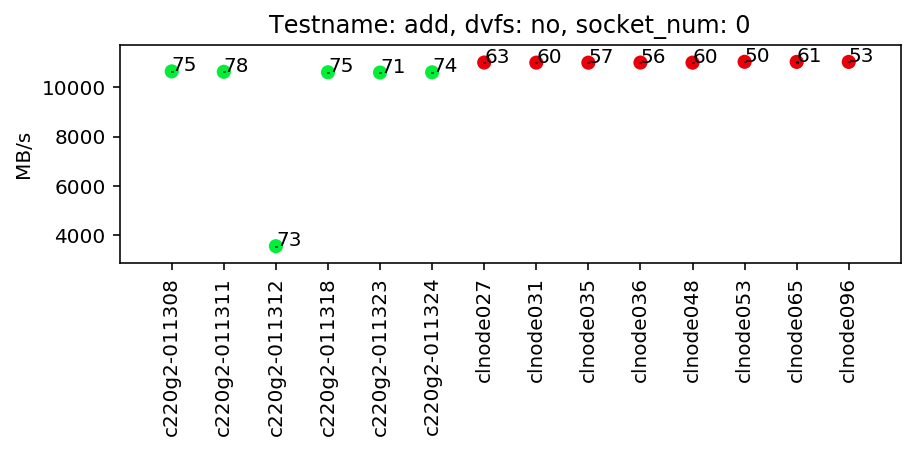

/notebooks/output/mem-aggr1-add-no-0.pdf

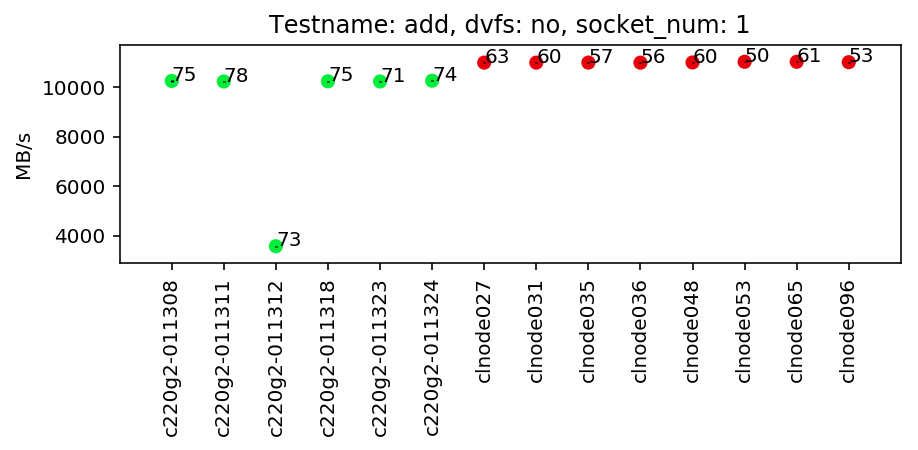

/notebooks/output/mem-aggr1-add-no-1.pdf

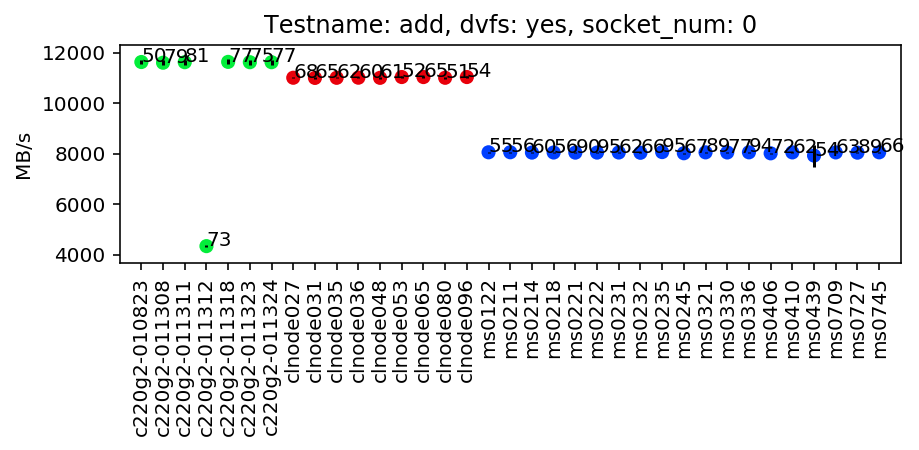

/notebooks/output/mem-aggr1-add-yes-0.pdf

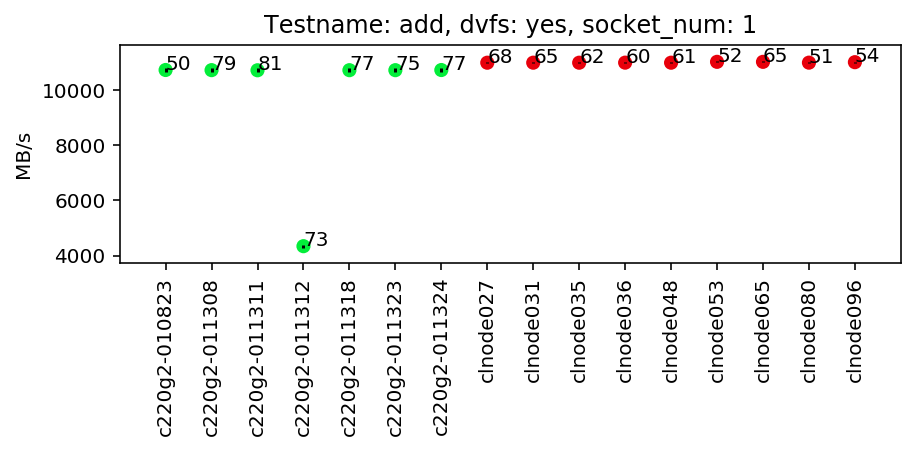

/notebooks/output/mem-aggr1-add-yes-1.pdf

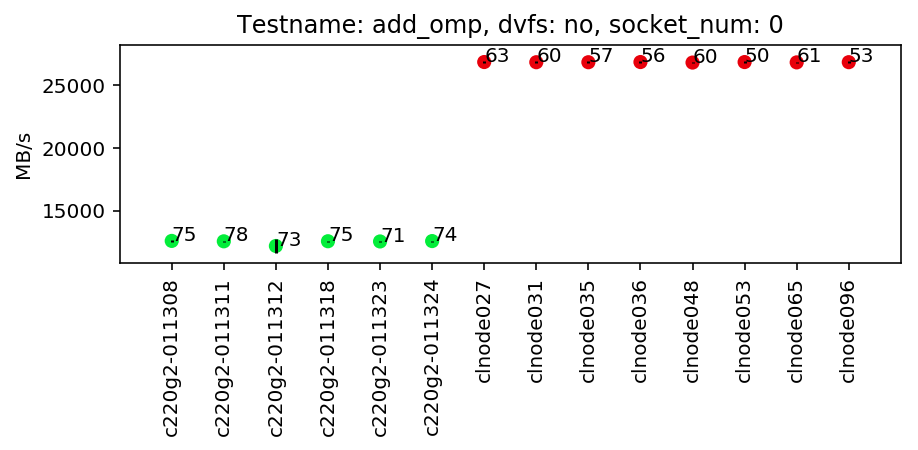

/notebooks/output/mem-aggr1-add_omp-no-0.pdf

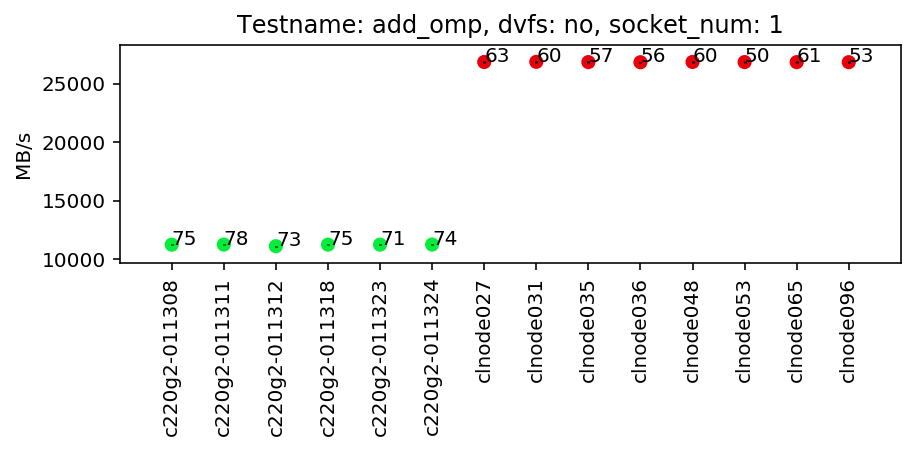

/notebooks/output/mem-aggr1-add_omp-no-1.pdf

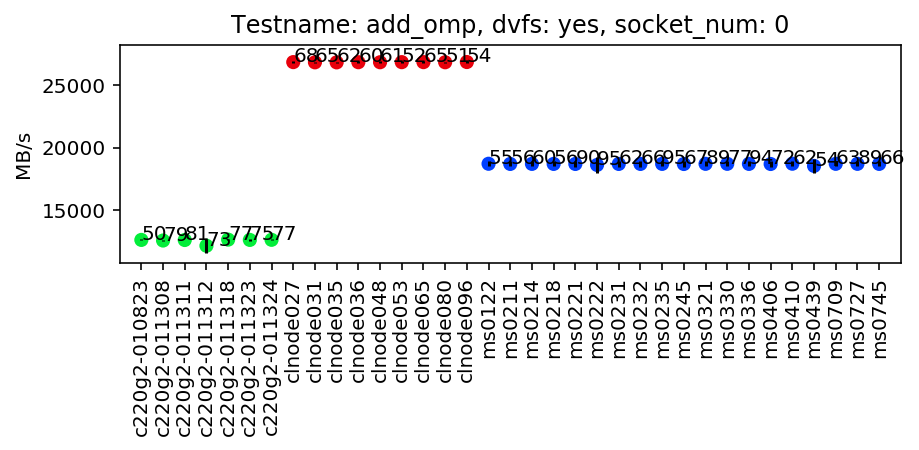

/notebooks/output/mem-aggr1-add_omp-yes-0.pdf

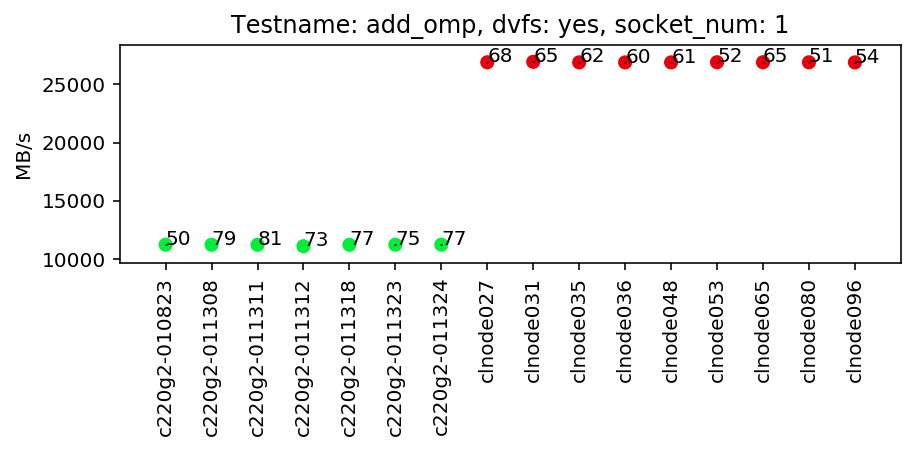

/notebooks/output/mem-aggr1-add_omp-yes-1.pdf

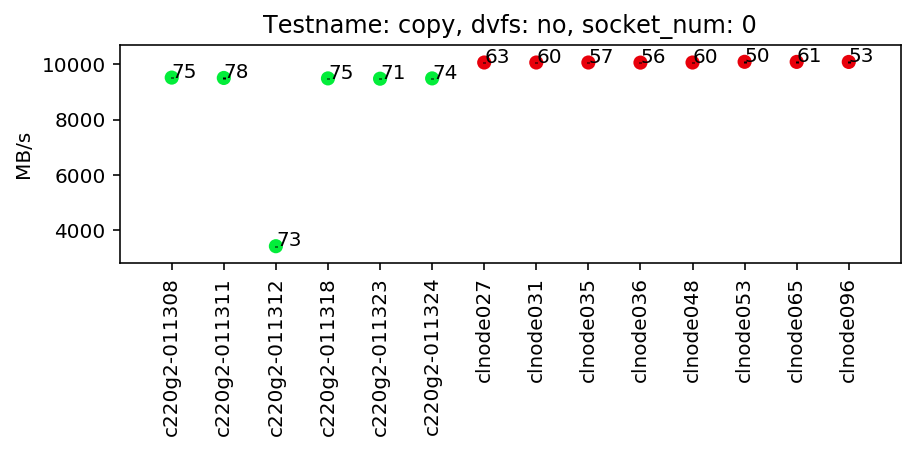

/notebooks/output/mem-aggr1-copy-no-0.pdf

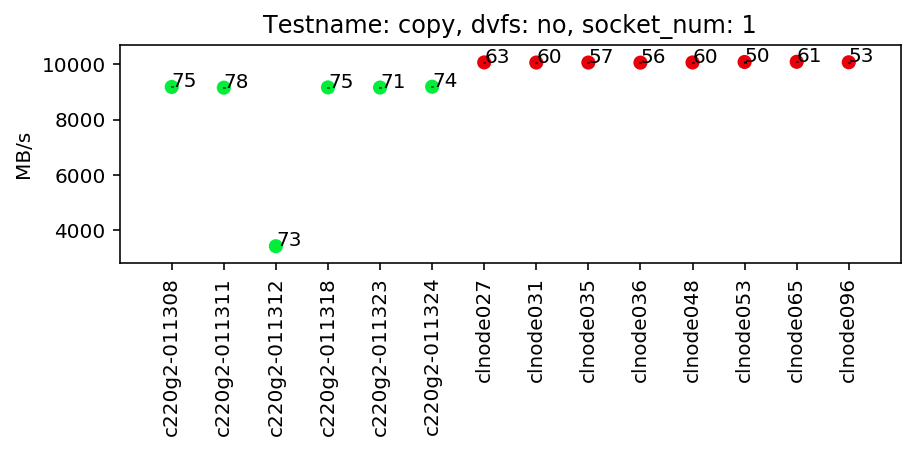

/notebooks/output/mem-aggr1-copy-no-1.pdf

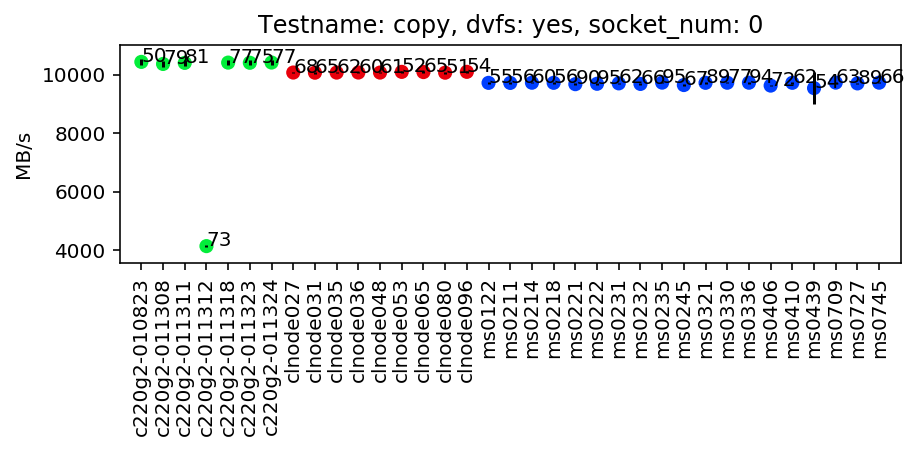

/notebooks/output/mem-aggr1-copy-yes-0.pdf

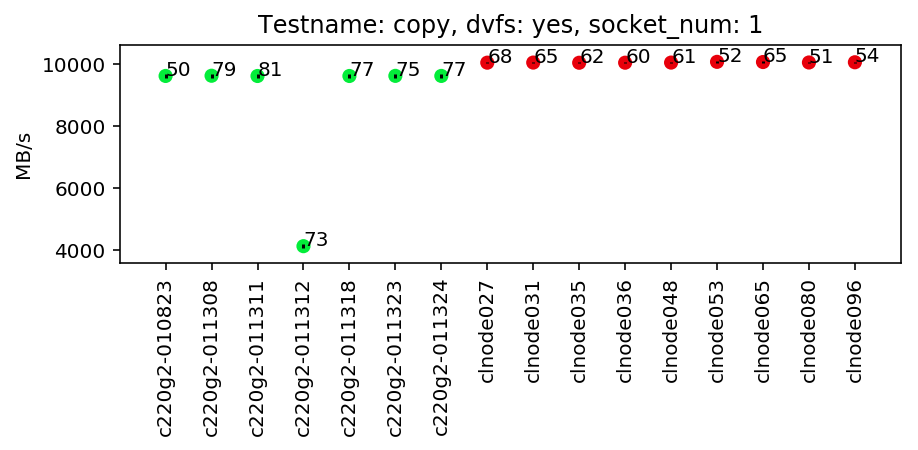

/notebooks/output/mem-aggr1-copy-yes-1.pdf

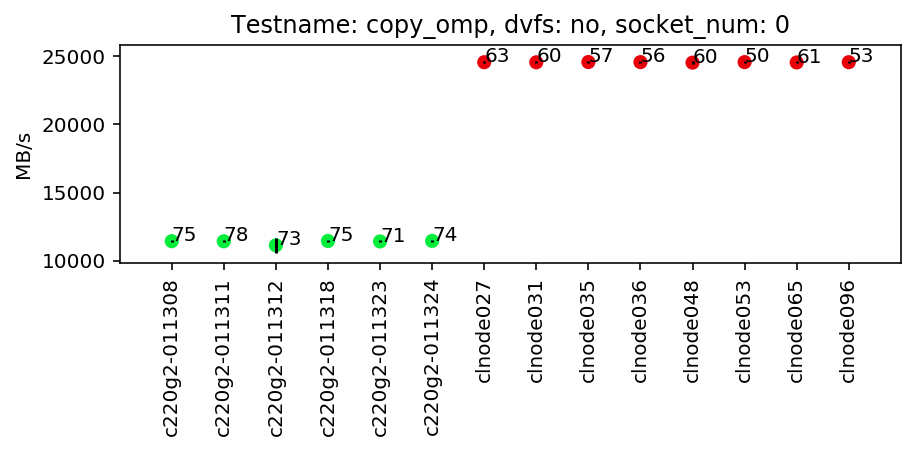

/notebooks/output/mem-aggr1-copy_omp-no-0.pdf

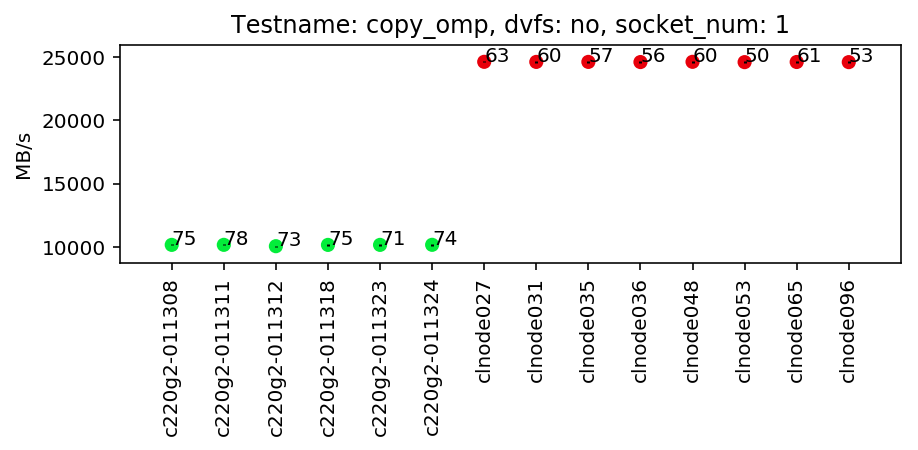

/notebooks/output/mem-aggr1-copy_omp-no-1.pdf

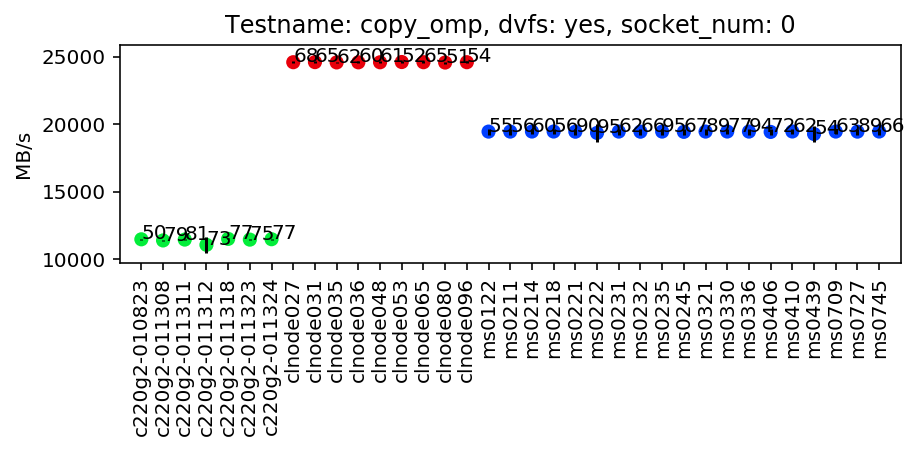

/notebooks/output/mem-aggr1-copy_omp-yes-0.pdf

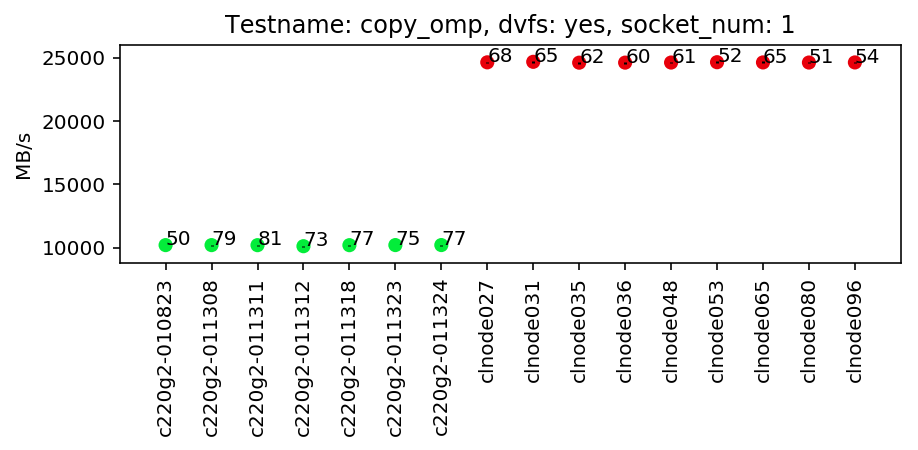

/notebooks/output/mem-aggr1-copy_omp-yes-1.pdf

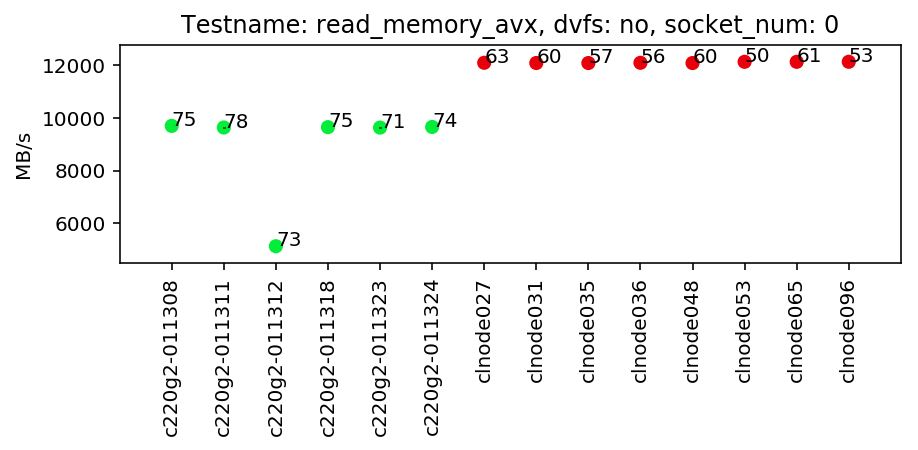

/notebooks/output/mem-aggr1-read_memory_avx-no-0.pdf

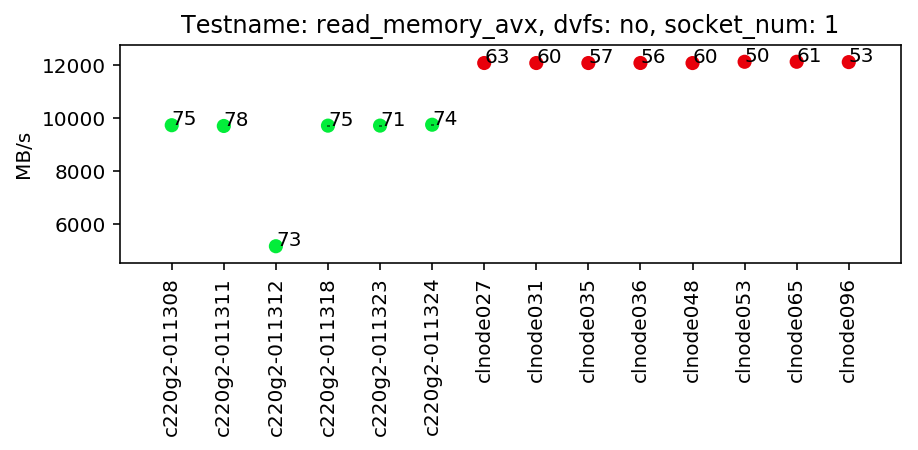

/notebooks/output/mem-aggr1-read_memory_avx-no-1.pdf

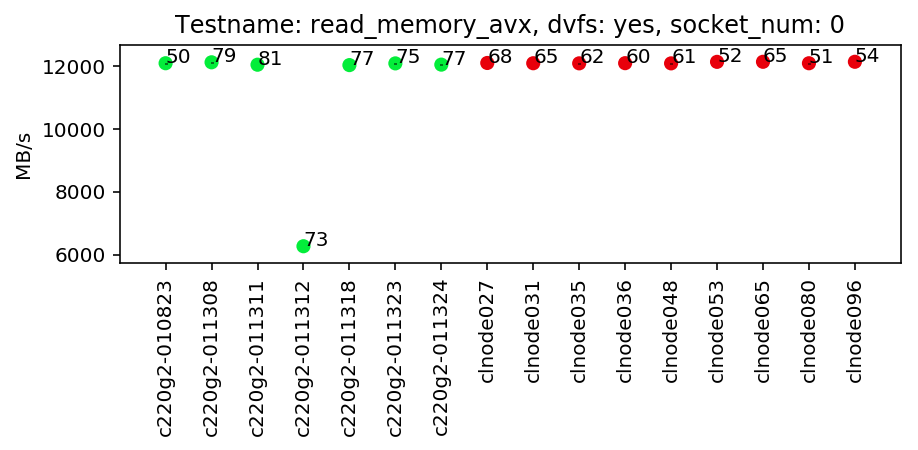

/notebooks/output/mem-aggr1-read_memory_avx-yes-0.pdf

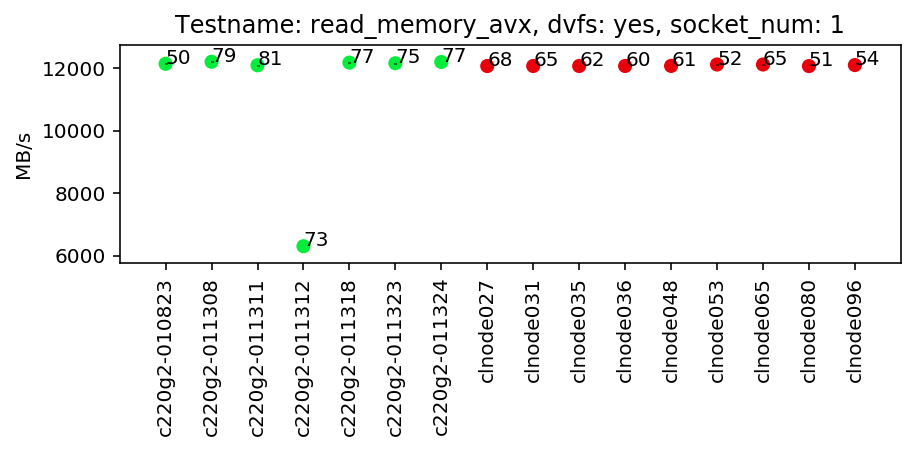

/notebooks/output/mem-aggr1-read_memory_avx-yes-1.pdf

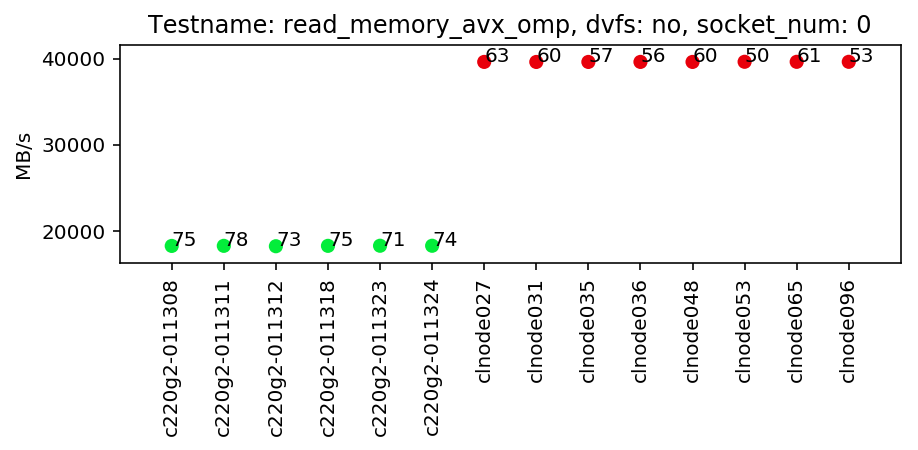

/notebooks/output/mem-aggr1-read_memory_avx_omp-no-0.pdf

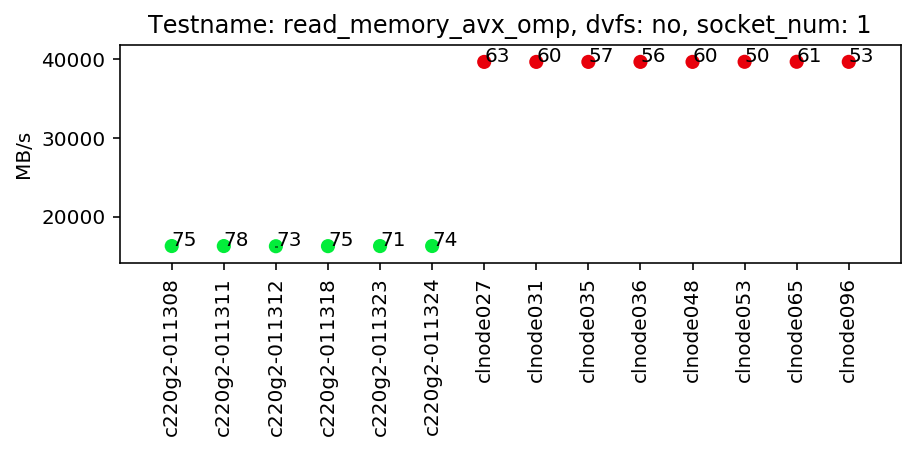

/notebooks/output/mem-aggr1-read_memory_avx_omp-no-1.pdf

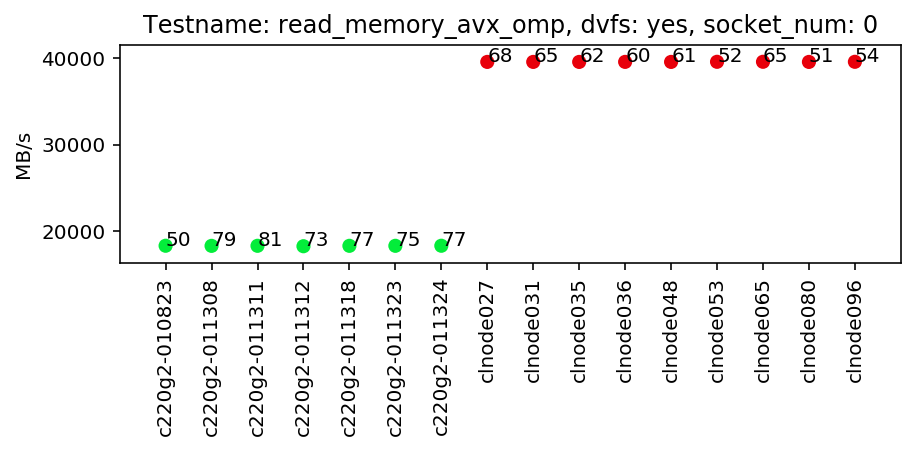

/notebooks/output/mem-aggr1-read_memory_avx_omp-yes-0.pdf

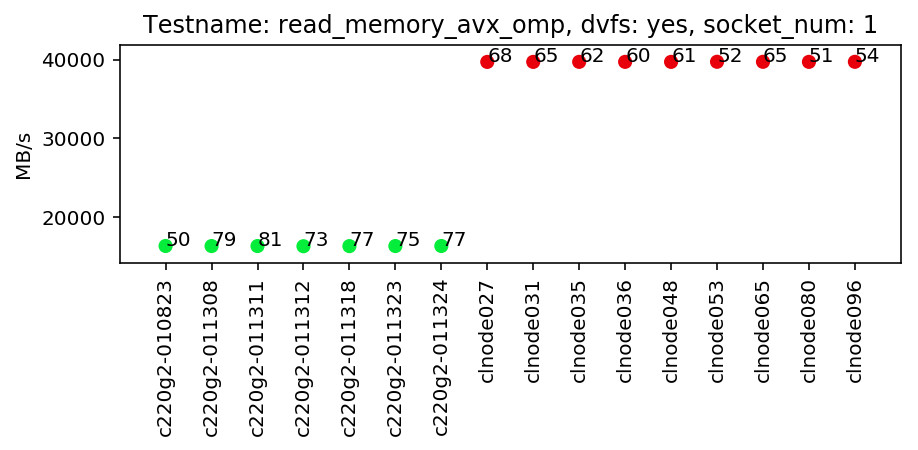

/notebooks/output/mem-aggr1-read_memory_avx_omp-yes-1.pdf

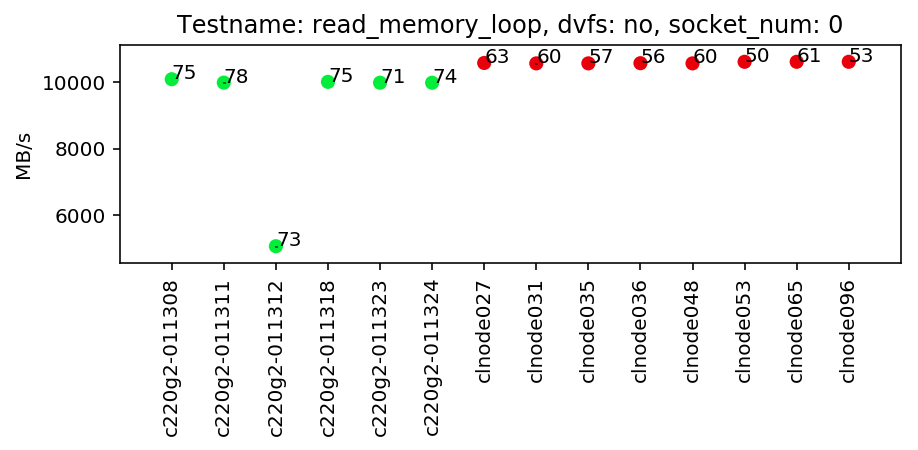

/notebooks/output/mem-aggr1-read_memory_loop-no-0.pdf

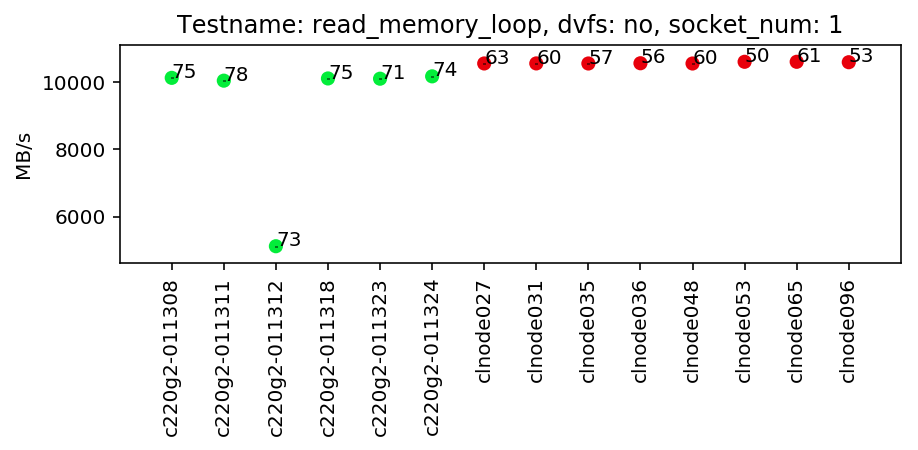

/notebooks/output/mem-aggr1-read_memory_loop-no-1.pdf

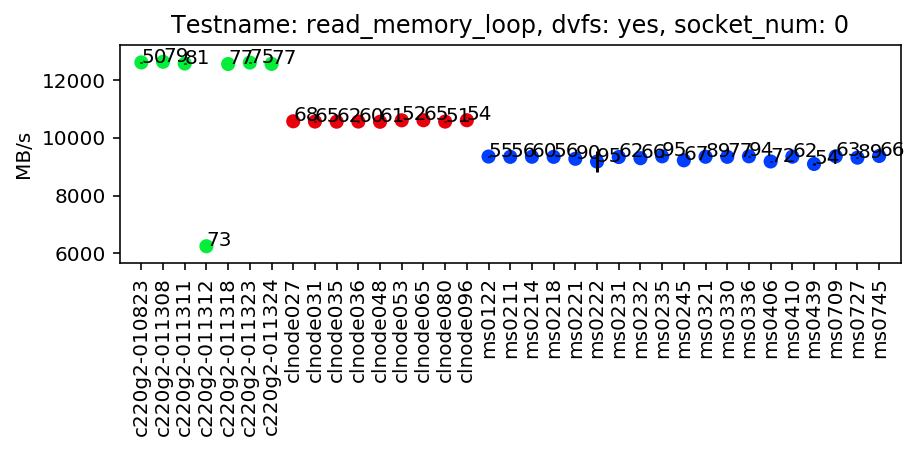

/notebooks/output/mem-aggr1-read_memory_loop-yes-0.pdf

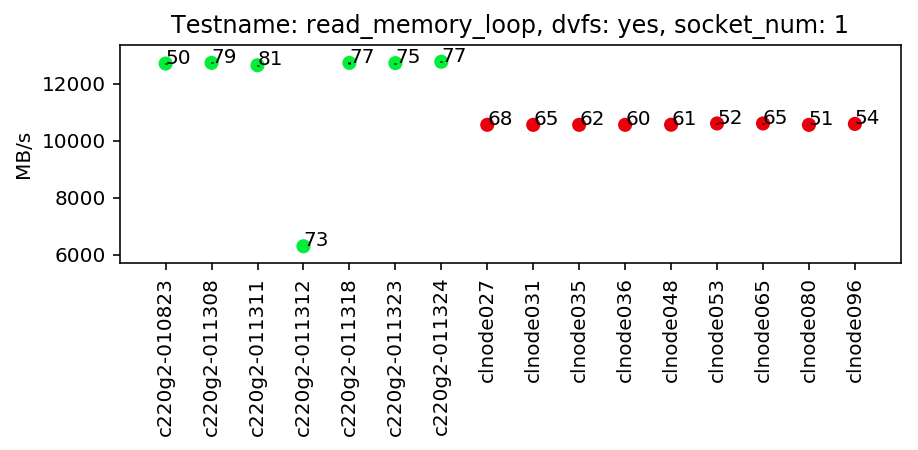

/notebooks/output/mem-aggr1-read_memory_loop-yes-1.pdf

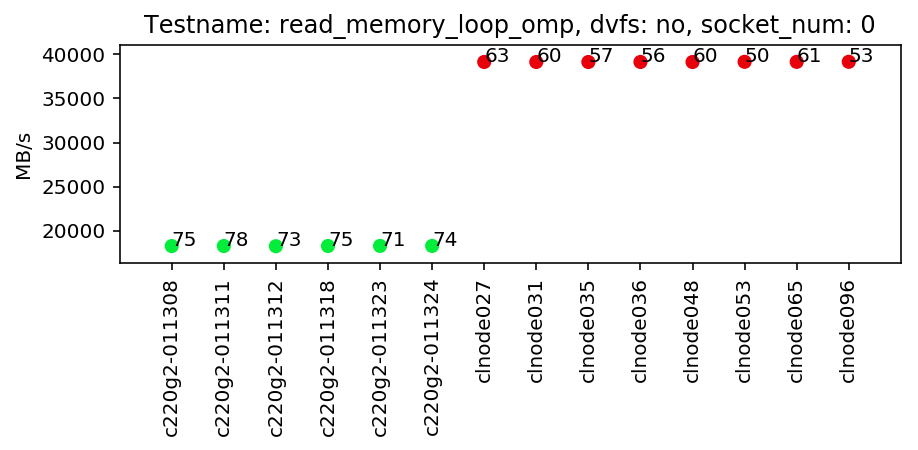

/notebooks/output/mem-aggr1-read_memory_loop_omp-no-0.pdf

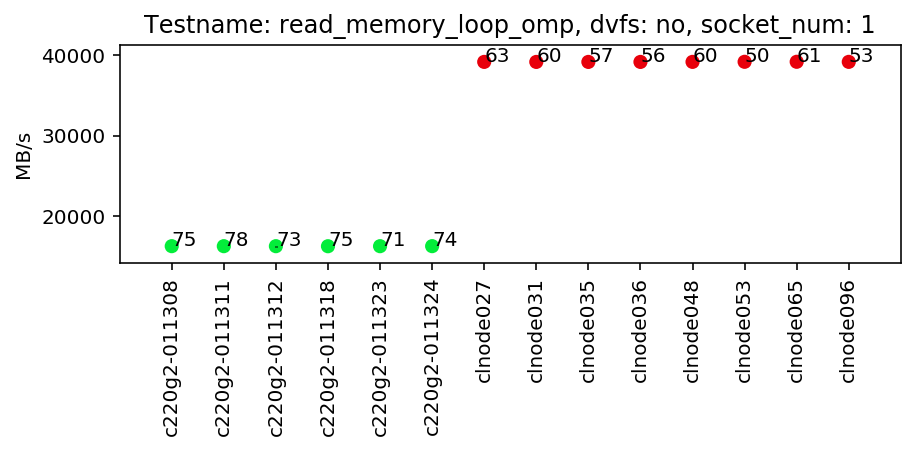

/notebooks/output/mem-aggr1-read_memory_loop_omp-no-1.pdf

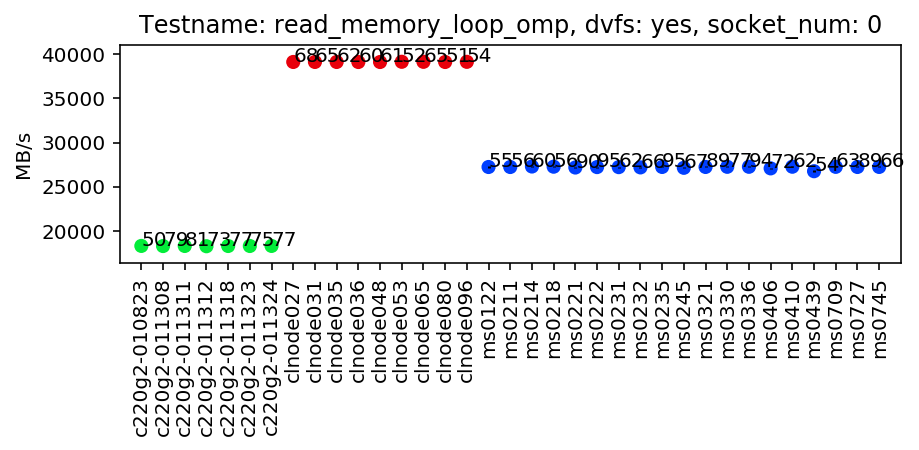

/notebooks/output/mem-aggr1-read_memory_loop_omp-yes-0.pdf

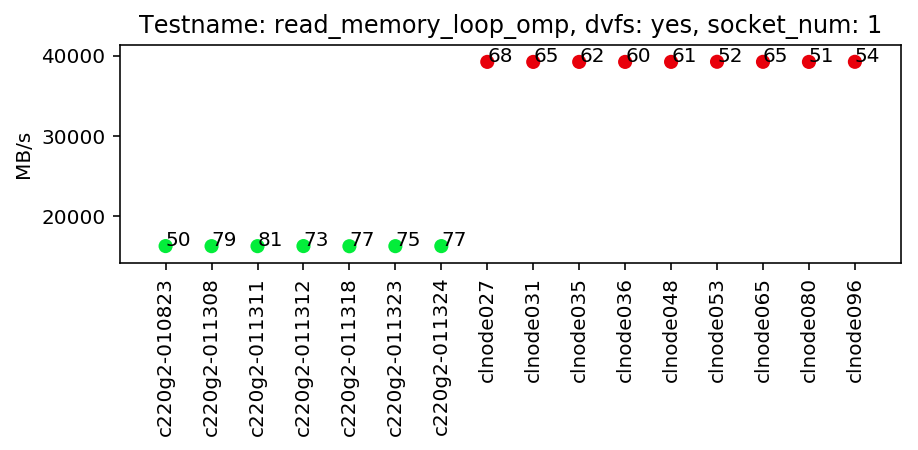

/notebooks/output/mem-aggr1-read_memory_loop_omp-yes-1.pdf

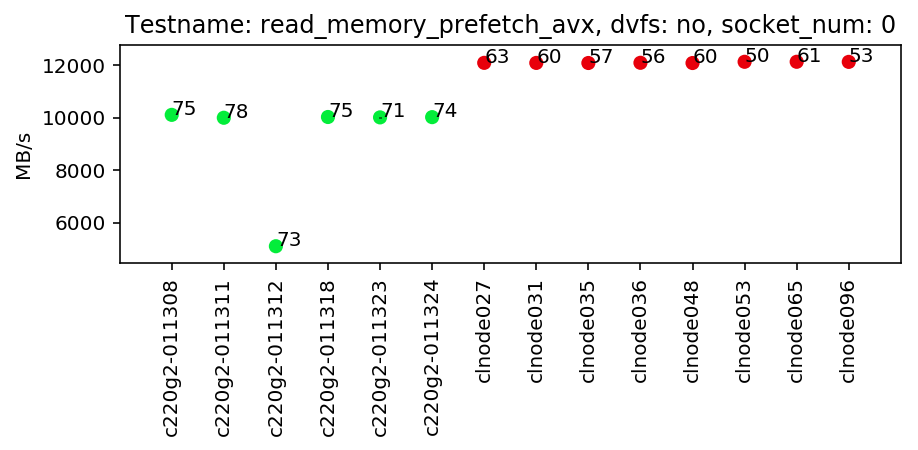

/notebooks/output/mem-aggr1-read_memory_prefetch_avx-no-0.pdf

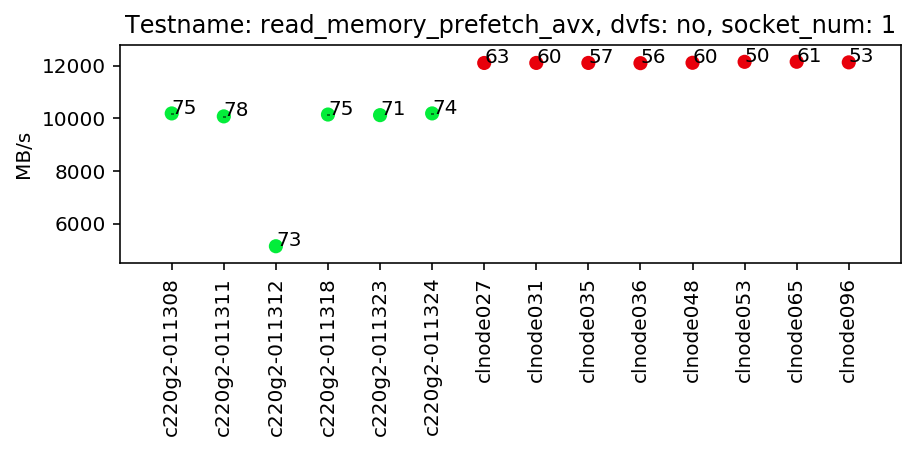

/notebooks/output/mem-aggr1-read_memory_prefetch_avx-no-1.pdf

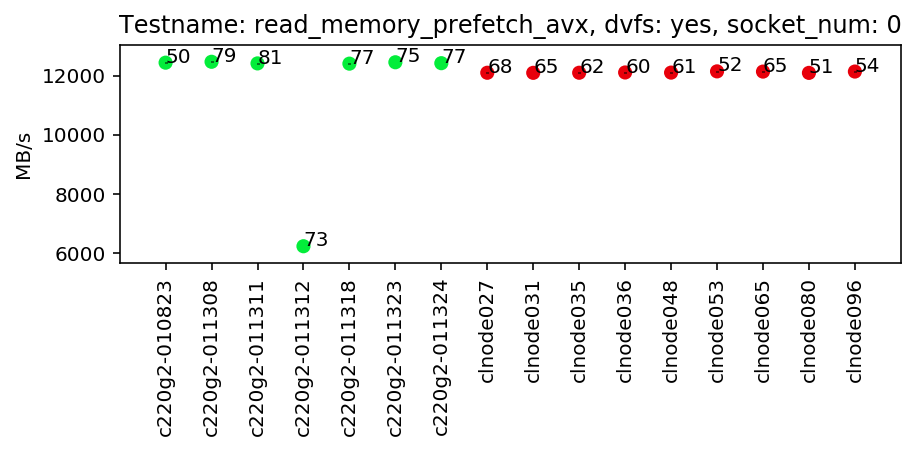

/notebooks/output/mem-aggr1-read_memory_prefetch_avx-yes-0.pdf

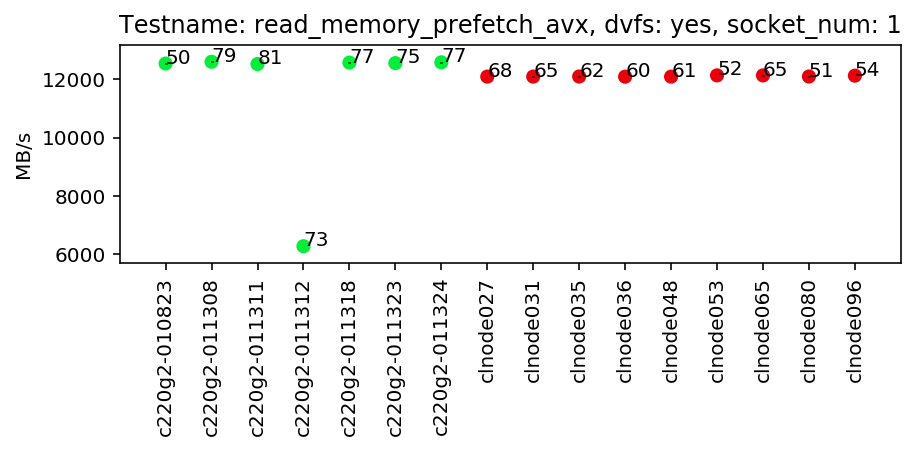

/notebooks/output/mem-aggr1-read_memory_prefetch_avx-yes-1.pdf

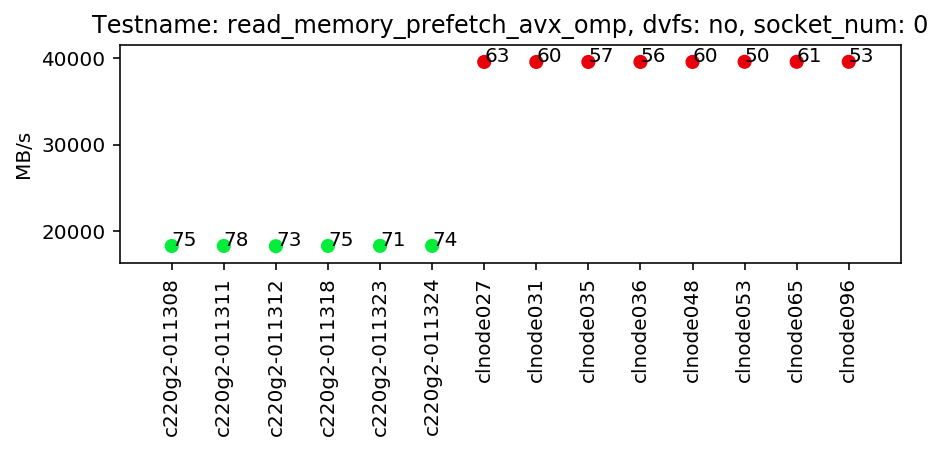

/notebooks/output/mem-aggr1-read_memory_prefetch_avx_omp-no-0.pdf

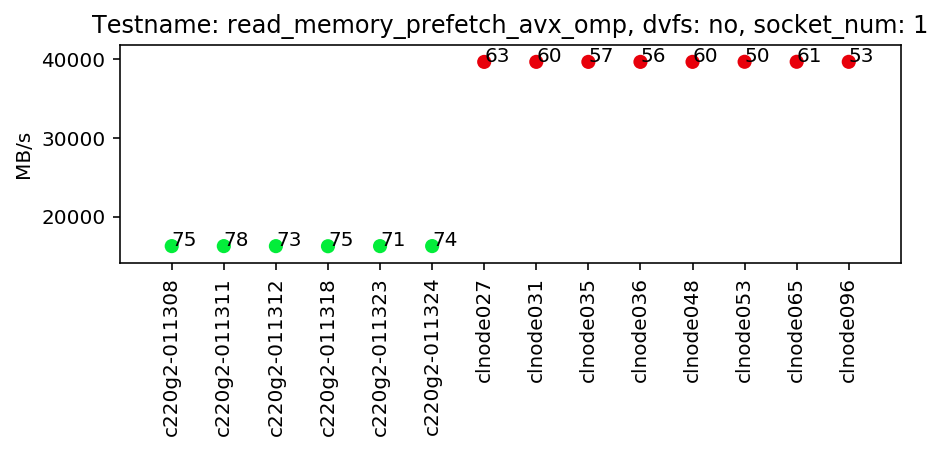

/notebooks/output/mem-aggr1-read_memory_prefetch_avx_omp-no-1.pdf

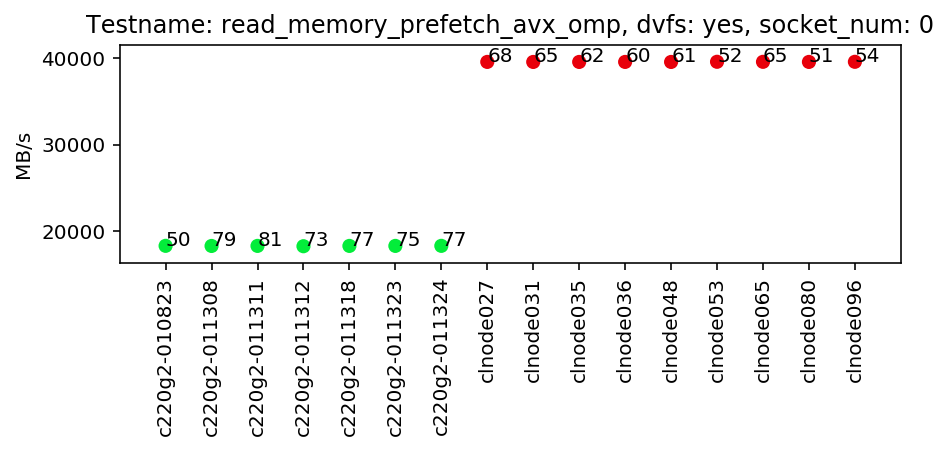

/notebooks/output/mem-aggr1-read_memory_prefetch_avx_omp-yes-0.pdf

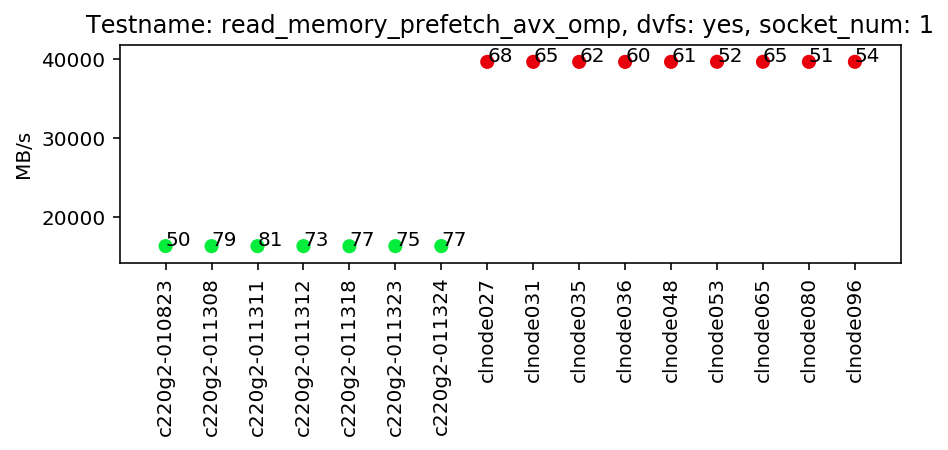

/notebooks/output/mem-aggr1-read_memory_prefetch_avx_omp-yes-1.pdf

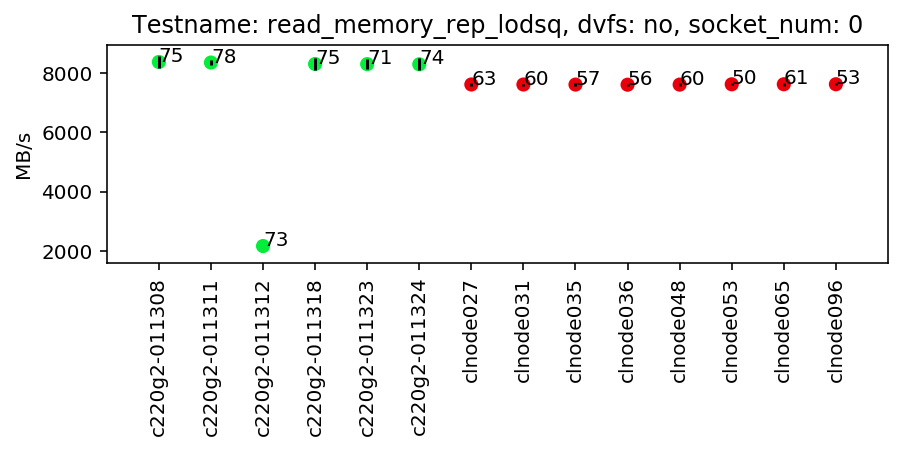

/notebooks/output/mem-aggr1-read_memory_rep_lodsq-no-0.pdf

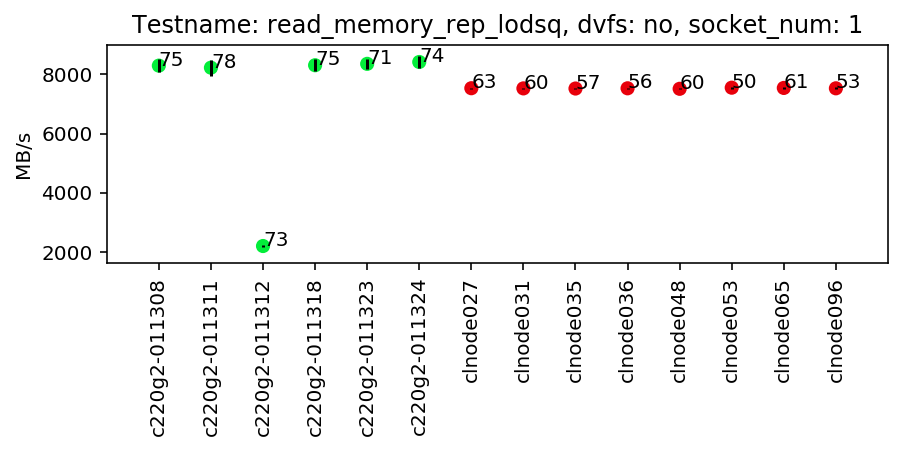

/notebooks/output/mem-aggr1-read_memory_rep_lodsq-no-1.pdf

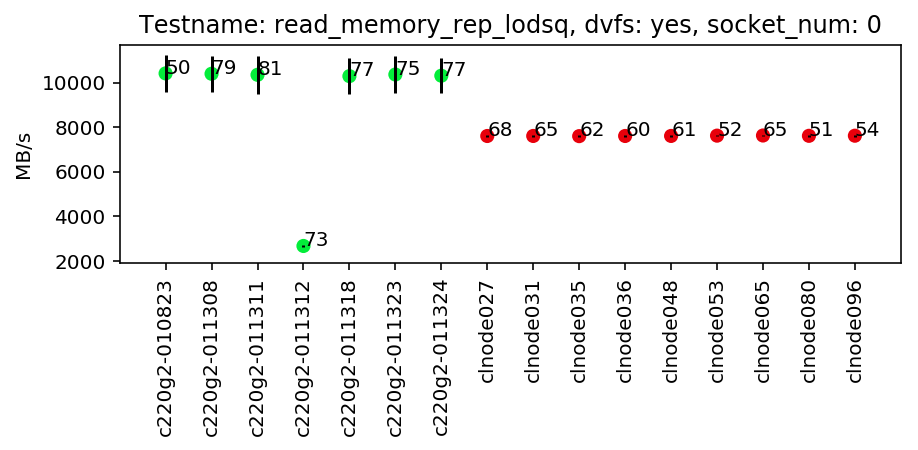

/notebooks/output/mem-aggr1-read_memory_rep_lodsq-yes-0.pdf

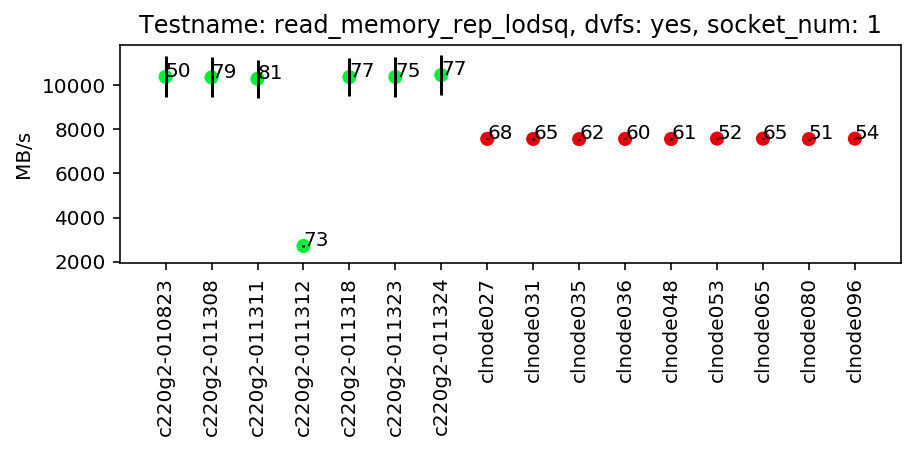

/notebooks/output/mem-aggr1-read_memory_rep_lodsq-yes-1.pdf

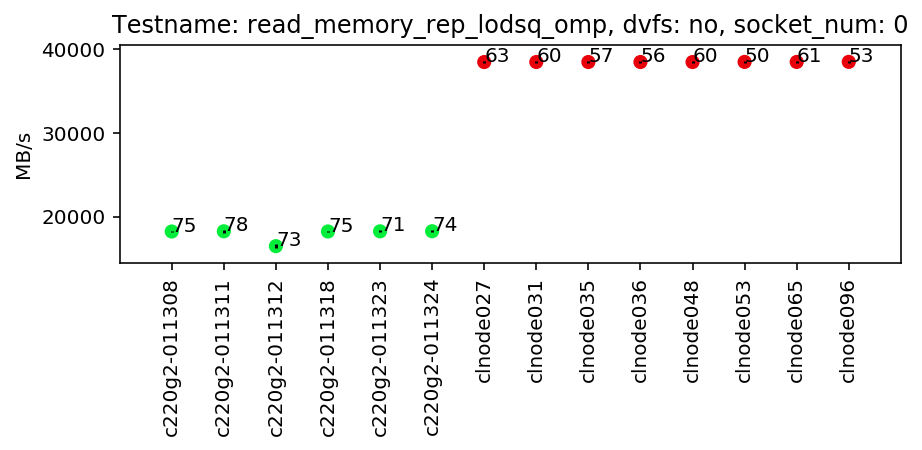

/notebooks/output/mem-aggr1-read_memory_rep_lodsq_omp-no-0.pdf

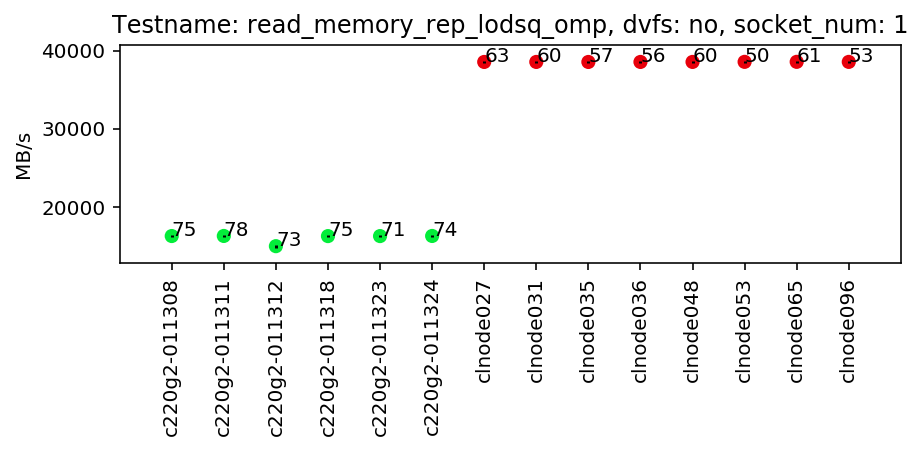

/notebooks/output/mem-aggr1-read_memory_rep_lodsq_omp-no-1.pdf

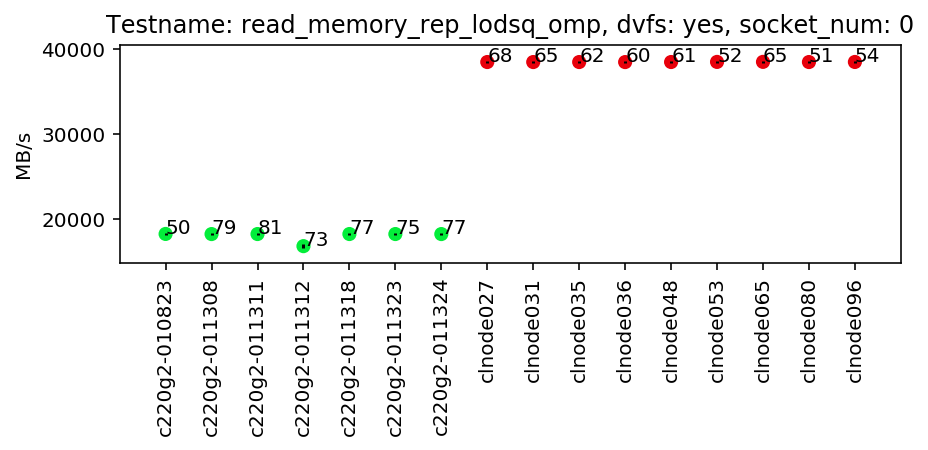

/notebooks/output/mem-aggr1-read_memory_rep_lodsq_omp-yes-0.pdf

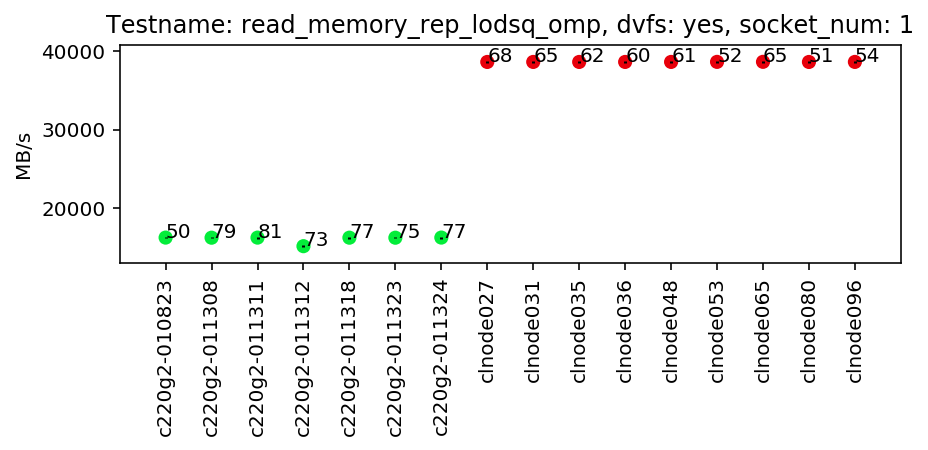

/notebooks/output/mem-aggr1-read_memory_rep_lodsq_omp-yes-1.pdf

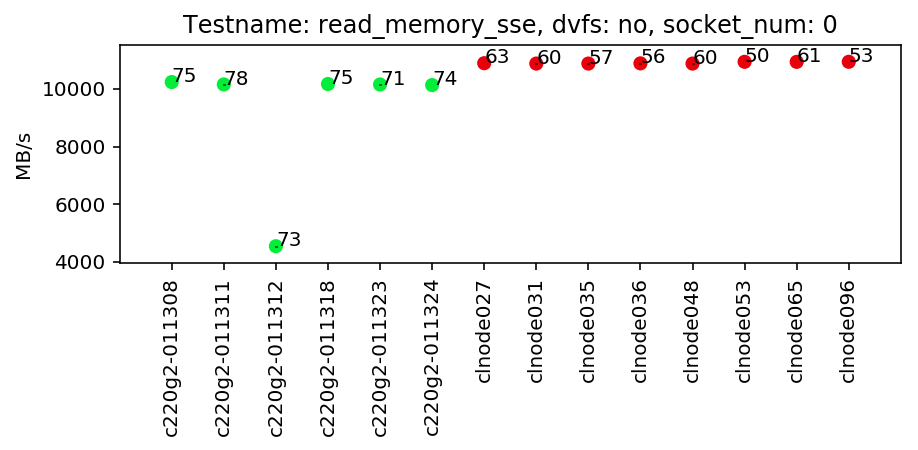

/notebooks/output/mem-aggr1-read_memory_sse-no-0.pdf

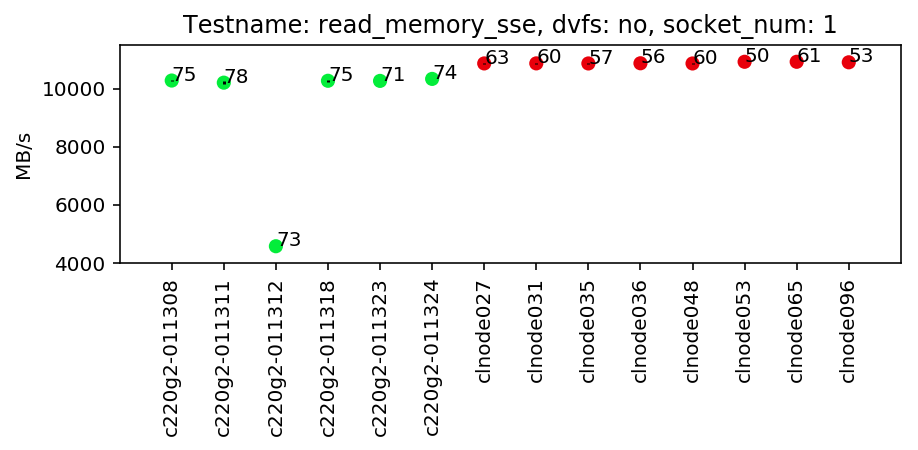

/notebooks/output/mem-aggr1-read_memory_sse-no-1.pdf

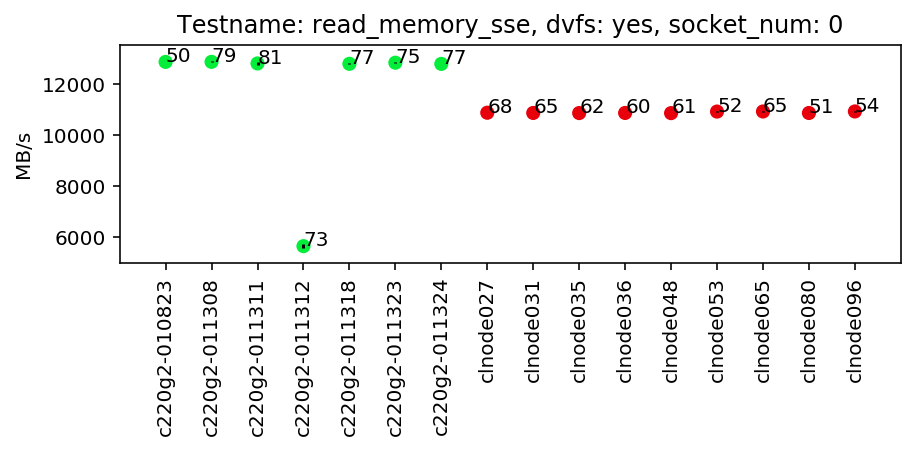

/notebooks/output/mem-aggr1-read_memory_sse-yes-0.pdf

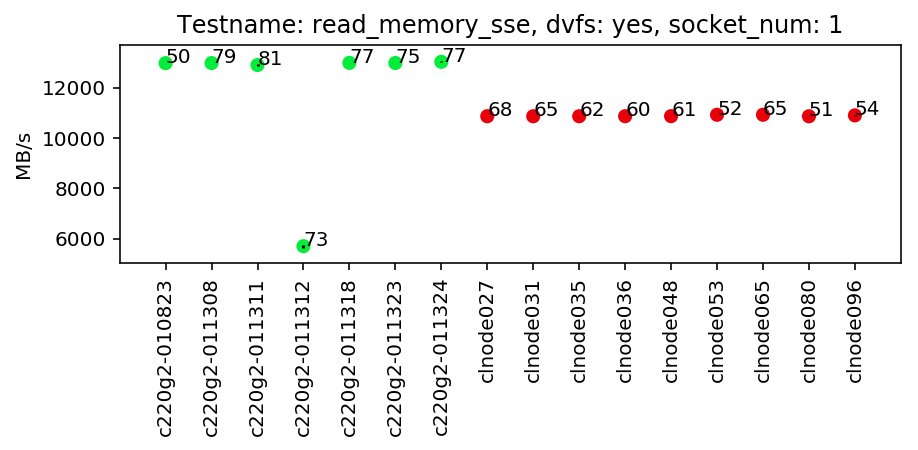

/notebooks/output/mem-aggr1-read_memory_sse-yes-1.pdf

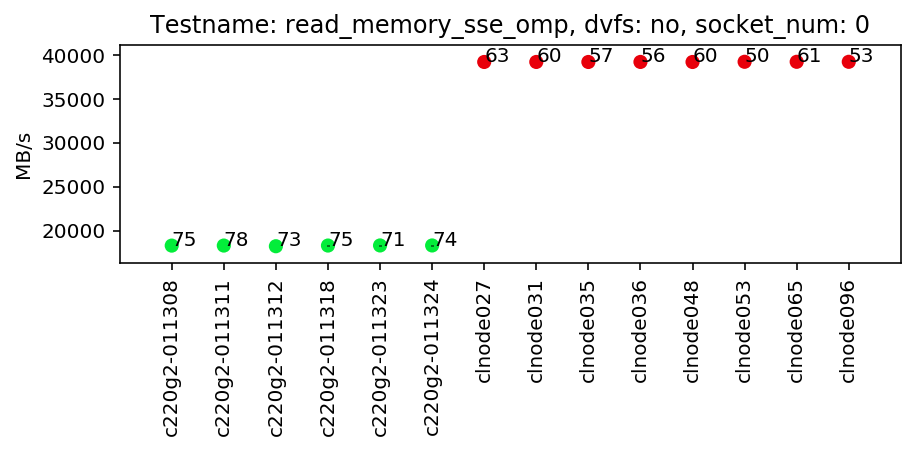

/notebooks/output/mem-aggr1-read_memory_sse_omp-no-0.pdf

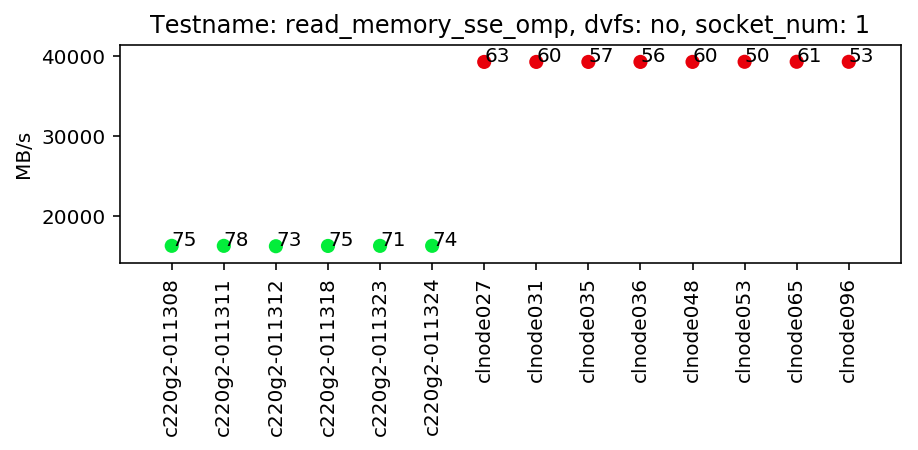

/notebooks/output/mem-aggr1-read_memory_sse_omp-no-1.pdf

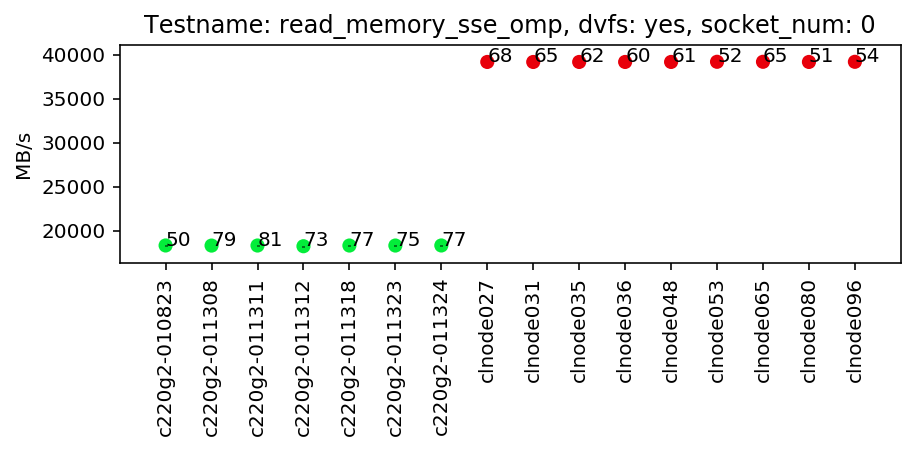

/notebooks/output/mem-aggr1-read_memory_sse_omp-yes-0.pdf

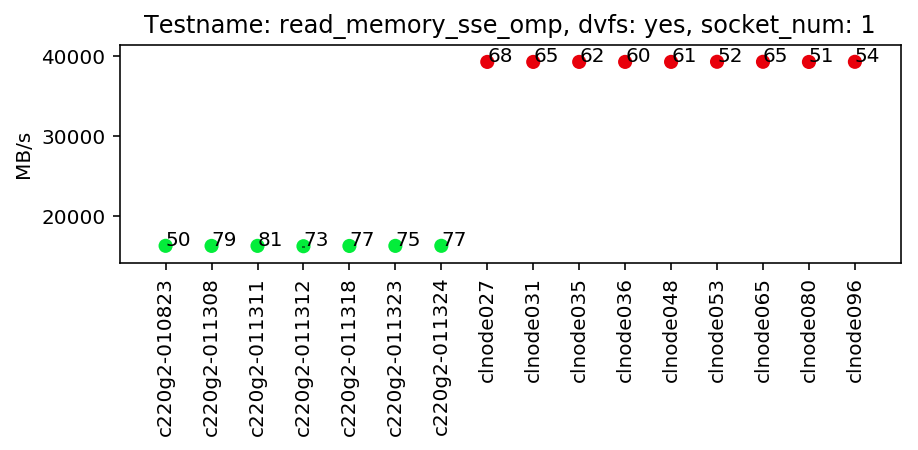

/notebooks/output/mem-aggr1-read_memory_sse_omp-yes-1.pdf

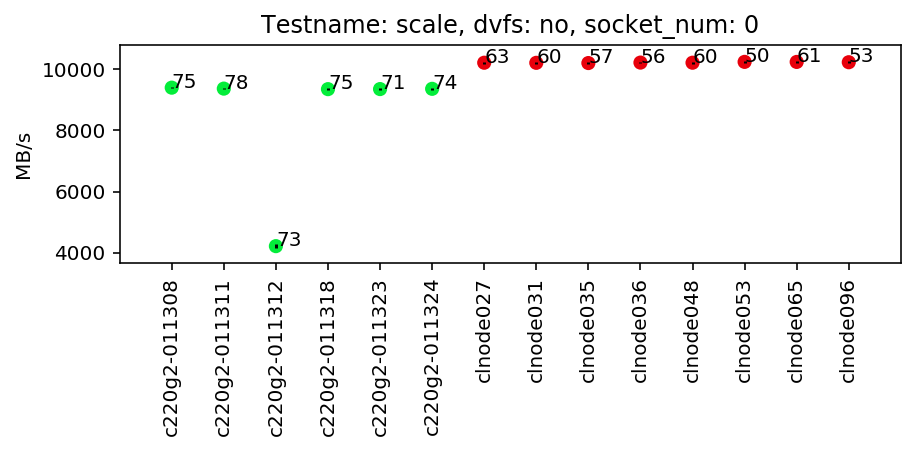

/notebooks/output/mem-aggr1-scale-no-0.pdf

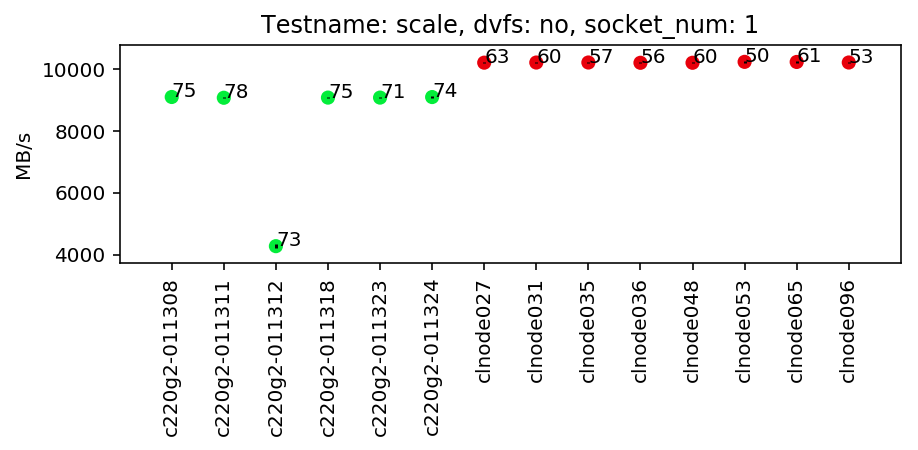

/notebooks/output/mem-aggr1-scale-no-1.pdf

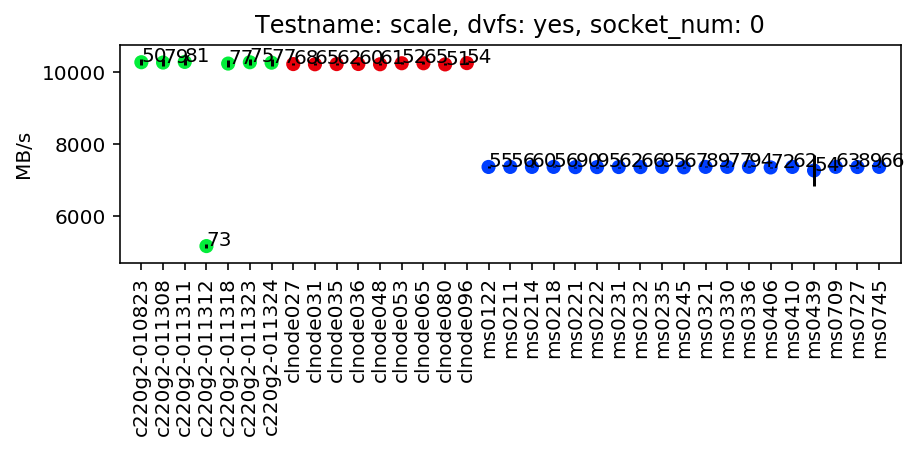

/notebooks/output/mem-aggr1-scale-yes-0.pdf

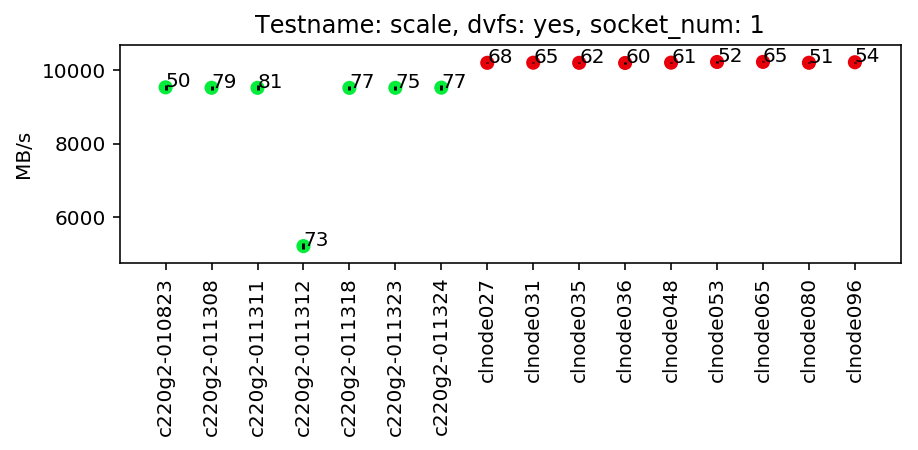

/notebooks/output/mem-aggr1-scale-yes-1.pdf

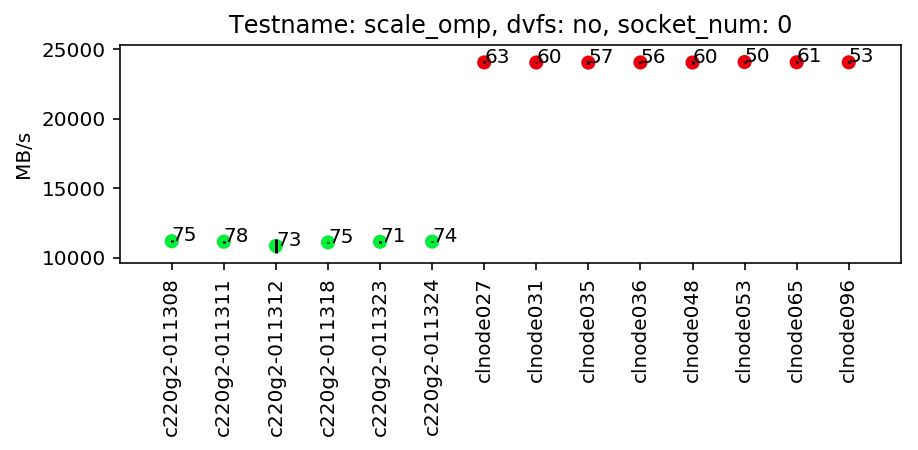

/notebooks/output/mem-aggr1-scale_omp-no-0.pdf

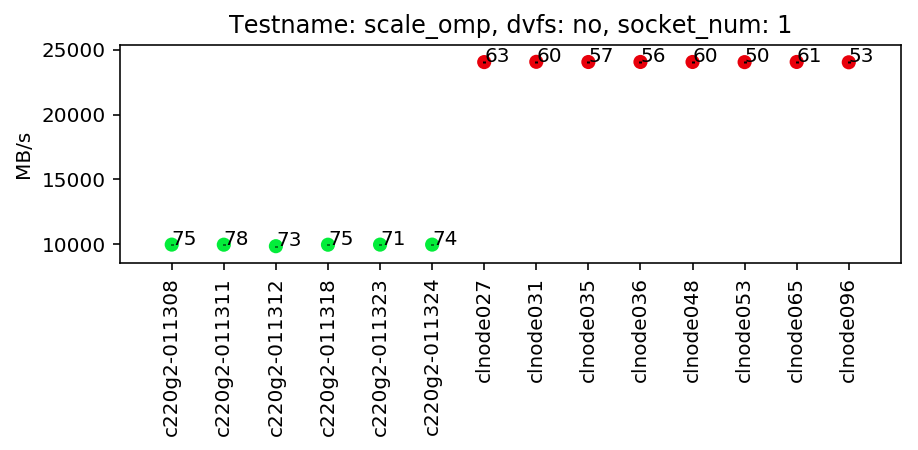

/notebooks/output/mem-aggr1-scale_omp-no-1.pdf

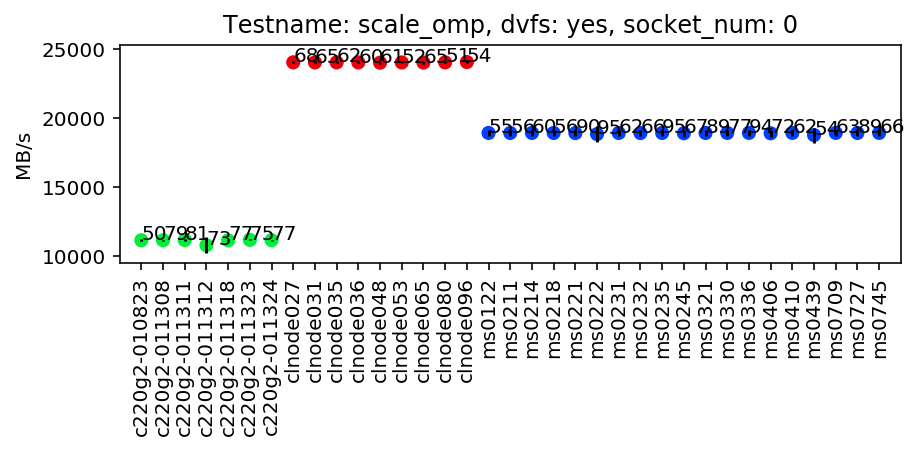

/notebooks/output/mem-aggr1-scale_omp-yes-0.pdf

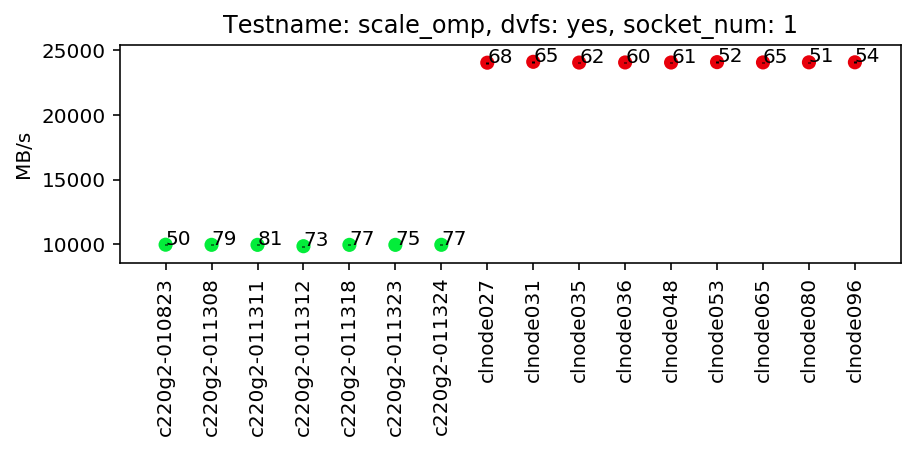

/notebooks/output/mem-aggr1-scale_omp-yes-1.pdf

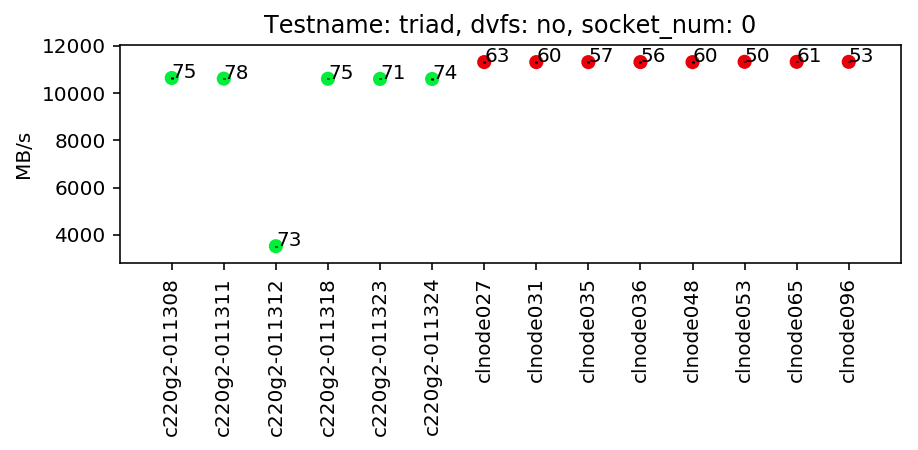

/notebooks/output/mem-aggr1-triad-no-0.pdf

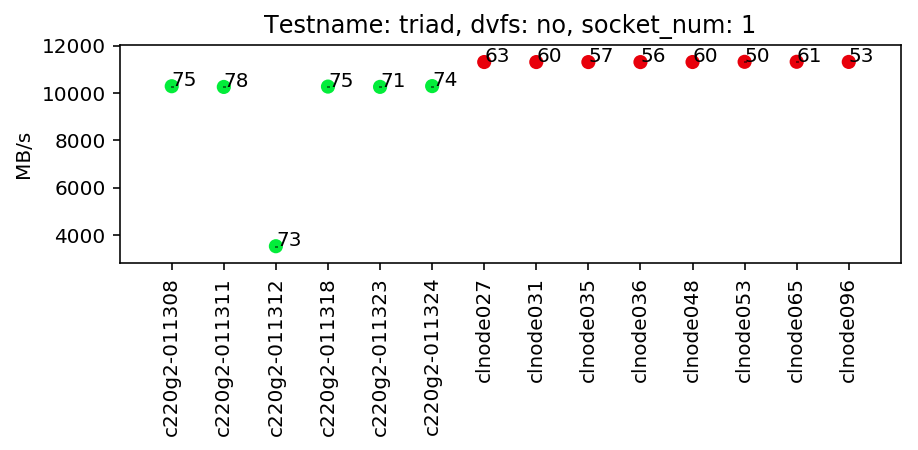

/notebooks/output/mem-aggr1-triad-no-1.pdf

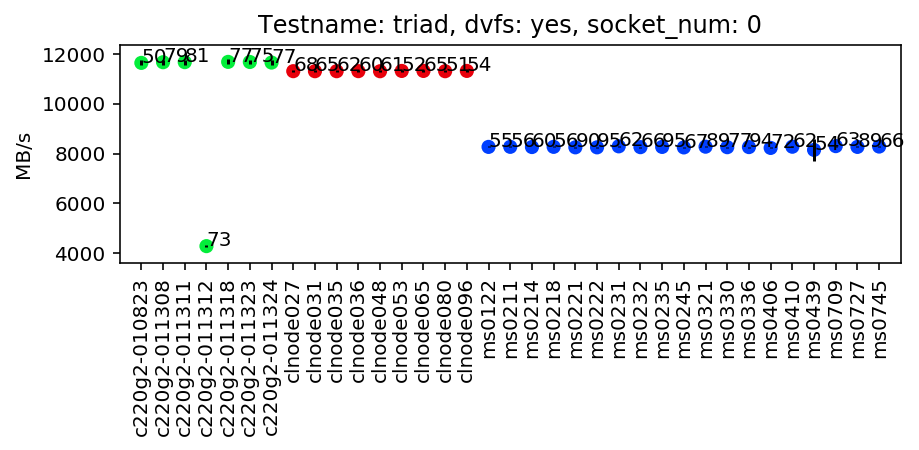

/notebooks/output/mem-aggr1-triad-yes-0.pdf

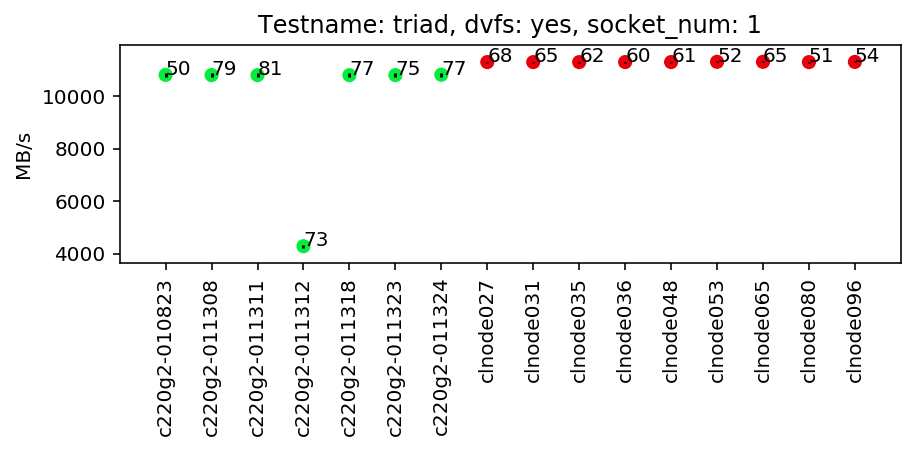

/notebooks/output/mem-aggr1-triad-yes-1.pdf

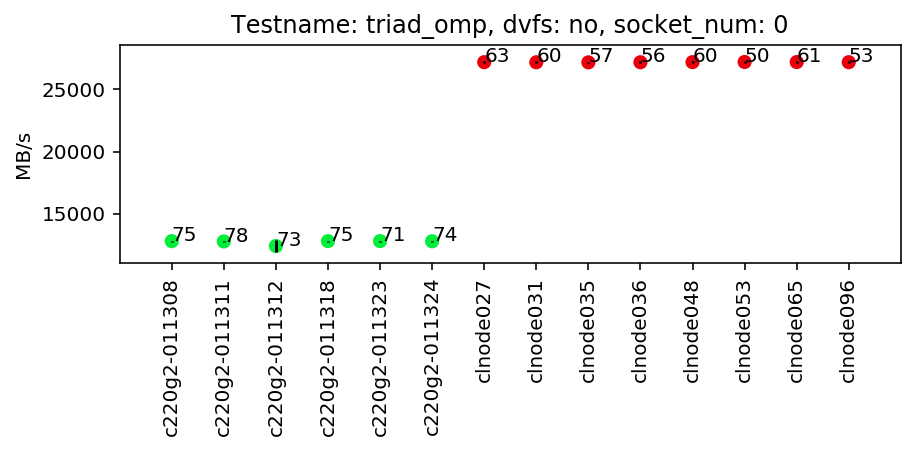

/notebooks/output/mem-aggr1-triad_omp-no-0.pdf

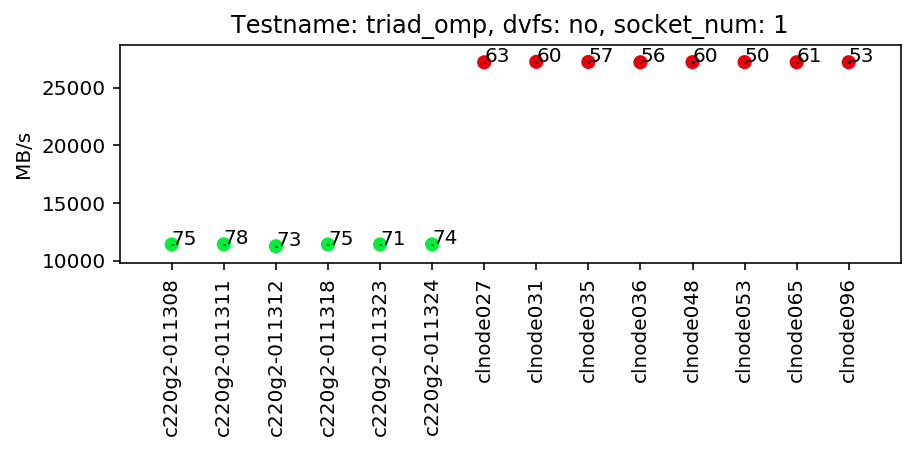

/notebooks/output/mem-aggr1-triad_omp-no-1.pdf

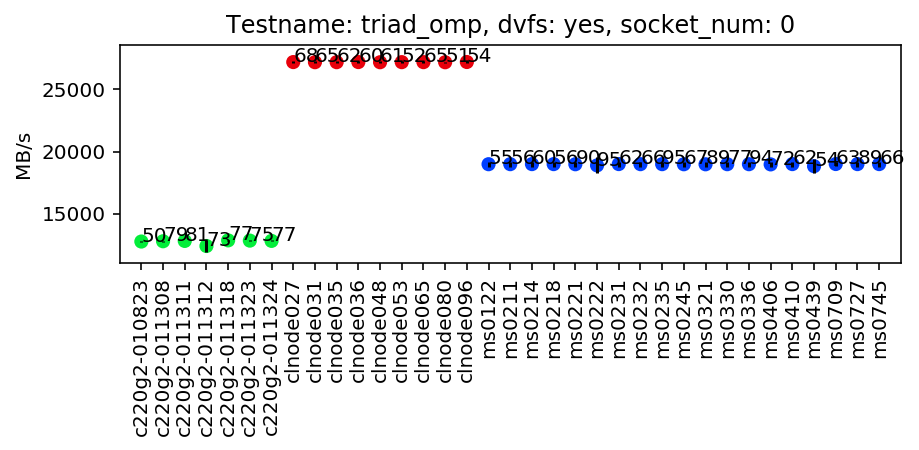

/notebooks/output/mem-aggr1-triad_omp-yes-0.pdf

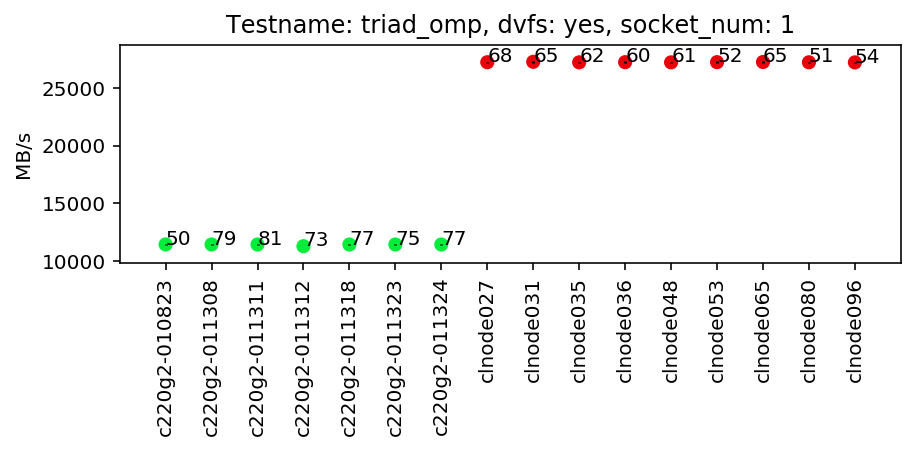

/notebooks/output/mem-aggr1-triad_omp-yes-1.pdf

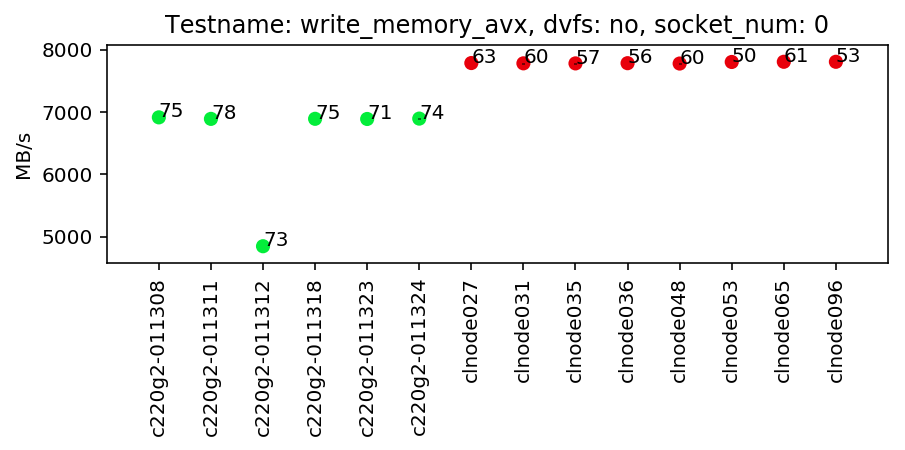

/notebooks/output/mem-aggr1-write_memory_avx-no-0.pdf

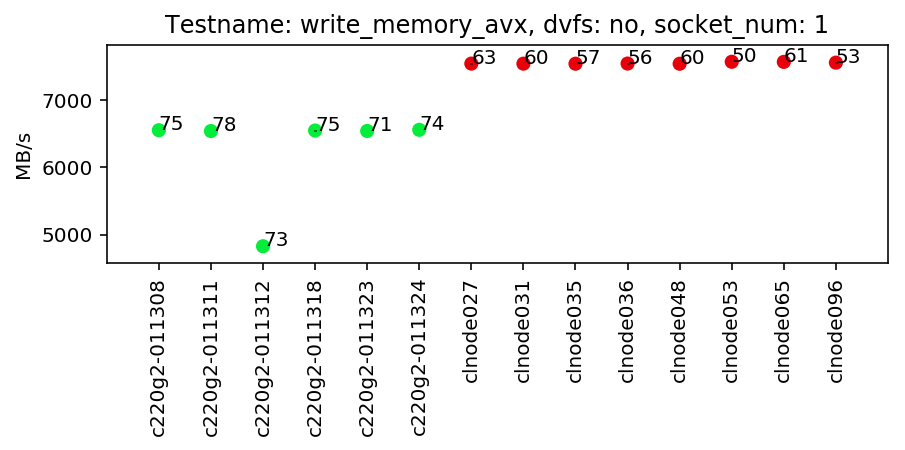

/notebooks/output/mem-aggr1-write_memory_avx-no-1.pdf

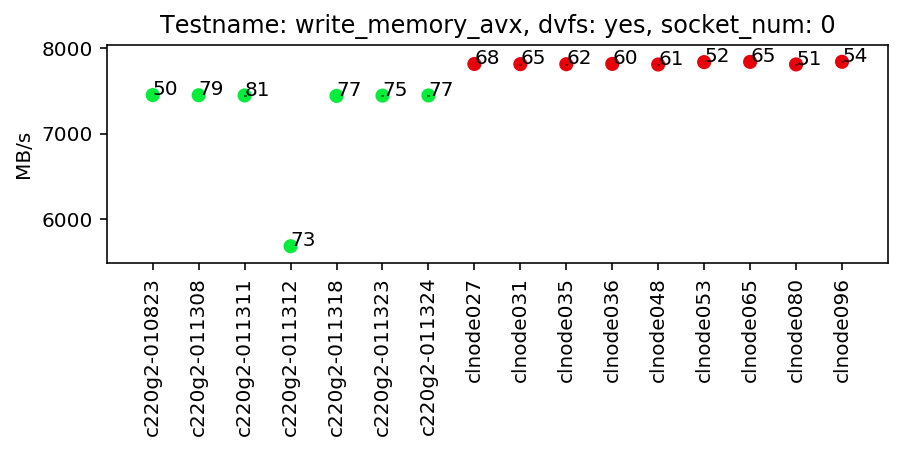

/notebooks/output/mem-aggr1-write_memory_avx-yes-0.pdf

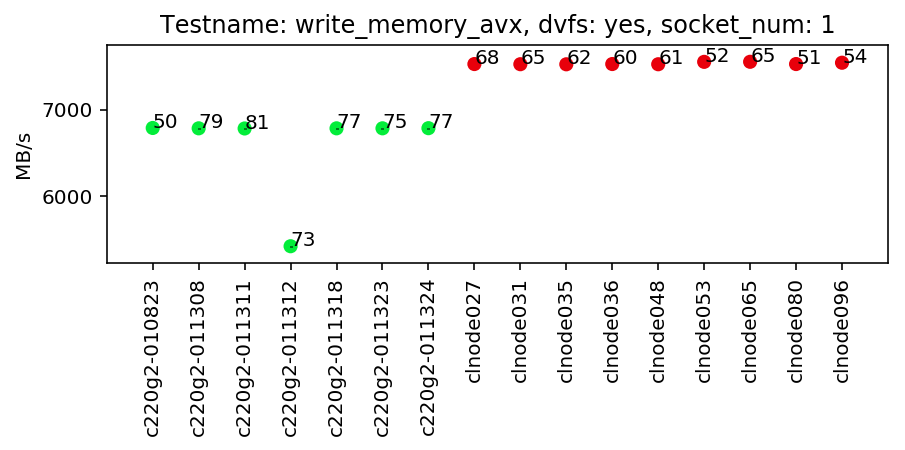

/notebooks/output/mem-aggr1-write_memory_avx-yes-1.pdf

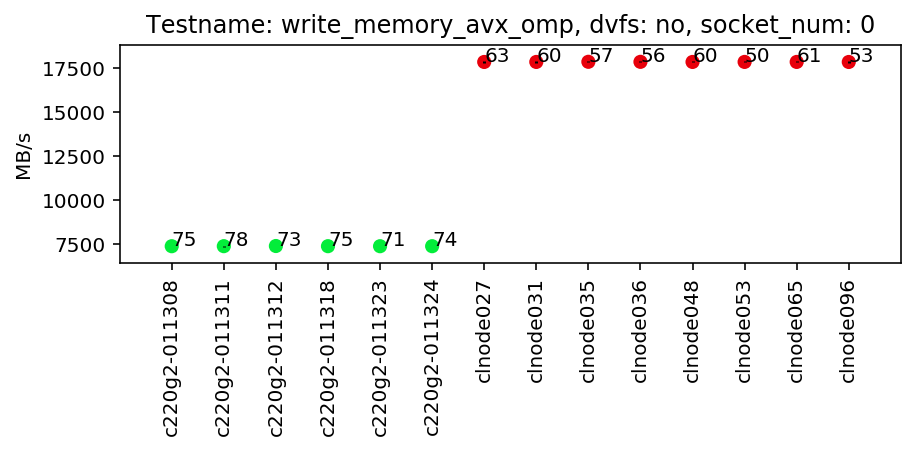

/notebooks/output/mem-aggr1-write_memory_avx_omp-no-0.pdf

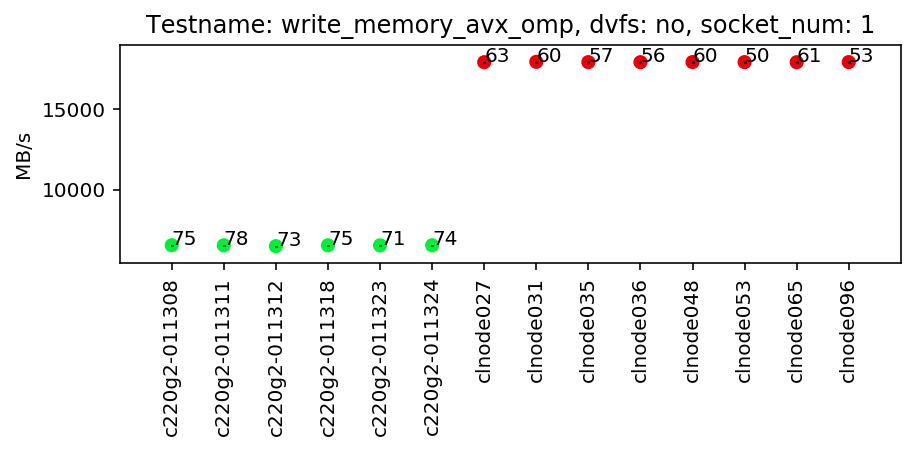

/notebooks/output/mem-aggr1-write_memory_avx_omp-no-1.pdf

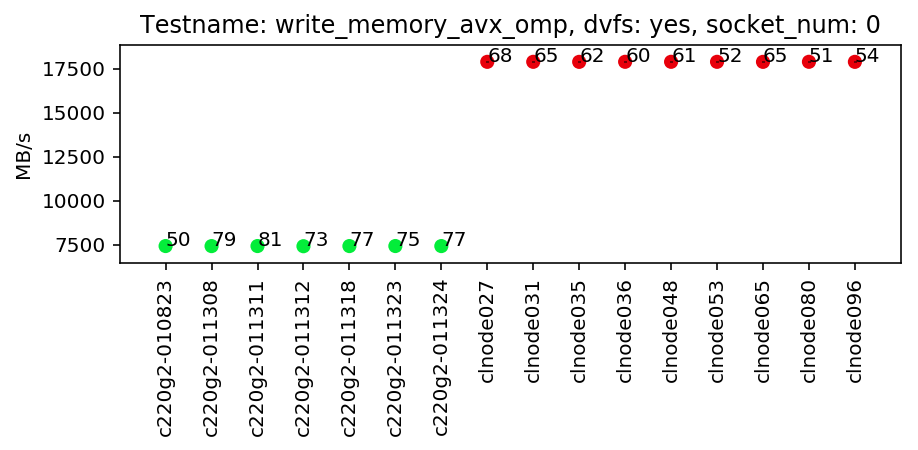

/notebooks/output/mem-aggr1-write_memory_avx_omp-yes-0.pdf

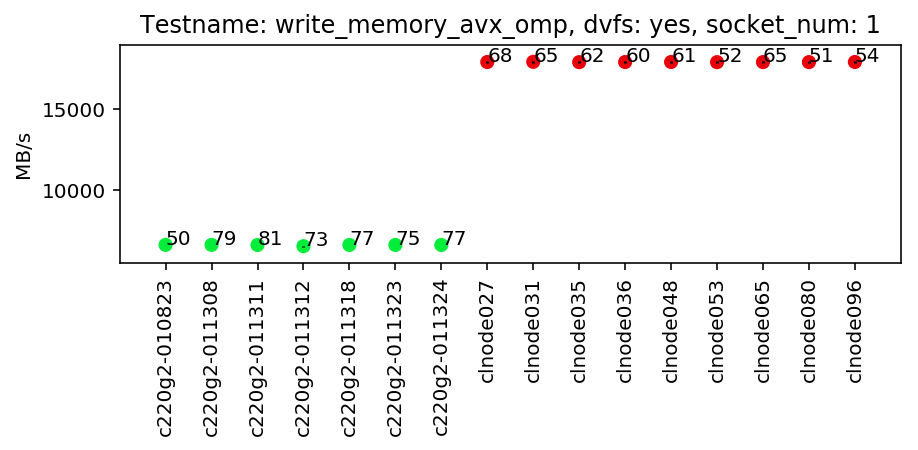

/notebooks/output/mem-aggr1-write_memory_avx_omp-yes-1.pdf

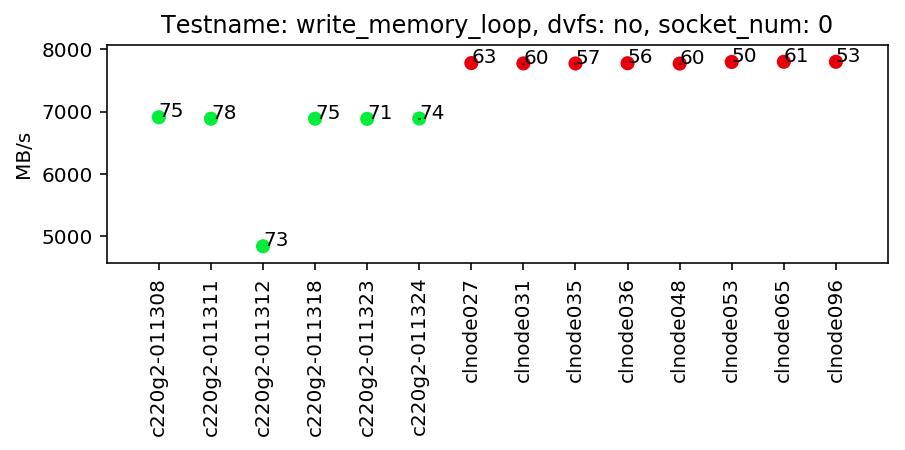

/notebooks/output/mem-aggr1-write_memory_loop-no-0.pdf

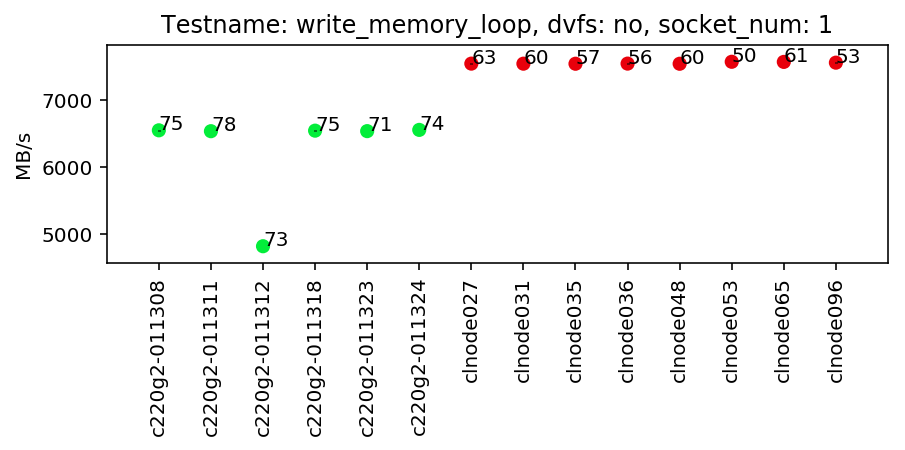

/notebooks/output/mem-aggr1-write_memory_loop-no-1.pdf

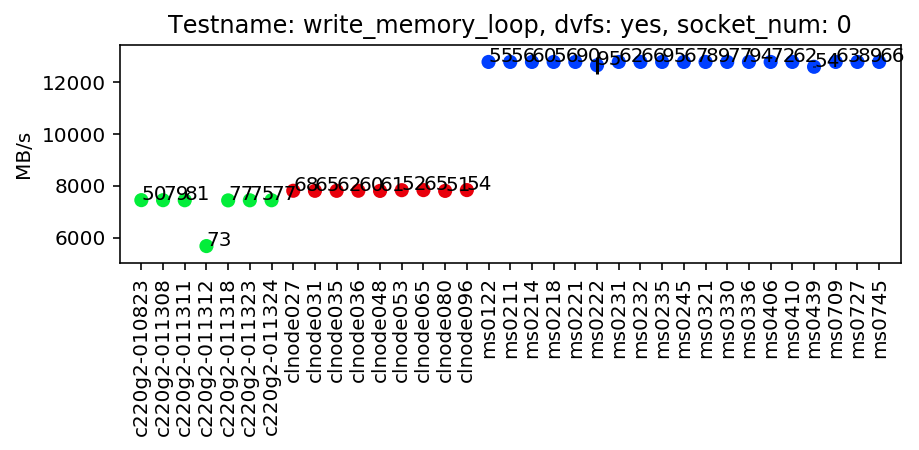

/notebooks/output/mem-aggr1-write_memory_loop-yes-0.pdf

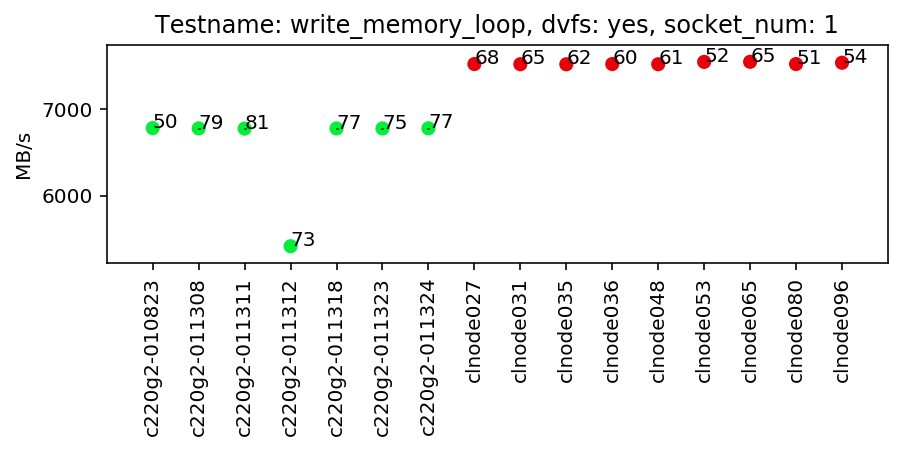

/notebooks/output/mem-aggr1-write_memory_loop-yes-1.pdf

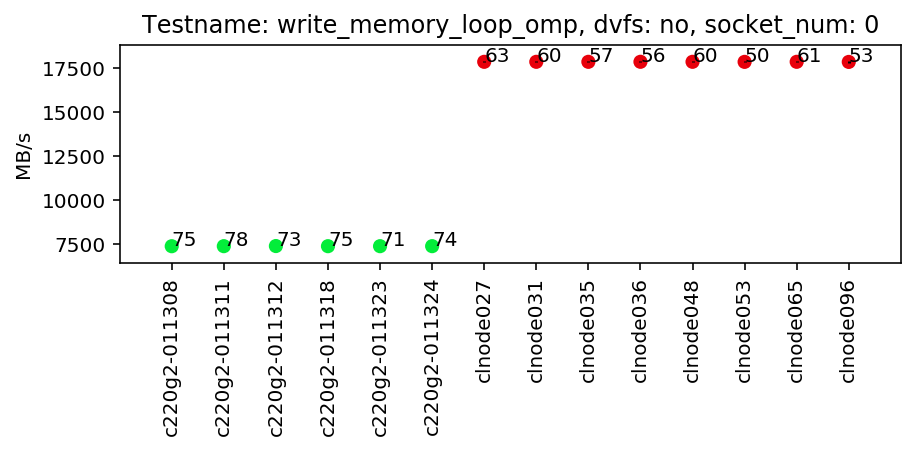

/notebooks/output/mem-aggr1-write_memory_loop_omp-no-0.pdf

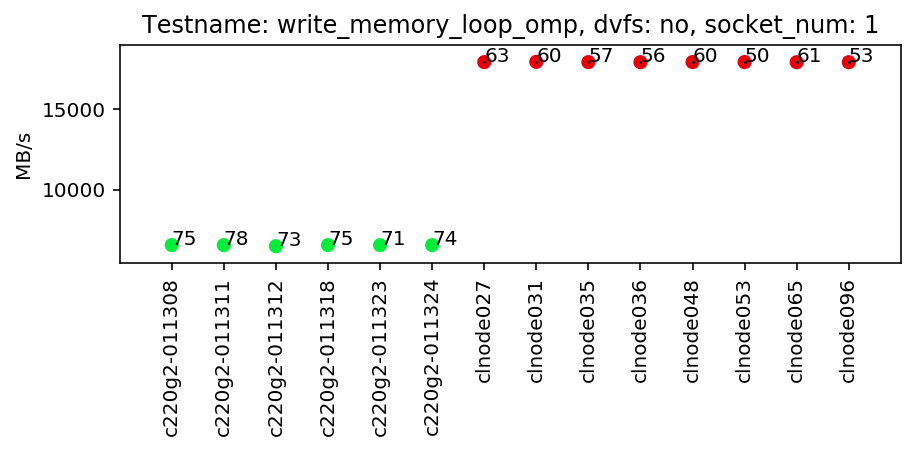

/notebooks/output/mem-aggr1-write_memory_loop_omp-no-1.pdf

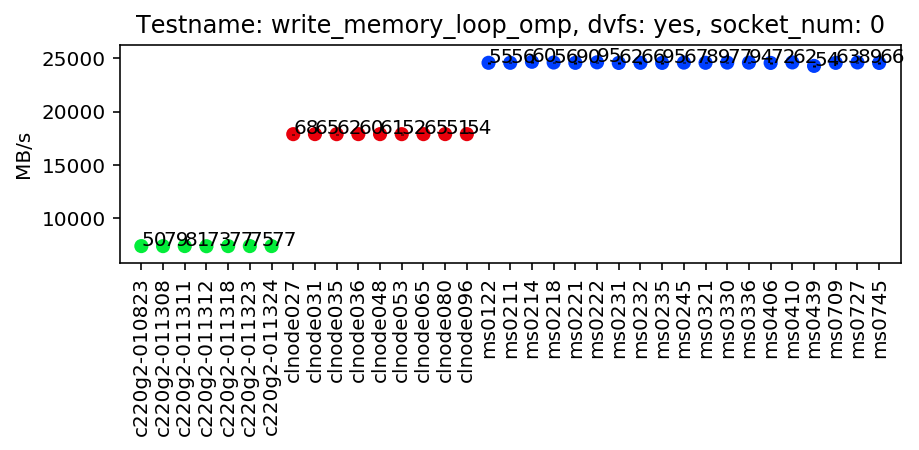

/notebooks/output/mem-aggr1-write_memory_loop_omp-yes-0.pdf

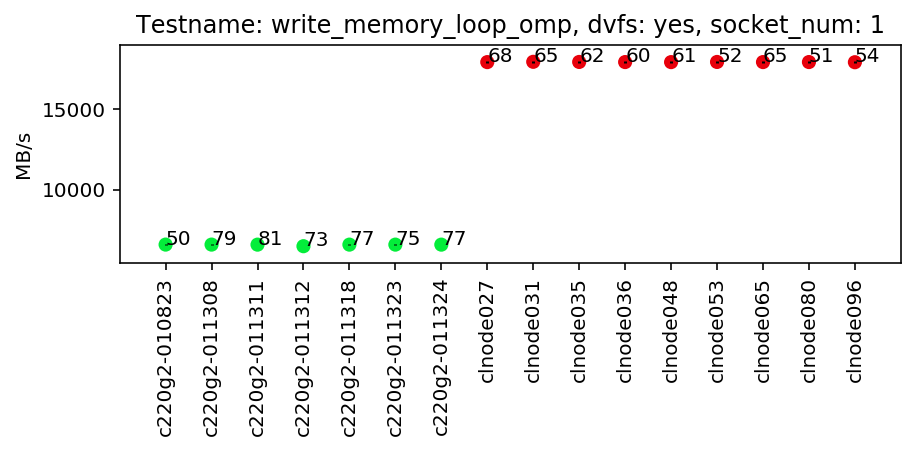

/notebooks/output/mem-aggr1-write_memory_loop_omp-yes-1.pdf

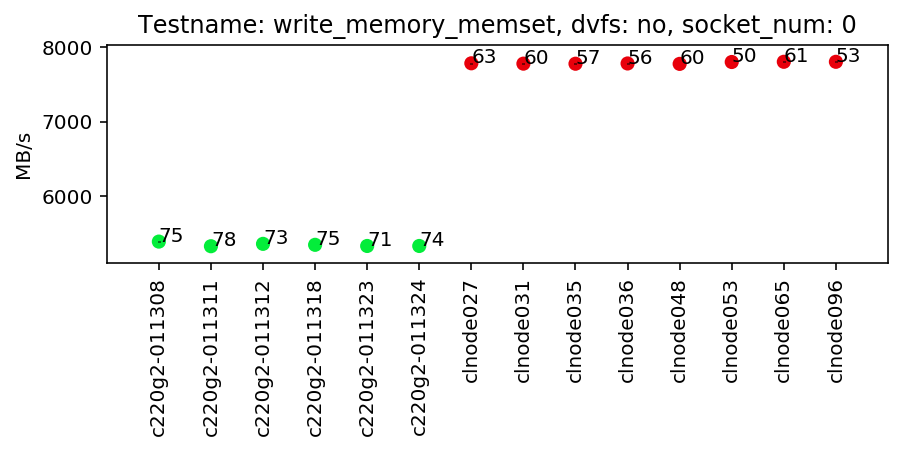

/notebooks/output/mem-aggr1-write_memory_memset-no-0.pdf

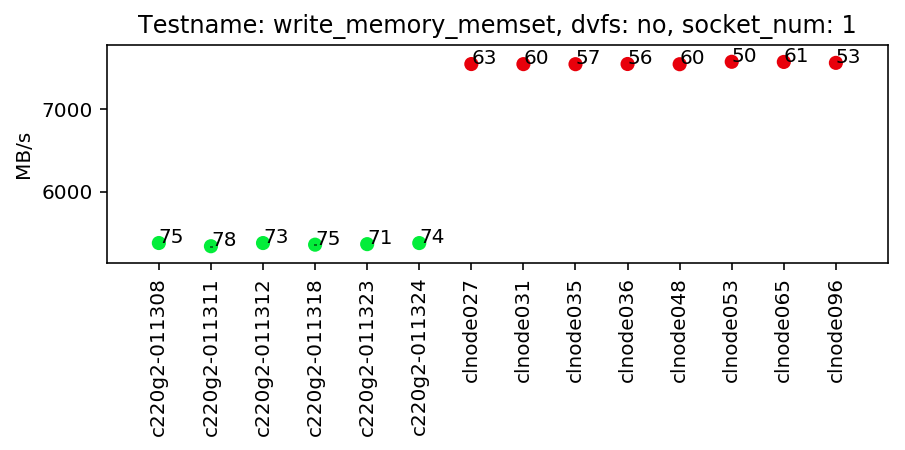

/notebooks/output/mem-aggr1-write_memory_memset-no-1.pdf

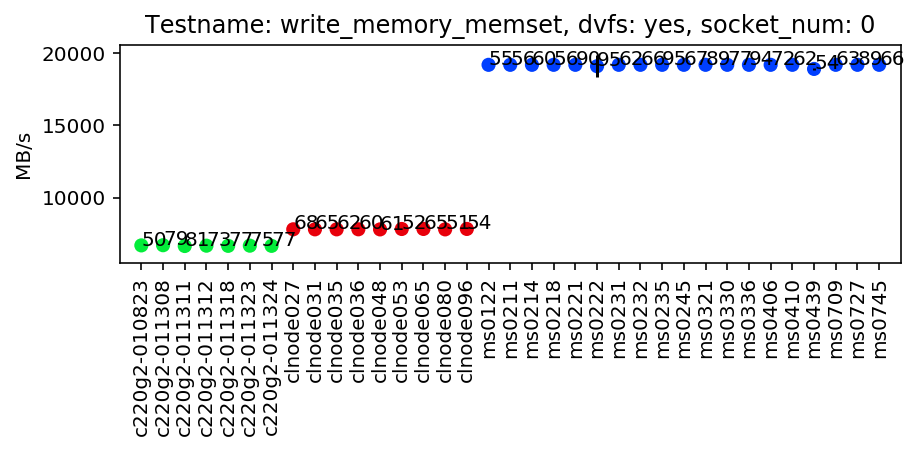

/notebooks/output/mem-aggr1-write_memory_memset-yes-0.pdf

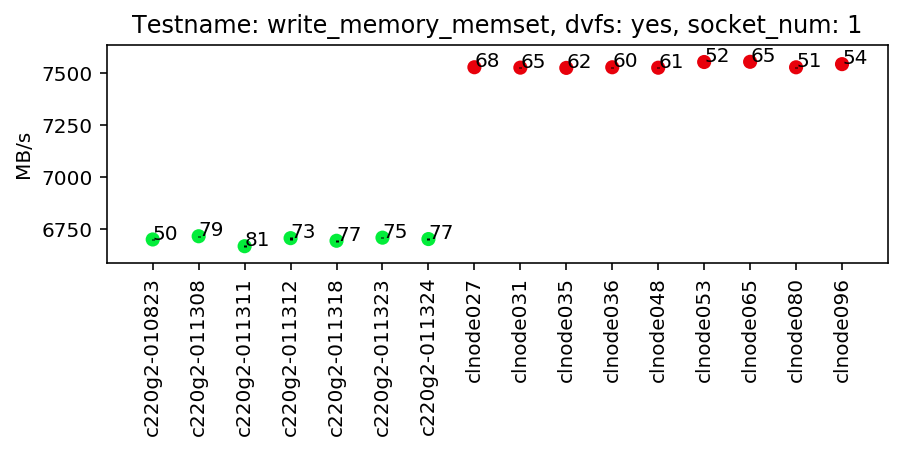

/notebooks/output/mem-aggr1-write_memory_memset-yes-1.pdf

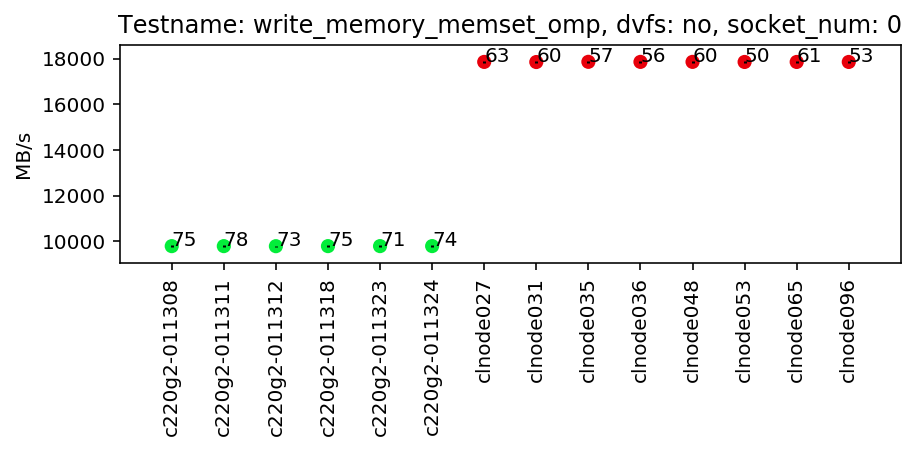

/notebooks/output/mem-aggr1-write_memory_memset_omp-no-0.pdf

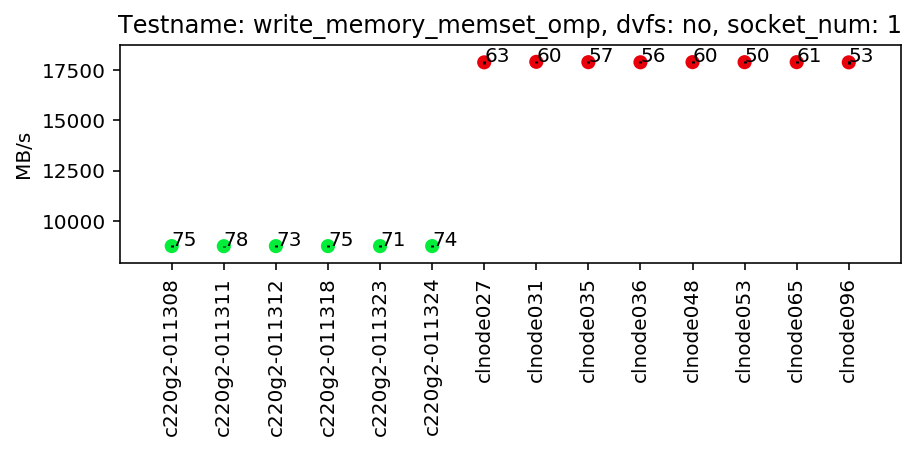

/notebooks/output/mem-aggr1-write_memory_memset_omp-no-1.pdf

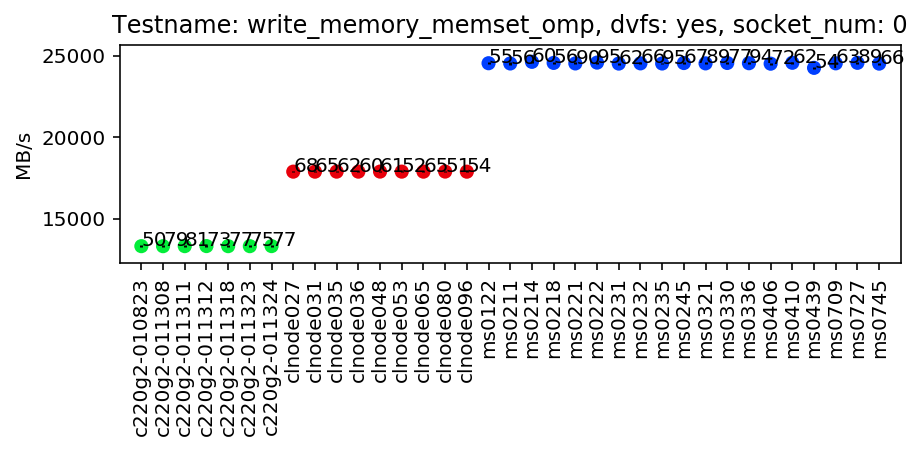

/notebooks/output/mem-aggr1-write_memory_memset_omp-yes-0.pdf

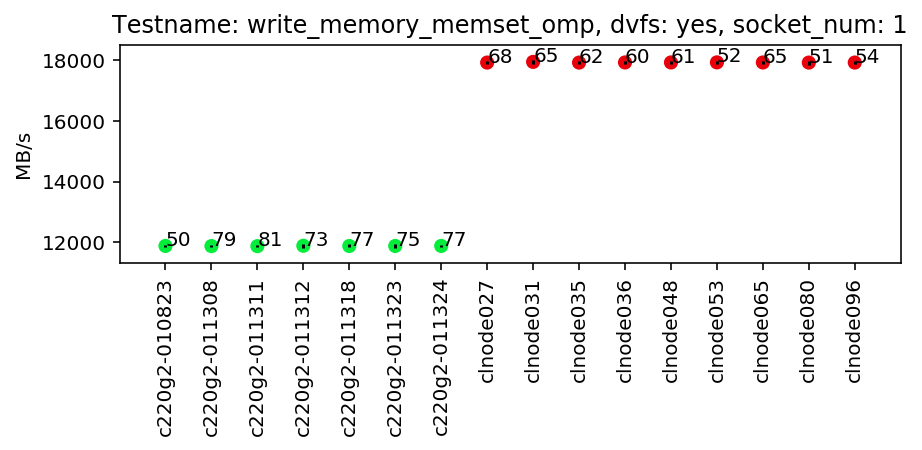

/notebooks/output/mem-aggr1-write_memory_memset_omp-yes-1.pdf

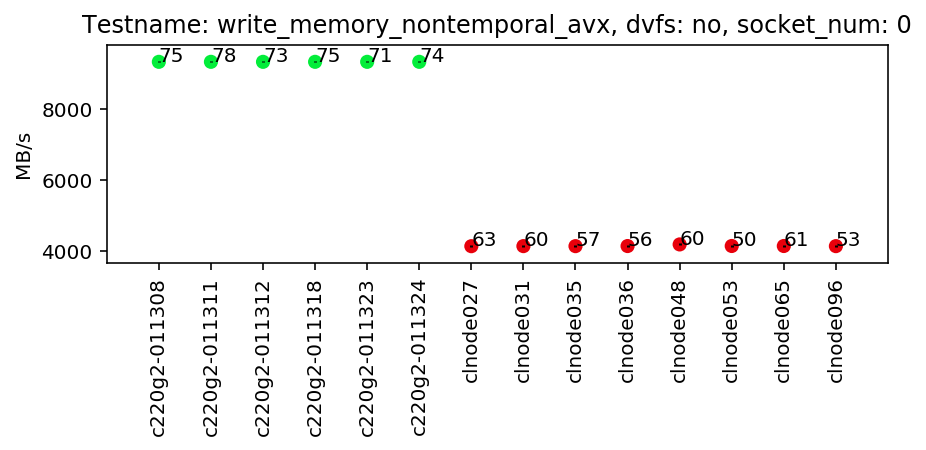

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx-no-0.pdf

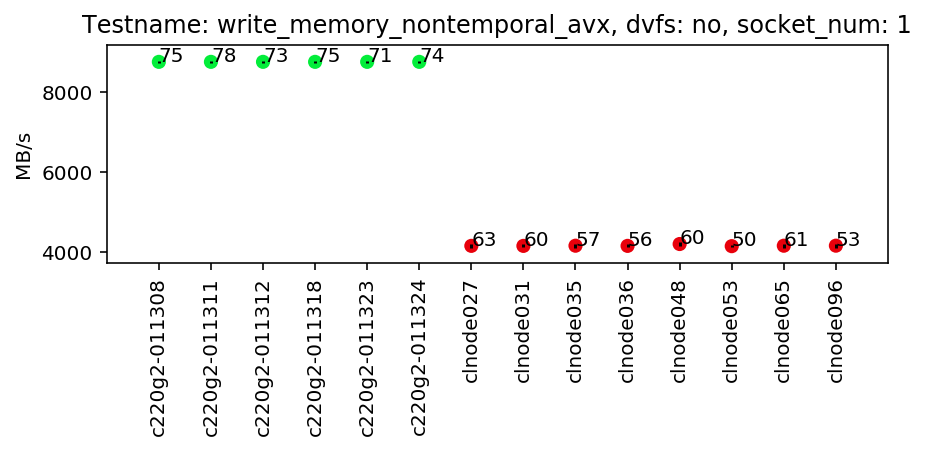

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx-no-1.pdf

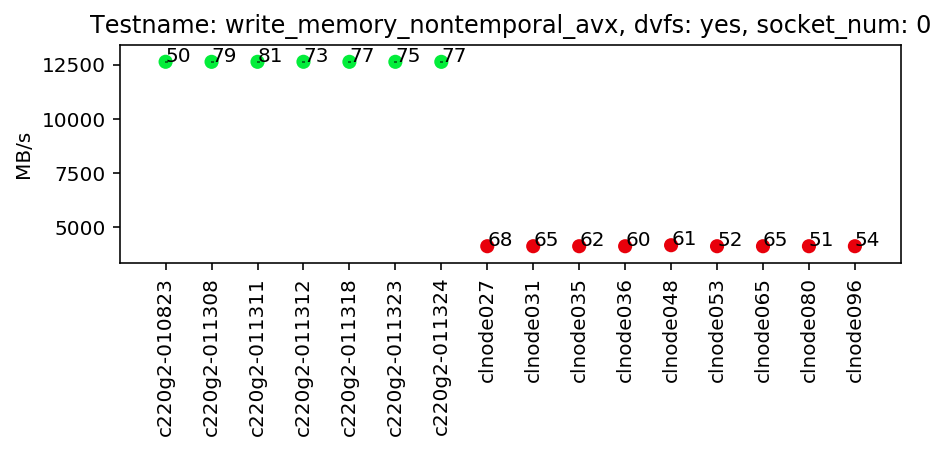

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx-yes-0.pdf

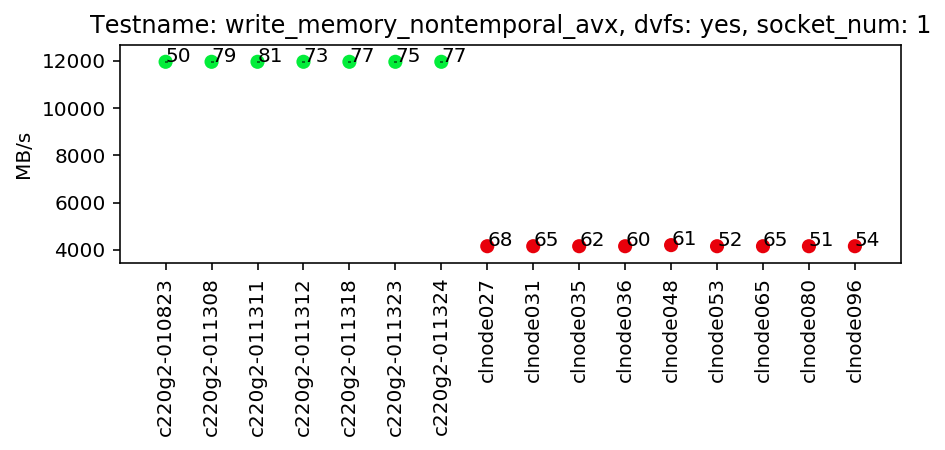

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx-yes-1.pdf

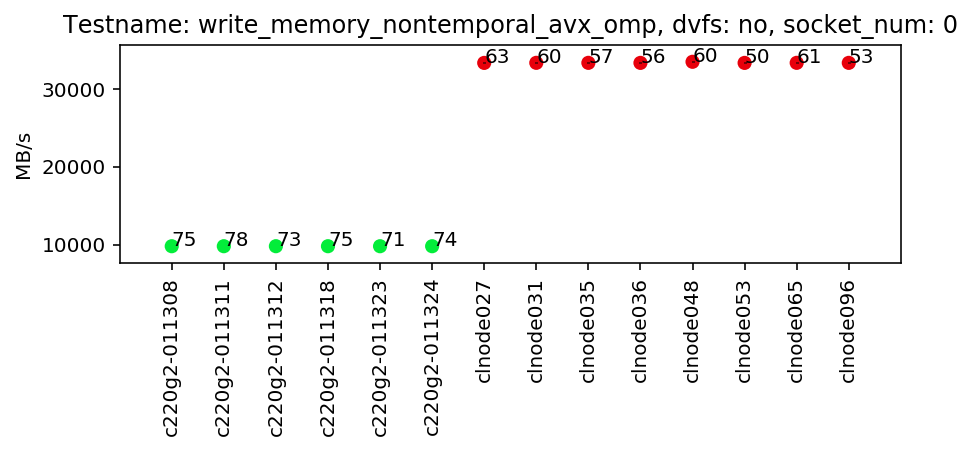

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx_omp-no-0.pdf

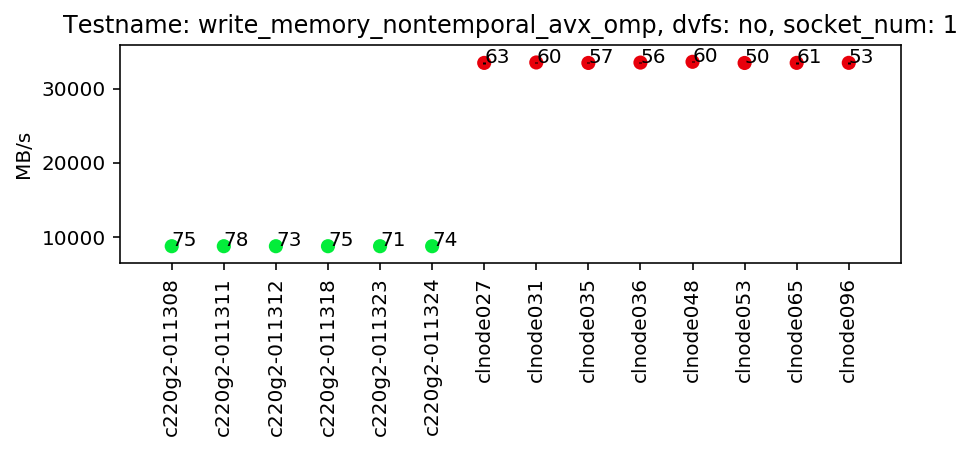

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx_omp-no-1.pdf

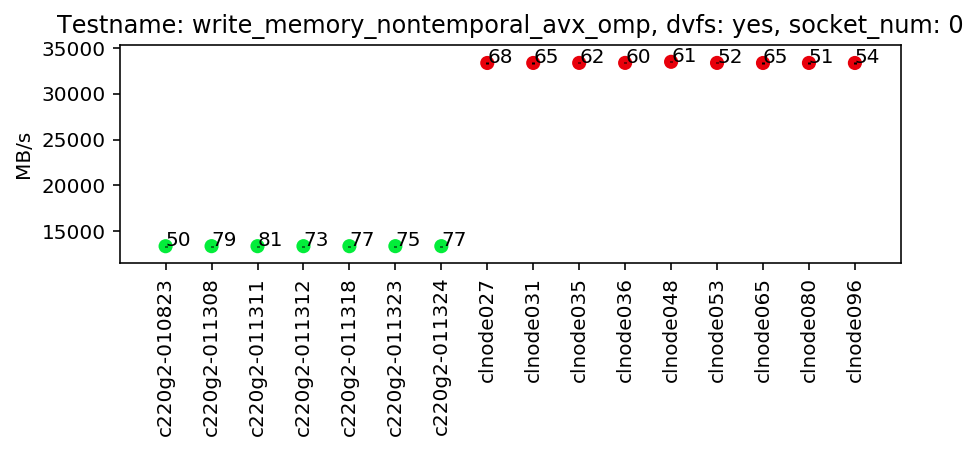

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx_omp-yes-0.pdf

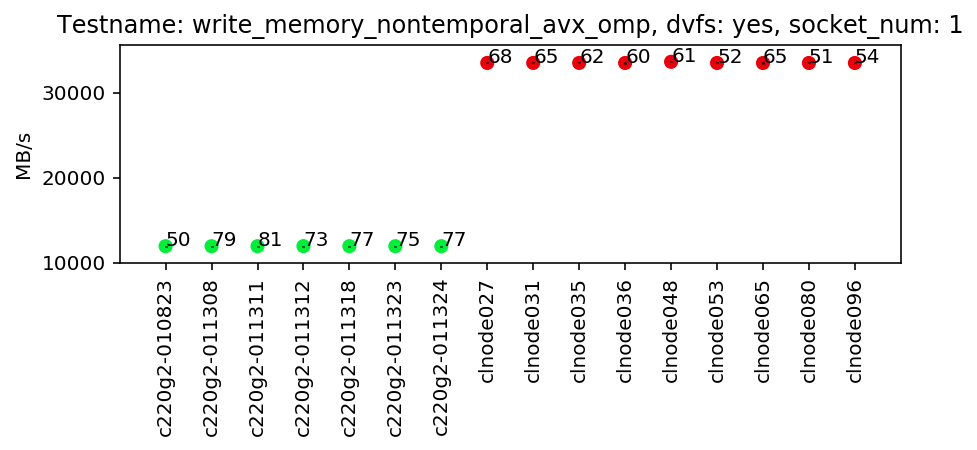

/notebooks/output/mem-aggr1-write_memory_nontemporal_avx_omp-yes-1.pdf

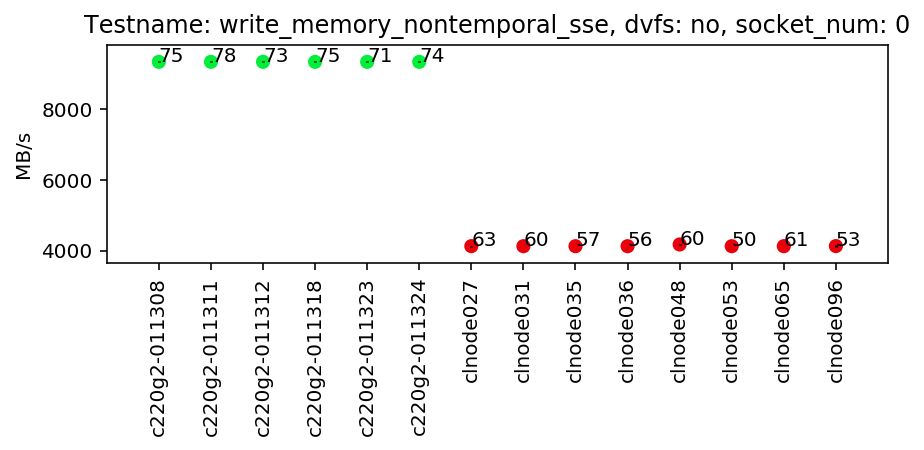

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse-no-0.pdf

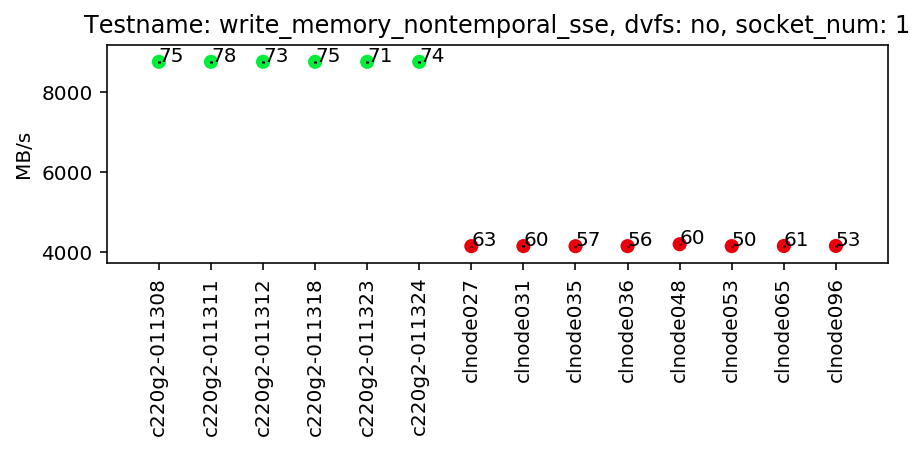

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse-no-1.pdf

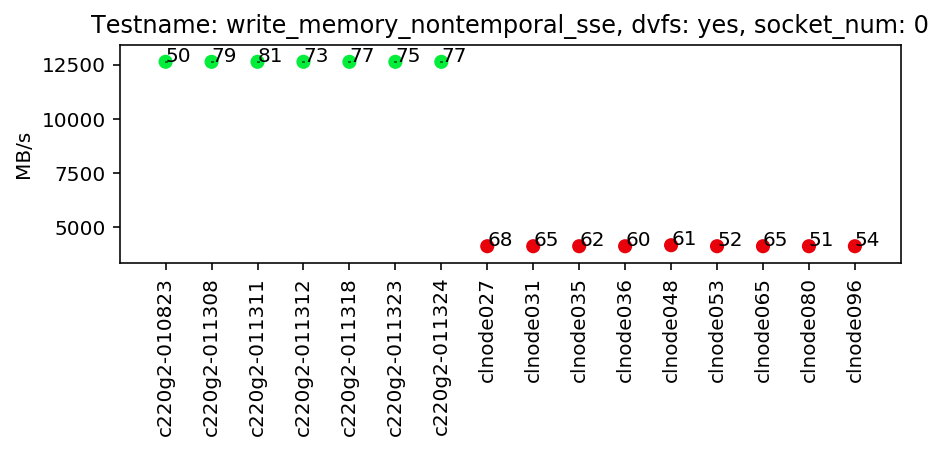

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse-yes-0.pdf

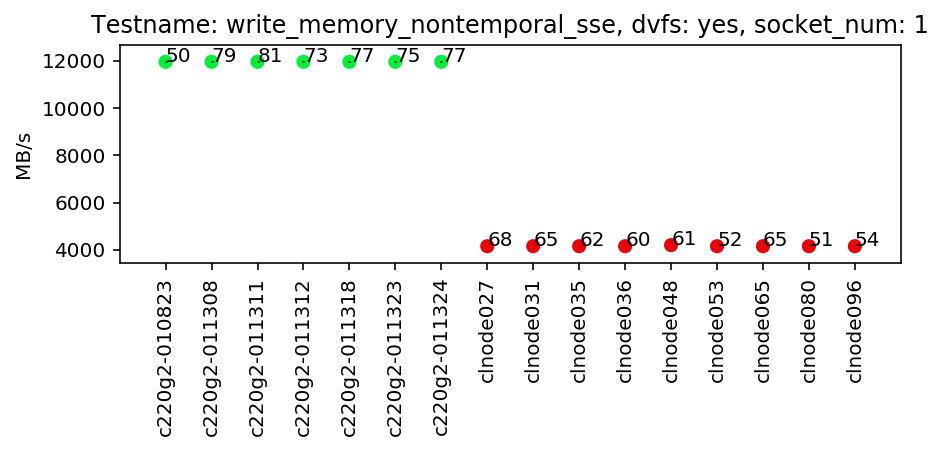

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse-yes-1.pdf

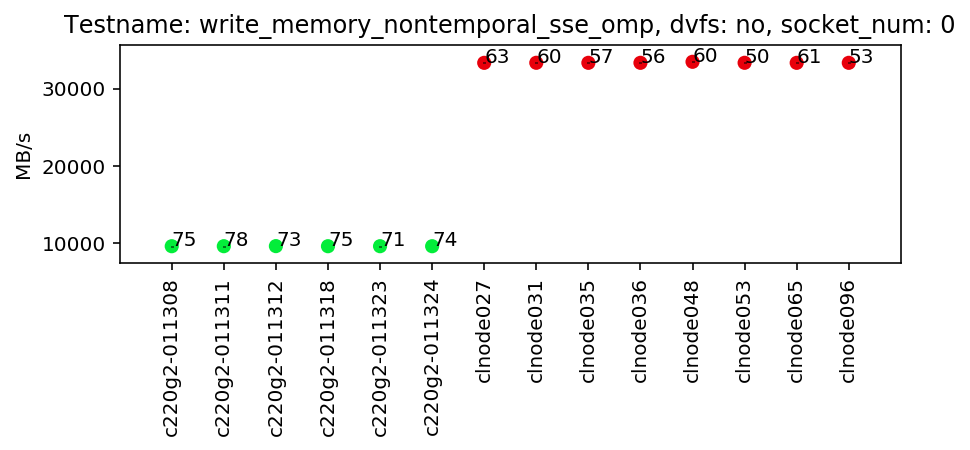

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse_omp-no-0.pdf

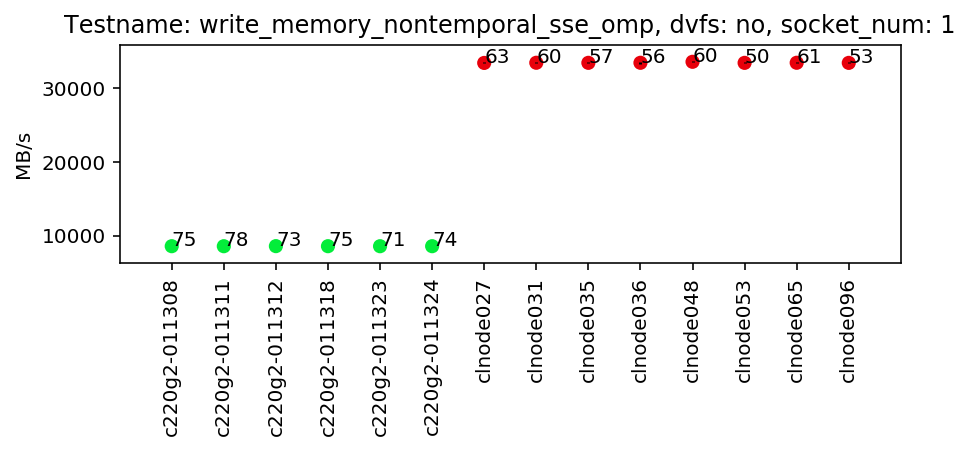

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse_omp-no-1.pdf

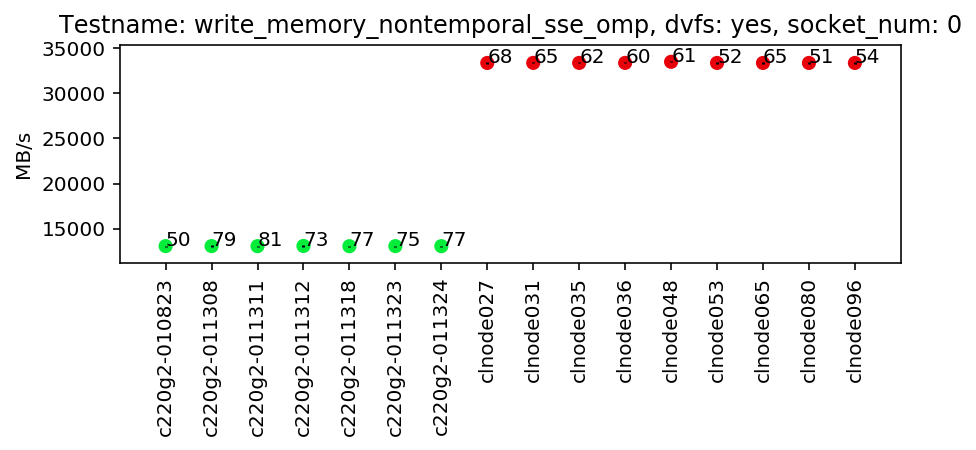

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse_omp-yes-0.pdf

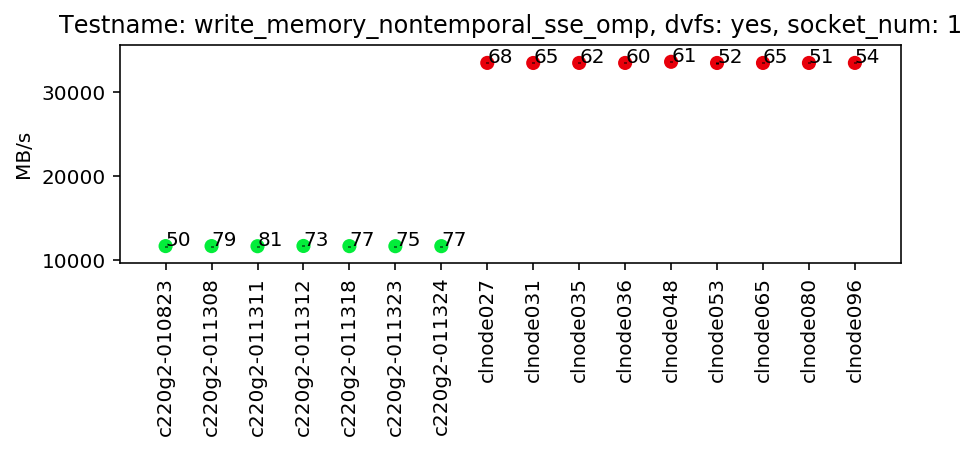

/notebooks/output/mem-aggr1-write_memory_nontemporal_sse_omp-yes-1.pdf

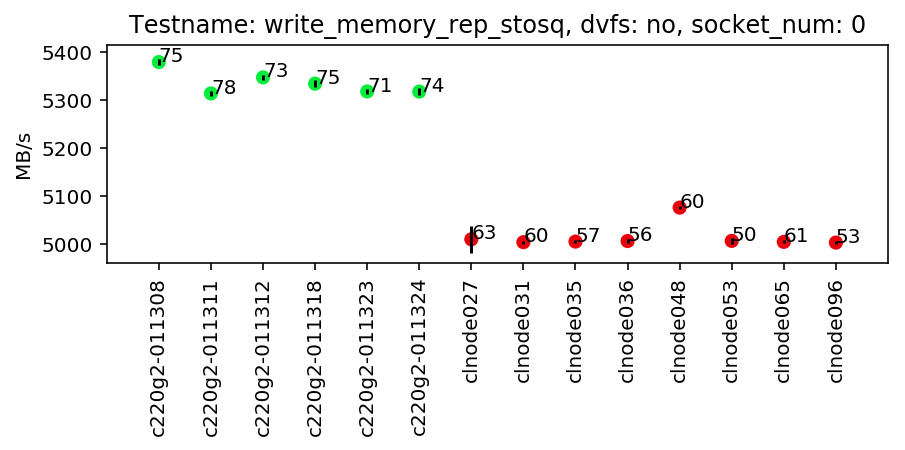

/notebooks/output/mem-aggr1-write_memory_rep_stosq-no-0.pdf

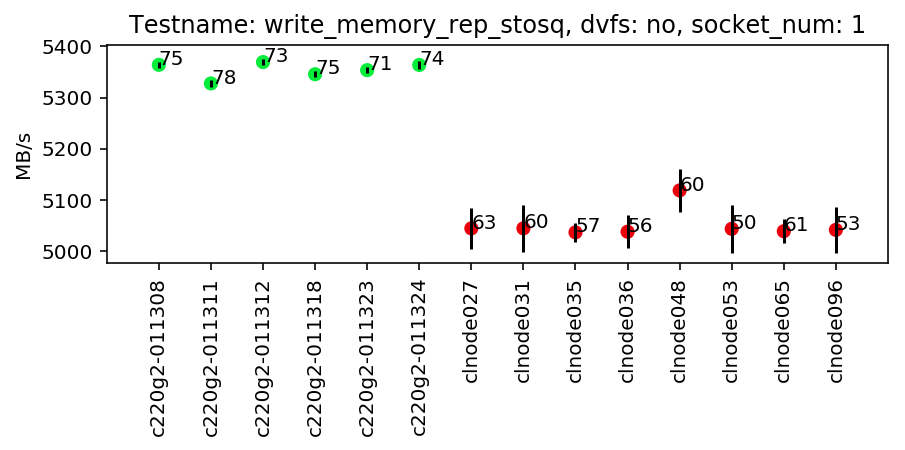

/notebooks/output/mem-aggr1-write_memory_rep_stosq-no-1.pdf

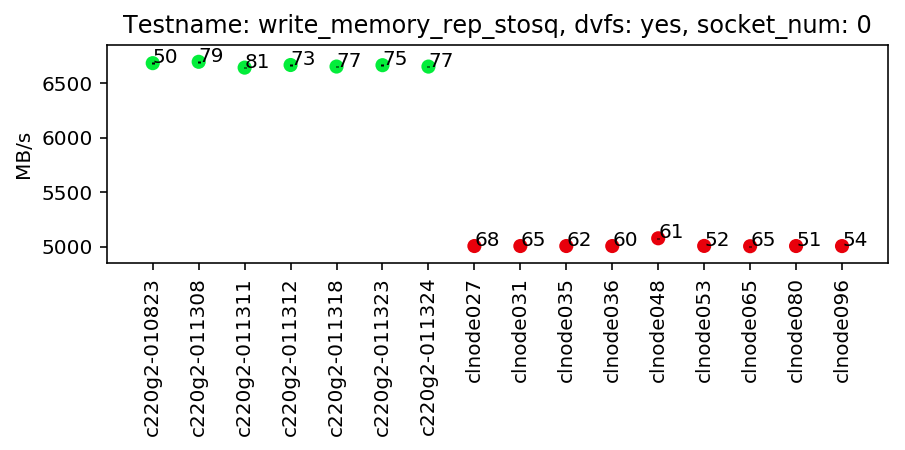

/notebooks/output/mem-aggr1-write_memory_rep_stosq-yes-0.pdf

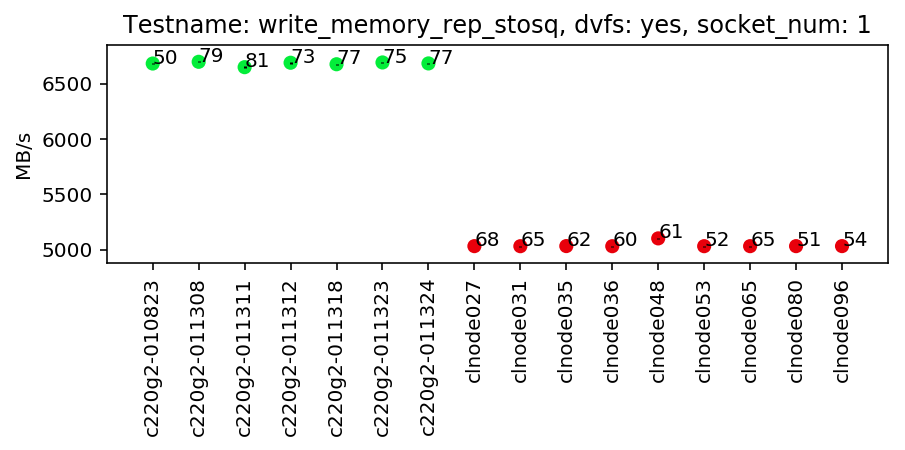

/notebooks/output/mem-aggr1-write_memory_rep_stosq-yes-1.pdf

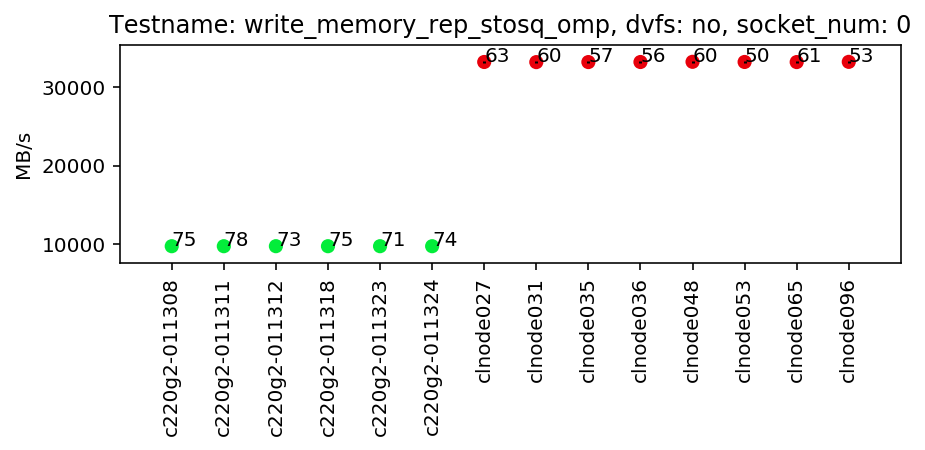

/notebooks/output/mem-aggr1-write_memory_rep_stosq_omp-no-0.pdf

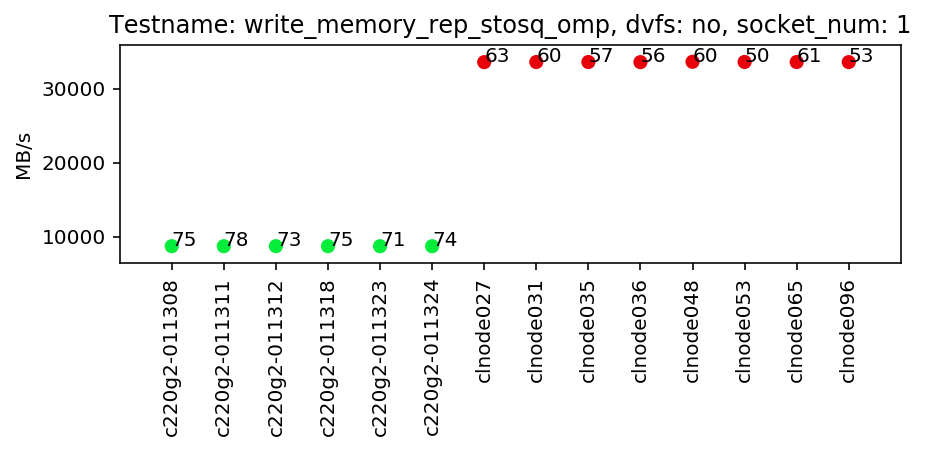

/notebooks/output/mem-aggr1-write_memory_rep_stosq_omp-no-1.pdf

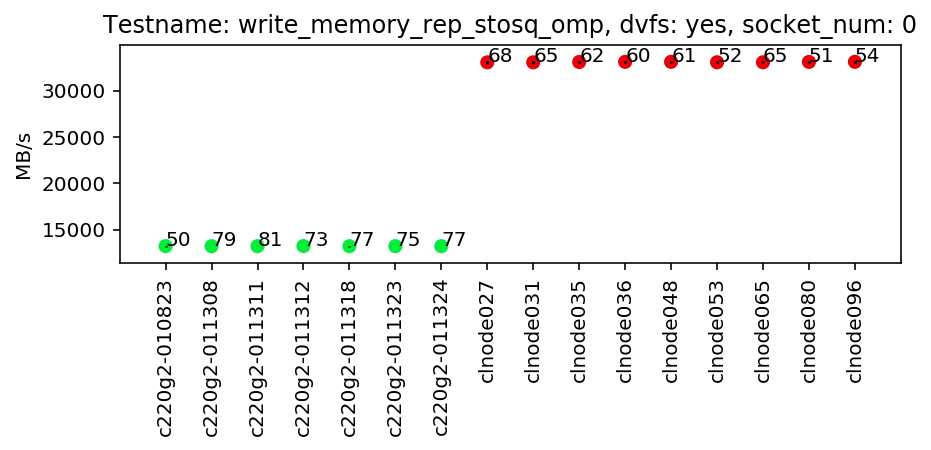

/notebooks/output/mem-aggr1-write_memory_rep_stosq_omp-yes-0.pdf

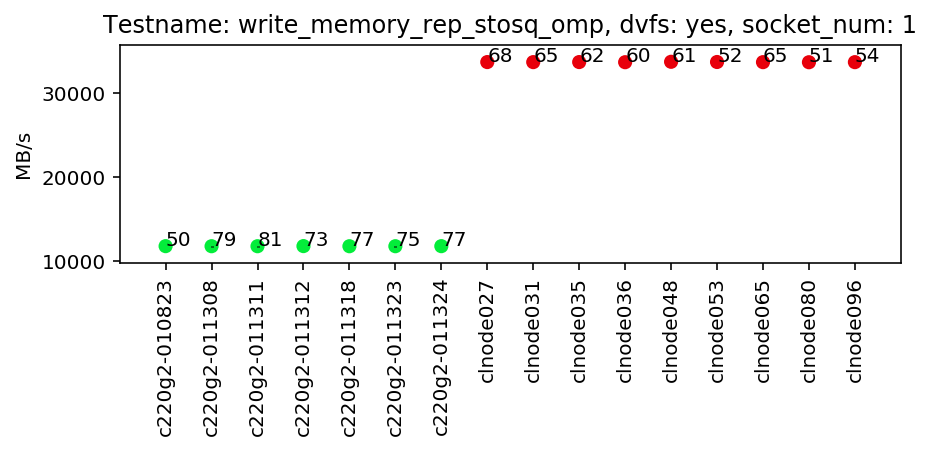

/notebooks/output/mem-aggr1-write_memory_rep_stosq_omp-yes-1.pdf

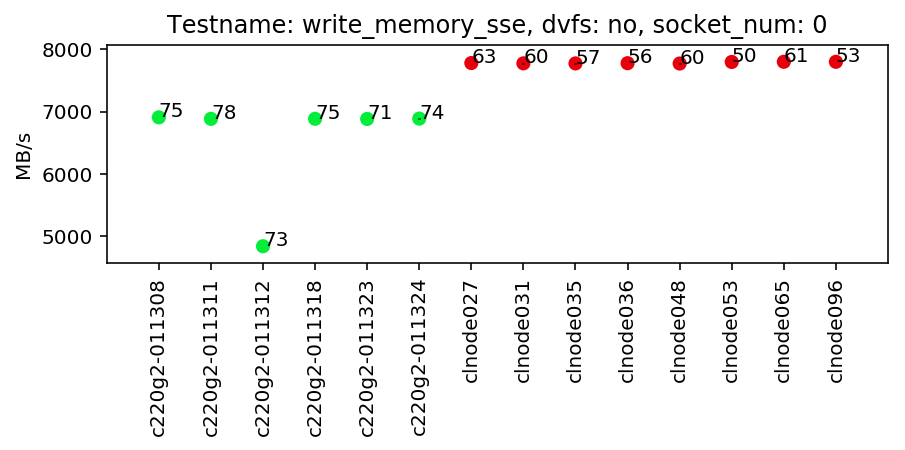

/notebooks/output/mem-aggr1-write_memory_sse-no-0.pdf

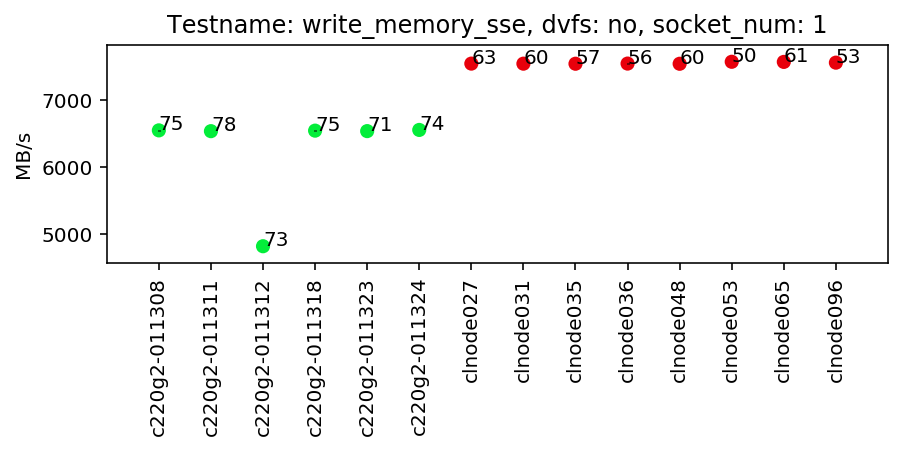

/notebooks/output/mem-aggr1-write_memory_sse-no-1.pdf

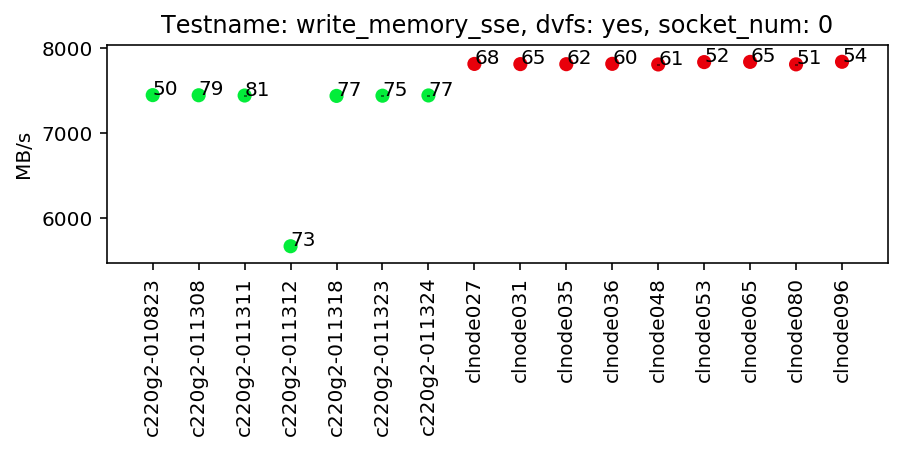

/notebooks/output/mem-aggr1-write_memory_sse-yes-0.pdf

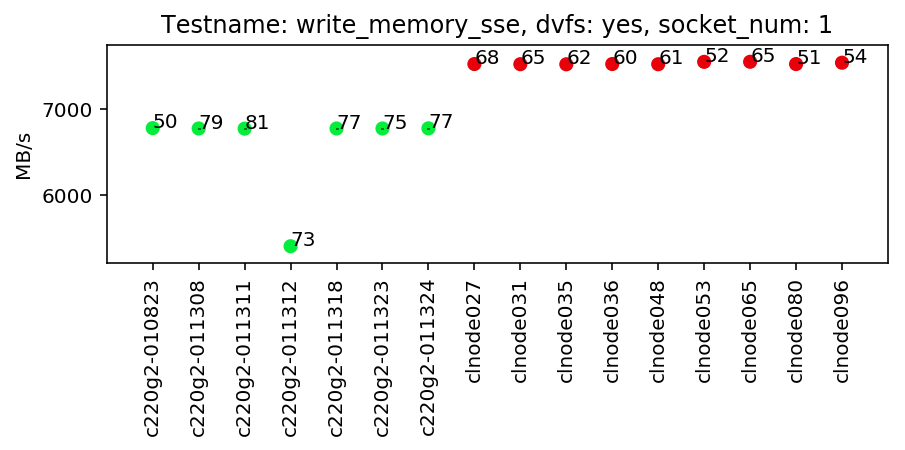

/notebooks/output/mem-aggr1-write_memory_sse-yes-1.pdf

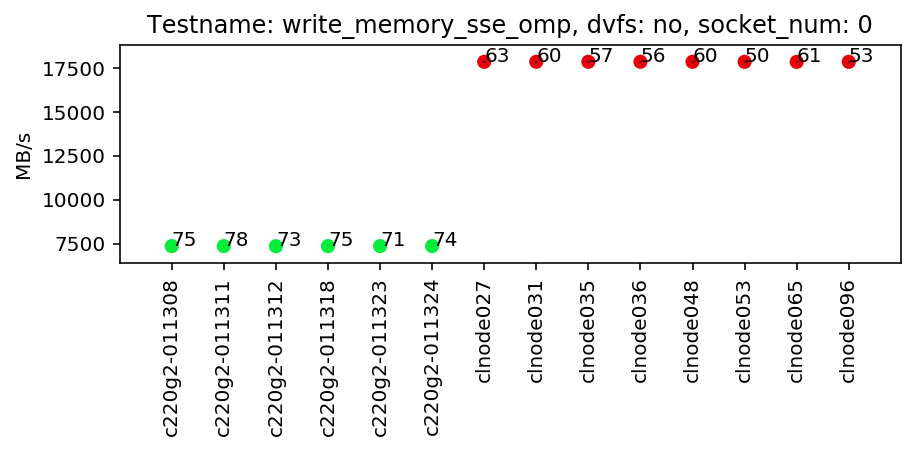

/notebooks/output/mem-aggr1-write_memory_sse_omp-no-0.pdf

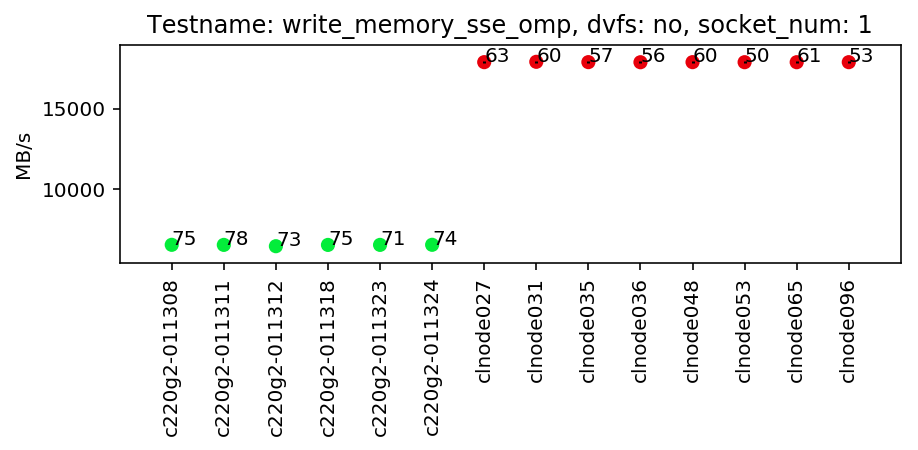

/notebooks/output/mem-aggr1-write_memory_sse_omp-no-1.pdf

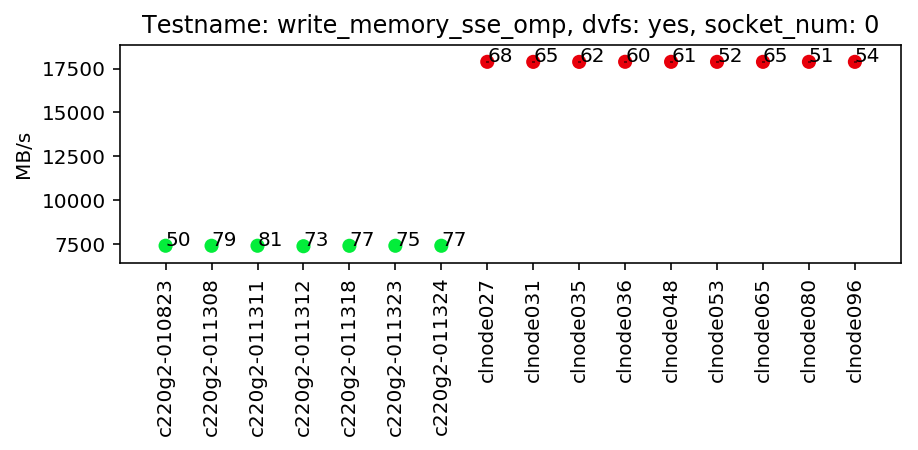

/notebooks/output/mem-aggr1-write_memory_sse_omp-yes-0.pdf

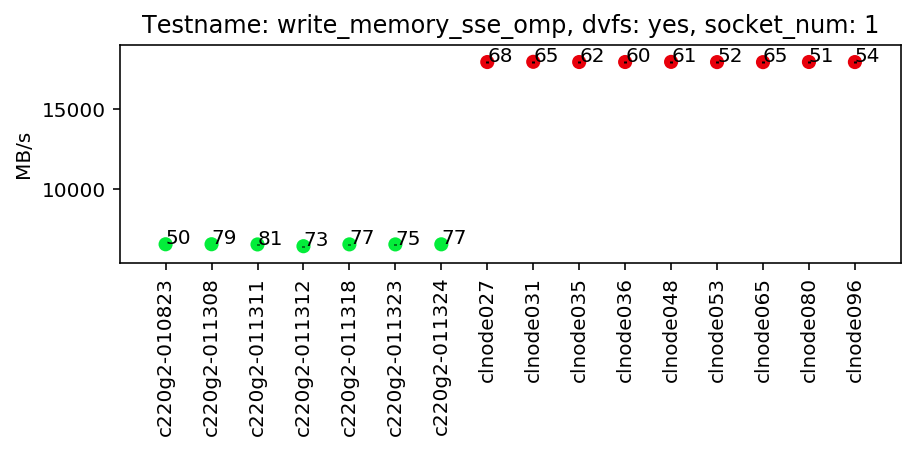

/notebooks/output/mem-aggr1-write_memory_sse_omp-yes-1.pdf

In [9]:
# Plot aggregate statistics for different groups of nodes
# Group by disk_type, testname, iodepth; show disk model using different colors

color_map = get_cmap(mem_aggr, "hw_type")

for key, grp in mem_aggr.groupby(["testname", "dvfs", "socket_num"]): 

            subset = grp.sort_values("nodeid")
            
            fig, ax = plt.subplots(figsize=(7, 2))
            x_vals = range(1, len(subset) + 1)
            
            subset["color"] = subset["hw_type"].map(color_map)
                    
            ax.errorbar(x_vals, subset["mean_mean"], yerr=subset["stdev_mean"], 
                        c='black', fmt='-', linestyle='None', label='_nolegend_')
            ax.scatter(x_vals, subset["mean_mean"], c = subset["color"], s=50, lw=0.0, label='_nolegend_');   
            
            # Customize
            #for lab, c in zip(["Disk Model: " + lab for lab in subset["disk_model"].unique()], \
            #                  subset["color"].unique()):
            #    ax.scatter([], [], c = c, s=50, lw=0.0, label=lab);
            
            ax.set_title('Testname: %s, dvfs: %s, socket_num: %s' % (key[0], key[1], key[2]))
            ax.set_ylabel(column2val(subset, "units"))
            ax.set_xlim([0, x_vals[-1] + 1])
            for item in ax.get_xticklabels():
                item.set_rotation(90)
            ax.set_xticks(x_vals)
            ax.set_xticklabels(subset["nodeid"]);
 
            # Annotate: add number of samples to each point
            for label, x, y in zip(subset["count"].values, x_vals, subset["mean_mean"].values):
                plt.annotate(label, xy=(x, y))
            
            #leg = ax.legend(loc="best")
            #leg.get_frame().set_alpha(0.3)
            
            plot_show_and_save(fig, "mem-aggr1-%s-%s-%s.pdf" % (key[0], key[1], key[2]), dest_dir)

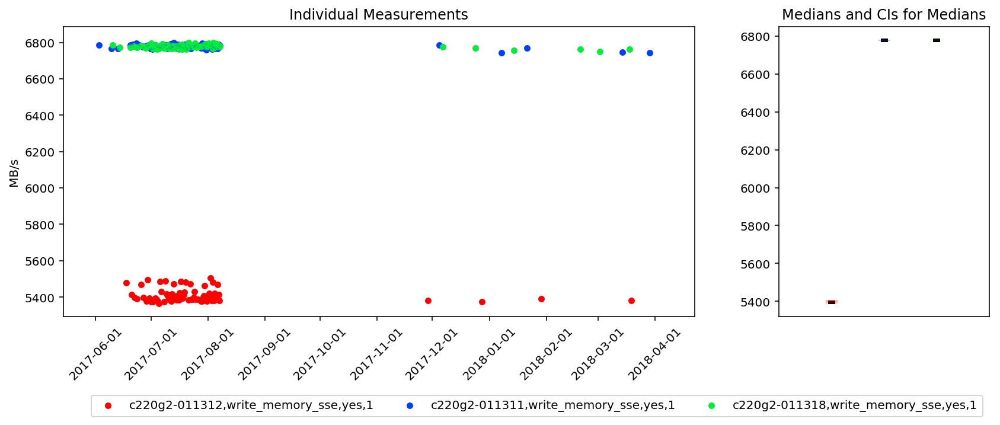

/notebooks/output/outlier-c220g2-011312_write_memory_sse_yes_1.pdf

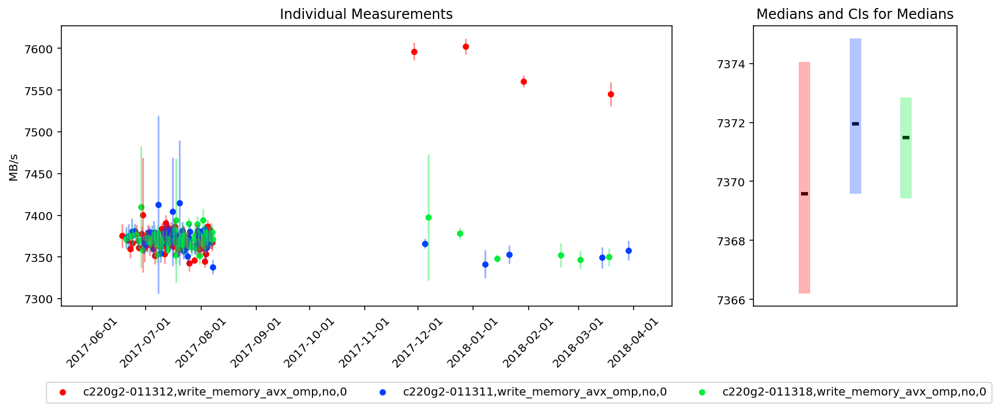

/notebooks/output/outlier-c220g2-011312_write_memory_avx_omp_no_0.pdf

In [10]:
# Zoom into specific outliers

def median_and_ci(s):
    """ For a value series (or dataframe column), return median and median CI, as defined 
    using nonparametric statistics
    
    - Details: http://www.ucl.ac.uk/ich/short-courses-events/about-stats-courses/stats-rm/Chapter_8_Content/confidence_interval_single_median
    - 1.96 is the factor computed for 0.95 confidence limit
    """
    n = len(s)
    s_median = s.median()
    lo_rank = int(np.rint(n / 2.0 - 1.96 * np.sqrt(n) / 2.0))
    hi_rank = int(np.rint(1 + n / 2.0 + 1.96 * np.sqrt(n) / 2.0))
    s_sorted = sorted(s.tolist())
    lo_val = s_sorted[lo_rank]
    hi_val = s_sorted[hi_rank]
    
    return s_median, lo_val, hi_val 

def zoom_and_plot(outlier, references, compare_ci=True):
    
    # Color-coding based on nodeid (show outlier samples in red)
    color_labels = [outlier["nodeid"]] + [el["nodeid"] for el in references]
    rgb_values = ["red"] + sns.color_palette("bright", len(references))
    color_map = dict(zip(color_labels, rgb_values))

    subset = subset_df(mem_all, outlier)
    label_outlier = ",".join([str(x) for x in outlier.values()])

    if compare_ci:
        # fig, axes = plt.subplots(1,2, sharey=False, figsize=(14, 5))
        fig = plt.figure(figsize=(14, 5)) 
        gs = gridspec.GridSpec(1, 2, width_ratios=[3, 1]) 
        ax1 = plt.subplot(gs[0])
        ax2 = plt.subplot(gs[1])
        axes = [ax1, ax2]
    else:
        fig, ax = plt.subplots(figsize=(10, 5))
        axes = [ax]
        
    x_vals = [dt.datetime.fromtimestamp(ts) for ts in subset["timestamp"].tolist()]
    axes[0].scatter(x_vals, subset["mean"], c=color_map[outlier["nodeid"]], s=30, lw=0.0, \
                    label=label_outlier.rstrip(", "));
    axes[0].errorbar(x_vals, subset["mean"], yerr=subset["stdev"], 
                            c='red', fmt='-', linestyle='None', label='_nolegend_', alpha=0.4)
    axes[0].set_ylabel(column2val(subset, "units"))
    axes[0].set_title("Individual Measurements")
    
    # Produce second plot for asymmetric CI for median calculated using nonparametric statistics
    if compare_ci:
        o_median, o_lo, o_hi = median_and_ci(subset["mean"])
        
        axes[1].set_title("Medians and CIs for Medians")
        axes[1].get_xaxis().set_visible(False)
        axes[1].errorbar(1, o_median, yerr=[np.array([o_median-o_lo]), np.array([o_hi-o_median])], \
                         c=color_map[outlier["nodeid"]], fmt='', lw = 10, alpha=0.3)
        axes[1].scatter(1, o_median, c='black', marker="_", lw =3.0)
        axes[1].set_xlim([0, len(references) + 2])
        
    # Add references scatter point and error bars
    for r_idx, r in enumerate(references):
        subset = subset_df(mem_all, r)
        label = ",".join([str(x) for x in r.values()])
        
        x_vals = [dt.datetime.fromtimestamp(ts) for ts in subset["timestamp"].tolist()] 
        axes[0].scatter(x_vals, subset["mean"], c=color_map[r["nodeid"]], s=30, lw=0.0, label=label.rstrip(", "));  

        axes[0].errorbar(x_vals, subset["mean"], yerr=subset["stdev"], 
                            c=color_map[r["nodeid"]], fmt='-', linestyle='None', label='_nolegend_', alpha=0.4)
        
        if compare_ci:
            r_median, r_lo, r_hi = median_and_ci(subset["mean"])
            axes[1].errorbar(2 + r_idx, r_median, yerr=[np.array([r_median-r_lo]), np.array([r_hi-r_median])], \
                         c=color_map[r["nodeid"]], fmt='', lw = 10, alpha=0.3)
            axes[1].scatter(2 + r_idx, r_median, c='black', marker="_", lw =3.0)

    #axes[0] = plt.gca();
    #xfmt = md.DateFormatter('%Y-%m-%d %H:%M:%S')
    xfmt = md.DateFormatter('%Y-%m-%d')
    axes[0].xaxis.set_major_formatter(xfmt);

    plt.subplots_adjust(bottom=0.2);
    
    for tick in axes[0].get_xticklabels():
        tick.set_rotation(45)

    #leg = ax.legend(loc="best")
    #leg.get_frame().set_alpha(0.1)

    axes[0].legend(loc='upper center', bbox_to_anchor=(0.75 if compare_ci else 0.5, -0.25),
              fancybox=True, shadow=False, ncol=len(color_labels), fontsize = 10) 
    
    plot_show_and_save(fig, \
                       "outlier-%s.pdf" % (\
                                           label_outlier.replace(",","_").\
                                           replace("/","_").replace(" ","").replace("__","_")
                                           ),
                      dest_dir)

# First element in lists defined below is interpreted as the outlier, the rest are references

# HDD case that obviously looks bad: large std in outlier's reads     
c1 = [["c220g2-011312", "write_memory_sse", "yes", 1], 
      ["c220g2-011311", "write_memory_sse", "yes", 1], 
      ["c220g2-011318", "write_memory_sse", "yes", 1]] 
# Same nodes, different test  
c2 = [["c220g2-011312", "write_memory_avx_omp", "no", 0], 
      ["c220g2-011311", "write_memory_avx_omp", "no", 0], 
      ["c220g2-011318", "write_memory_avx_omp", "no", 0]] 

for c in [c1, c2]:
    (o_n, o_t, o_d, o_s) = c[0]
    outlier = OrderedDict([("nodeid",o_n), ("testname",o_t), ("dvfs",o_d), ("socket_num",o_s)]) 
    references = []
    for r in c[1:]:
        (r_n, r_t, r_d, r_s) = r
        references.append(OrderedDict([("nodeid",r_n), ("testname",r_t), ("dvfs",r_d), ("socket_num",r_s)]))
    zoom_and_plot(outlier, references, compare_ci=True)

In [11]:
# Show analyzed hw types and corresponding memory frequencies. Is it one-to-one mapping?

for key, grp in mem_aggr.groupby(["hw_type", "mem_clock_speed"]):
    print key

('c220g2', '2133MHz')
('c8220', '1333MHz')
('m400', 'Unknown(ARM)')


/opt/conda/envs/py27/lib/python2.7/site-packages/statsmodels/nonparametric/kde.py:475: DeprecationWarning: object of type <type 'numpy.float64'> cannot be safely interpreted as an integer.
  grid,delta = np.linspace(a,b,gridsize,retstep=True)


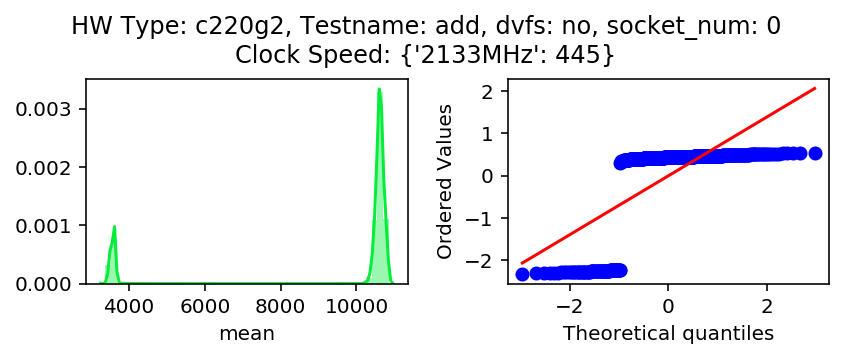

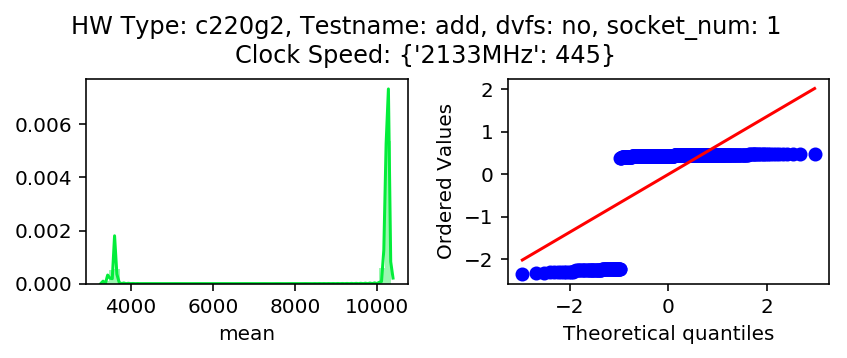

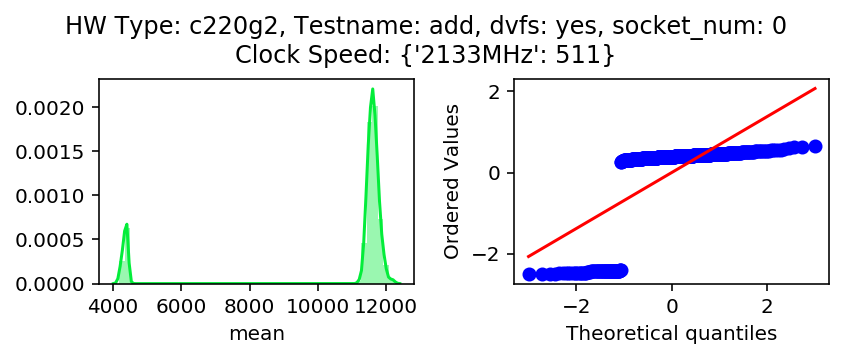

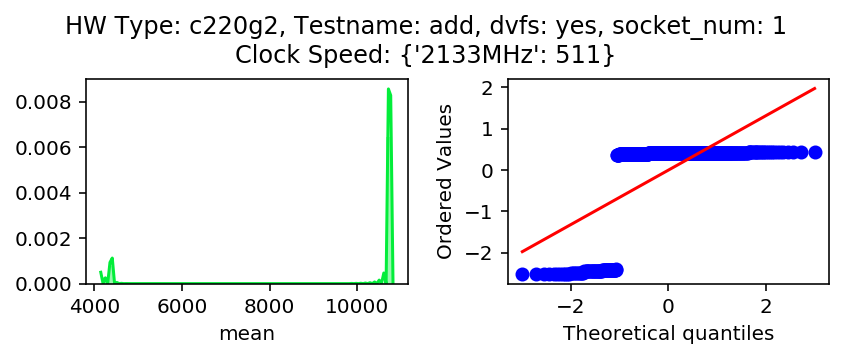

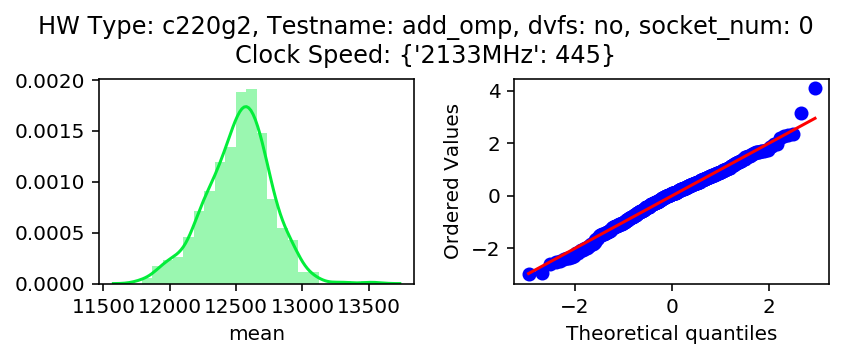

...

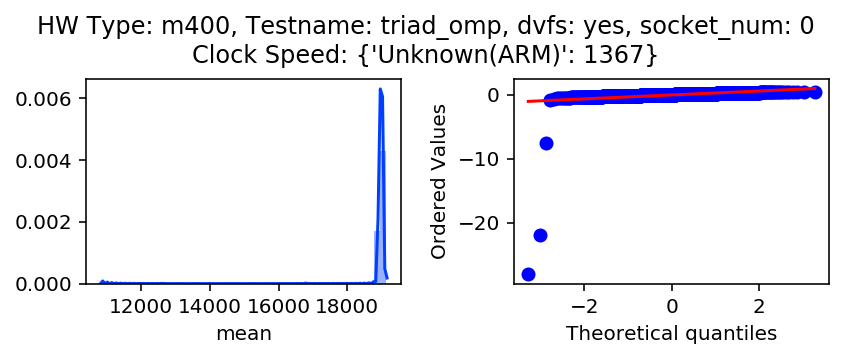

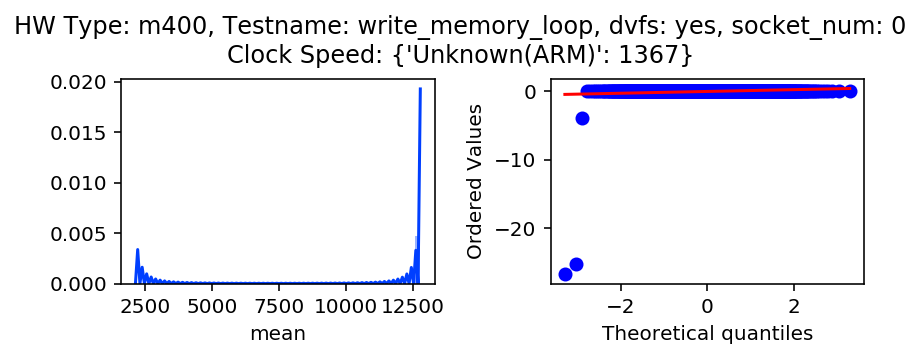

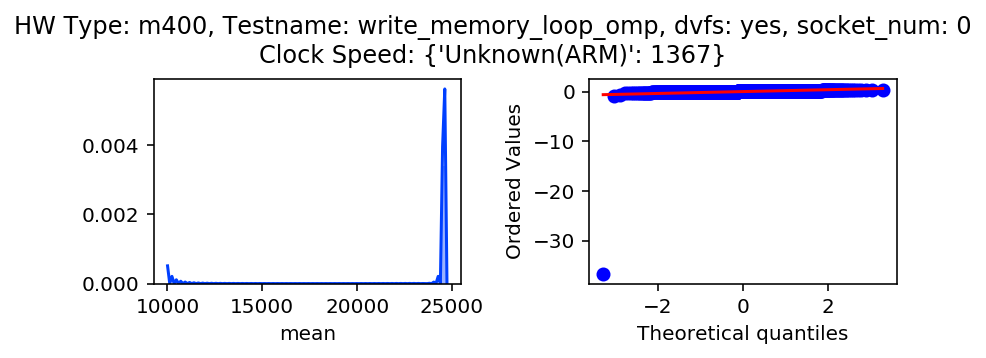

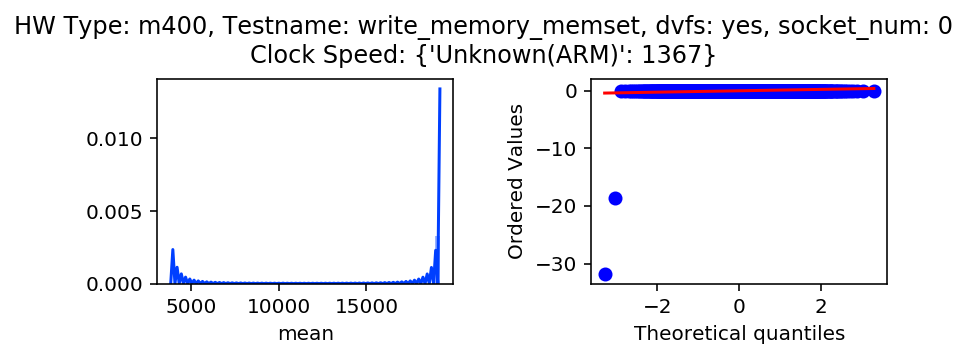

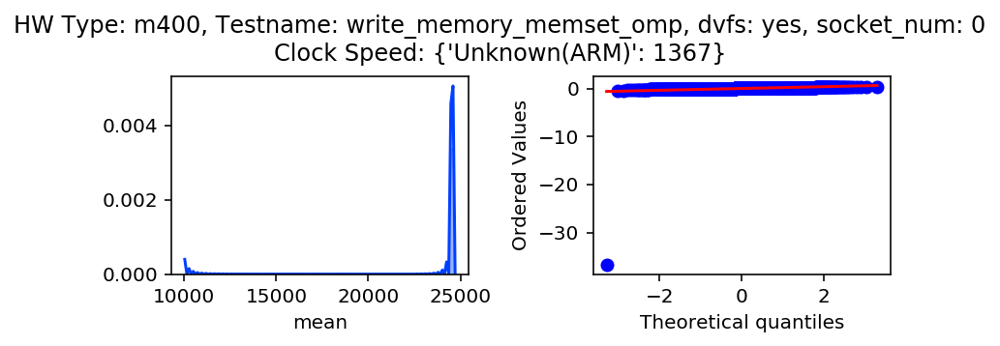

In [12]:
# Show histograms for all combinations of disk models and benchmarks 

color_map = get_cmap(mem_aggr, "hw_type")

sample_size = ['all', 20, 100, 200] 
shapiro_wilk = pd.DataFrame(columns=sample_size)
shapiro_wilk_size = pd.DataFrame(columns=["length"])

for key, grp in mem_aggr.groupby(["hw_type", "testname", "dvfs", "socket_num"]): 

    samples_for_type = pd.merge(grp, mem_all, 
                               on=["nodeid", "testname", "dvfs", "socket_num"]) 
    
    # Add environment info
    samples_for_type = pd.merge(samples_for_type, db["env_info"], on=["run_uuid", "nodeid", "nodeuuid"])
        
    #if column2val(subgrp, "units_x") == "KB/s":
    #    subgrp["mean"] = subgrp["mean"] / 1024.0 
    #    new_unit = "MB/s"

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6,2.5))
    sns.distplot(samples_for_type["mean"], color=color_map[key[0]], ax = ax1);
    #ax1.set_xlabel(column2val(samples_for_type, "units"))
    #site = column2val(subgrp, "site")
    fig.suptitle("HW Type: %s, Testname: %s, dvfs: %s, socket_num: %s\nClock Speed: %s" % \
                 (key[0], key[1], key[2], key[3],
                 str(dict(samples_for_type["mem_clock_speed"].value_counts()))))
    # print subgrp["nthreads"].value_counts()

    z = (samples_for_type["mean"]-samples_for_type["mean"].mean())/samples_for_type["mean"].std()

    sw_vals = [stats.shapiro(samples_for_type["mean"])[1] \
                       if ss == "all" else stats.shapiro(samples_for_type["mean"].sample(ss))[1] for ss in sample_size]
    shapiro_wilk.loc[len(shapiro_wilk)] = sw_vals
    shapiro_wilk_size.loc[len(shapiro_wilk_size)] = [len(samples_for_type)]
    
    stats.probplot(z, dist="norm", plot=ax2)
    #ax2.set_title("Normal Q-Q plot")
    ax2.set_title("")

    fig.tight_layout()
    plt.subplots_adjust(top=0.8);

    #dest = "hist-%s_%s_%s_%s_%s_%s.pdf" % (site, key[0], key[1], subkey[0], subkey[1], subkey[2]) 
    #plot_show_and_save(fig, dest.replace("/","_").replace(" ","").replace("__","_"), dest_dir)
   
    plot_show_and_save(fig, "", "", show_only=True)

Total number of studied configurations (points on the following plots):  270


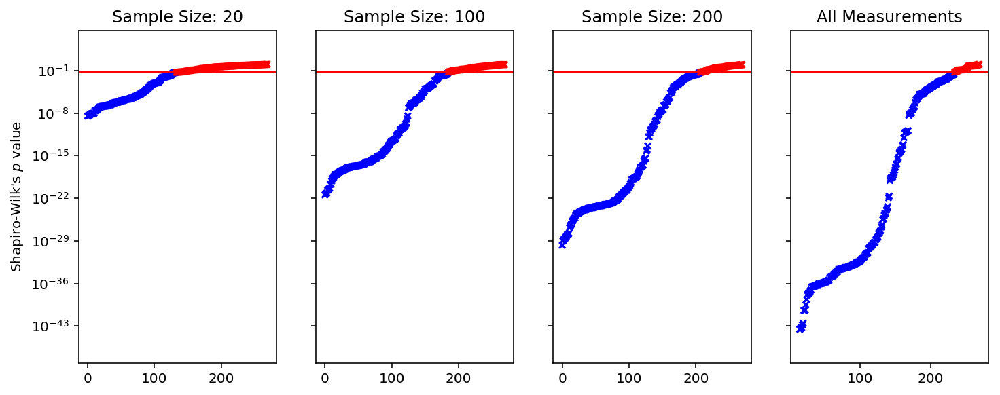

/notebooks/output/mem-shapiro-wilk.pdf

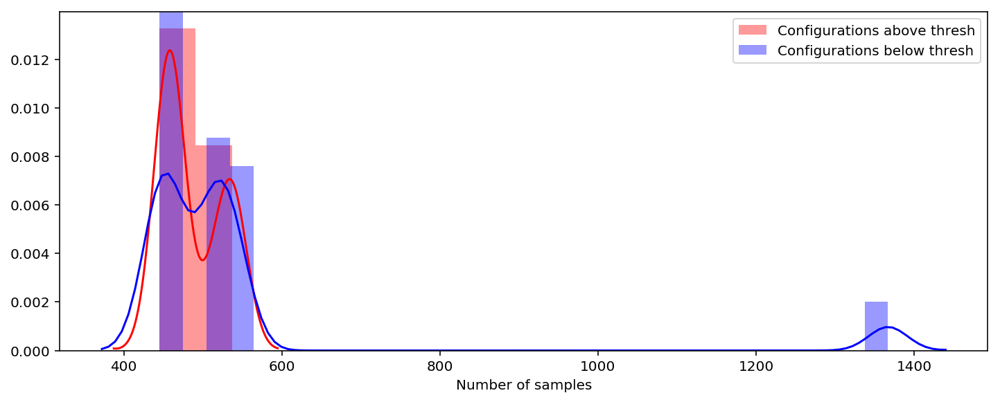

/notebooks/output/mem-shapiro-wilk-sizes.pdf

In [13]:
# Specified significance level will be shown as a red line; points above will be shown in red, otherwise - blue  
thresh = 0.05

# Points above the line show configurations for which we cannot reject the null hypothesis suggesting 
# that the data is a sample from a normal distribution. For points below the line,
# we can reject this hypothesis 

fig, axes = plt.subplots(1, len(shapiro_wilk.columns), sharey=True, figsize=(12,4.5))
if len(shapiro_wilk.columns) == 1:
    axes = [axes]
axes[0].set_ylabel("Shapiro-Wilk's $p$ value")

print "Total number of studied configurations (points on the following plots): ", len(shapiro_wilk)

# Show 'all' last
reordered_columns = np.roll(shapiro_wilk.columns, -1)
for c, ax in zip(reordered_columns, axes):
    vals = shapiro_wilk[c].sort_values()
    
    # Assign different colors to points above and below thresh
    point_color = vals.apply(lambda x: "blue" if x <= thresh else "red")
    
    ax.scatter(range(len(vals)), vals, s = 20, marker="x", c=point_color)
    ax.set_yscale('log')
    ax.set_title("All Measurements" if c == "all" else "Sample Size: %d" % c)
    ax.axhline(y=thresh, c = "red")

plot_show_and_save(fig, "mem-shapiro-wilk.pdf", dest_dir)

# Assign colors based on "All Measurements"
shapirot_wilk_plot = shapiro_wilk.copy()
shapirot_wilk_plot["color"] = shapirot_wilk_plot["all"].apply(lambda x: "blue" if x <= thresh else "red")
shapirot_wilk_plot["length"] = shapiro_wilk_size["length"]

fig, ax = plt.subplots(figsize=(12,4.5))
sns.distplot(shapirot_wilk_plot[shapirot_wilk_plot["color"]=="red"]["length"].tolist(), color="red", ax = ax, 
            label="Configurations above thresh");
sns.distplot(shapirot_wilk_plot[shapirot_wilk_plot["color"]=="blue"]["length"].tolist(), color="blue", ax = ax,
            label="Configurations below thresh");
ax.set_xlabel("Number of samples")
leg = ax.legend(loc="best")
plot_show_and_save(fig, "mem-shapiro-wilk-sizes.pdf", dest_dir)

/opt/conda/envs/py27/lib/python2.7/site-packages/seaborn/categorical.py:342: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  elif is_categorical(y):


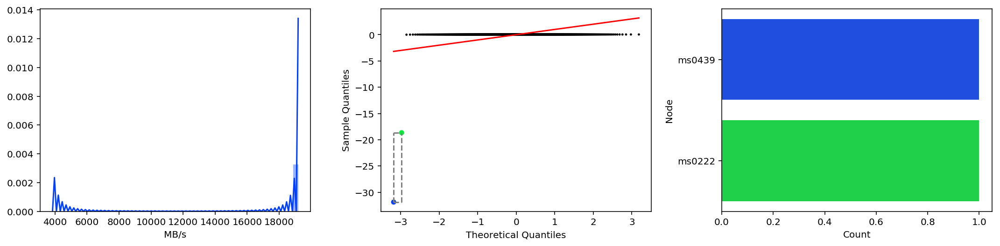

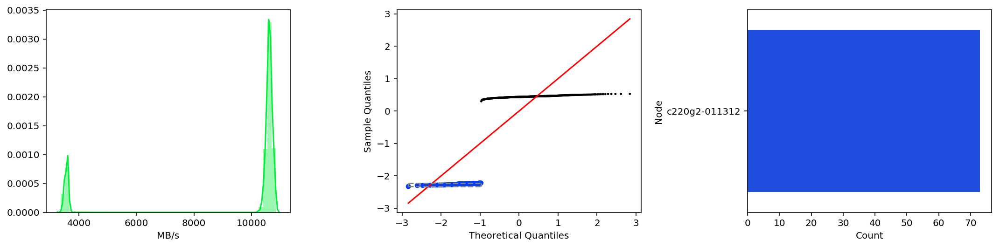

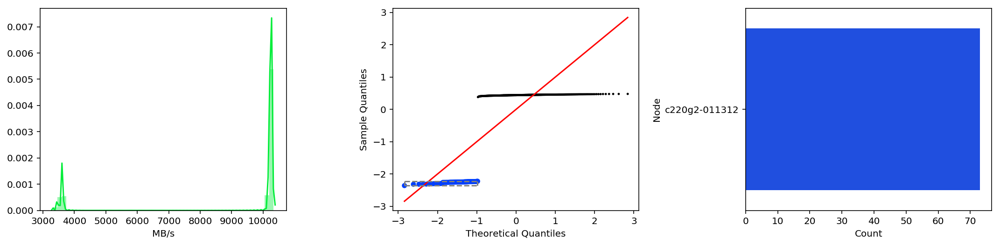

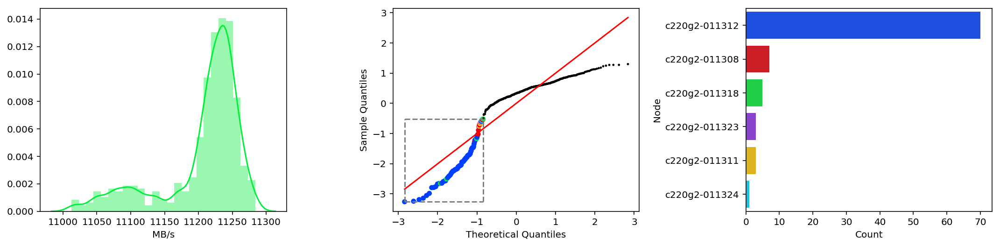

In [14]:
# Experiment more with qq-plots

def labeled_qq_plot(hw_type, testname, dvfs, socket_num, thresh=-3.0, label_offset_scale=160, label=True):
    color_map = get_cmap(mem_aggr, "hw_type")

    subset = subset_df(mem_aggr, {"hw_type": hw_type, "testname": testname, "dvfs": dvfs, "socket_num": socket_num})

    subset = pd.merge(subset, mem_all, 
                               on=["nodeid", "testname", "dvfs", "socket_num"]) 
    #print "Number of points: ", len(subset)
    
    #if column2val(subset, "units_x") == "KB/s":
    #    subset["mean"] = subset["mean"] / 1024.0 
    #    subset["min"] = subset["min"] / 1024.0 
    #    subset["max"] = subset["max"] / 1024.0
    #    new_unit = "MB/s"
    #else:
    #    print "Error: unexpected bw performance unit"
    new_unit = column2val(subset, "units_x")
    
    #fig, axes = plt.subplots(1, 4, figsize=(15, 4))
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))

    sns.distplot(subset["mean"], color=color_map[hw_type], ax = axes[0]);
    #sns.distplot(subset["min"], color="gray", ax = axes[0]);
    #sns.distplot(subset["max"], color="gray", ax = axes[0]);

    axes[0].set_xlabel(new_unit)

    subset["z"] = (subset["mean"]-subset["mean"].mean())/subset["mean"].std()

    #stats.probplot(subset["z"], dist="norm", plot=axes[1])
    #axes[1].set_title("")
    
    ordered_subset = subset.sort_values("z")

    # Manually constructs vectors for qq-plot
    n = len(subset)
    q = np.linspace(1.0/(n+1), 1.0 - 1.0/(n+1), num=n)  
    ordered_subset["theor_qv"] = norm.ppf(q)
    
    low_end = ordered_subset[ordered_subset["z"] < thresh]
    label_offset_y = np.linspace(0, label_offset_scale, num=len(low_end)) 
    label_offset_x = np.linspace(label_offset_scale, 0, num=len(low_end))
    
    node_color_map = get_cmap(low_end, "nodeid")
    xxx = ordered_subset["theor_qv"].tolist()
    yyy = ordered_subset["z"].tolist()
    ccc = ["black" if row["z"] >= thresh else node_color_map[row["nodeid"]] for idx, row in ordered_subset.iterrows()]
    sss = [2.0 if row["z"] >= thresh else 20.0 for idx, row in ordered_subset.iterrows()]
    
    axes[1].scatter(xxx, yyy, c=ccc, s=sss);
    
    # Use the same axies limits as on the previous subplot
    #axes[2].set_xlim(axes[1].get_xlim())
    #axes[2].set_ylim(axes[1].get_ylim())
    
    axes[1].plot([ordered_subset["theor_qv"].min(), ordered_subset["theor_qv"].max()], 
                 [ordered_subset["theor_qv"].min(), ordered_subset["theor_qv"].max()], '-', c="red")
    
    axes[1].set_xlabel("Theoretical Quantiles")
    axes[1].set_ylabel("Sample Quantiles")
    
    # Create rectange around points below thresh
    r_x_min = low_end["theor_qv"].min()
    r_x_max = low_end["theor_qv"].max()
    r_y_min = low_end["z"].min()
    r_y_max = low_end["z"].max()
    axes[1].plot([r_x_min, r_x_max], [r_y_min, r_y_min], '--', c="gray")
    axes[1].plot([r_x_min, r_x_max], [r_y_max, r_y_max], '--', c="gray")
    axes[1].plot([r_x_min, r_x_min], [r_y_min, r_y_max], '--', c="gray")
    axes[1].plot([r_x_max, r_x_max], [r_y_min, r_y_max], '--', c="gray")

    # Annotate a subset below specified threshold
    if label:
        for idx, (index, row) in enumerate(low_end.iterrows()):
            axes[1].annotate(row["nodeid"], 
                        xy=(row["theor_qv"], row["z"]),
                        xytext=(label_offset_x[idx], label_offset_y[idx]),
                        textcoords='offset points',
                        fontsize=10,
                        arrowprops=dict(arrowstyle='->', color='black', lw = 1.0))
    
    node_counts = low_end["nodeid"].value_counts()
    sns.barplot(x=node_counts.tolist(), y=node_counts.index.tolist(), data=low_end, 
                label="Total", 
                palette=sns.color_palette([node_color_map[v] for v in node_counts.index.tolist()]), ax=axes[2])
    #axes[2].set_xticks(range(node_counts.max() + 1)) 
    
    axes[2].set_xlabel("Count")
    axes[2].set_ylabel("Node")
    
    #fig.suptitle("hw_type: %s, device: %s, testname: %s, iodepth: %d, # of samples: %d" % \
    #             (hw_type, device, testname, iodepth, len(subset)))
    fig.tight_layout()
    plt.subplots_adjust(top=0.9);
    
    plot_show_and_save(fig, "", dest_dir, show_only=True)
    
labeled_qq_plot("m400", "write_memory_memset", "yes", 0, thresh=-2.0, label=False)
labeled_qq_plot("c220g2", "add", "no", 0, thresh=-2.0, label=False)
labeled_qq_plot("c220g2", "add", "no", 1, thresh=-2.0, label=False)
labeled_qq_plot("c220g2", "add_omp", "no", 1, thresh=-0.5, label=False)

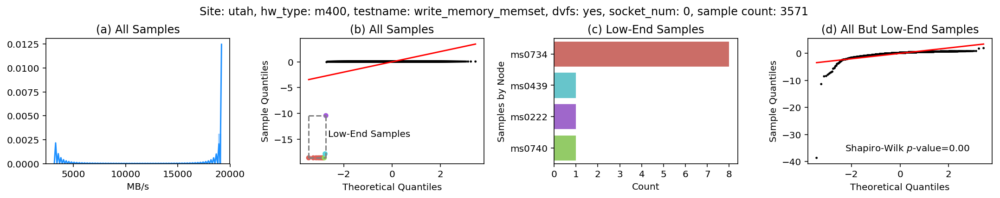

/notebooks/output/mem-qq-analysis-m400-write_memory_memset-yes-0.pdf

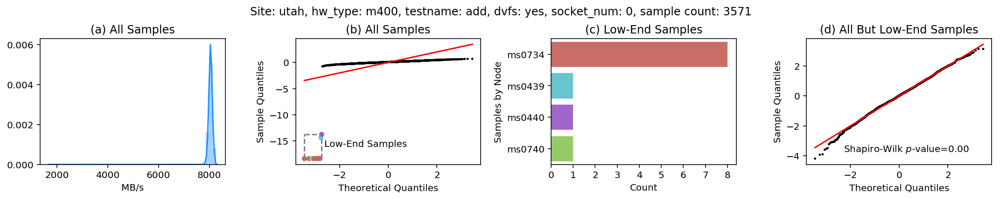

/notebooks/output/mem-qq-analysis-m400-add-yes-0.pdf

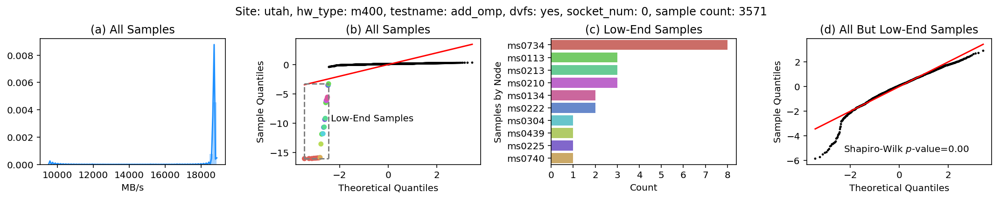

/notebooks/output/mem-qq-analysis-m400-add_omp-yes-0.pdf

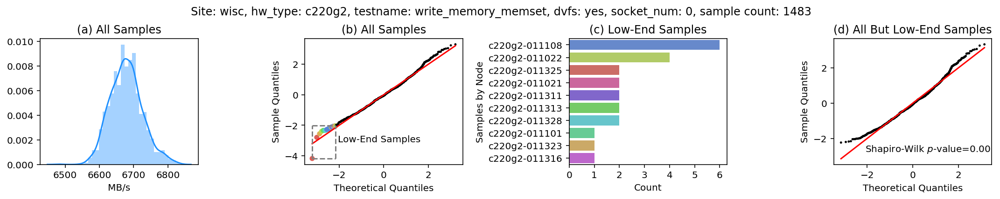

/notebooks/output/mem-qq-analysis-c220g2-write_memory_memset-yes-0.pdf

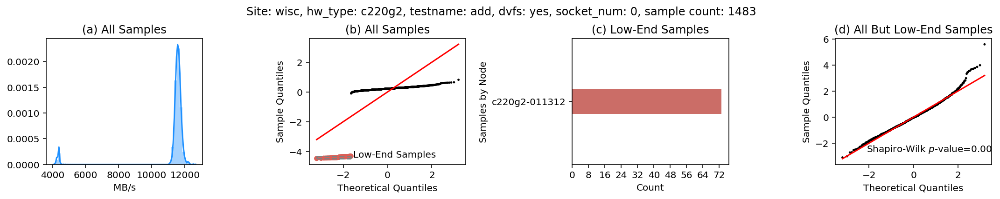

/notebooks/output/mem-qq-analysis-c220g2-add-yes-0.pdf

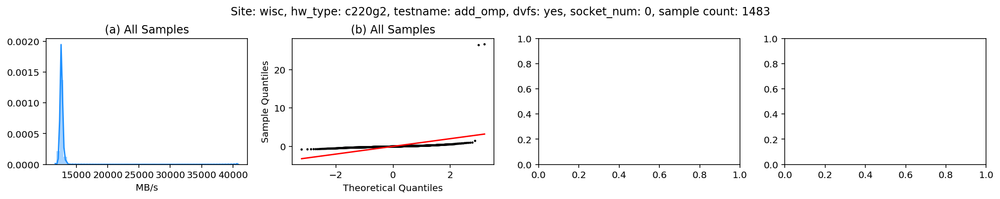

/notebooks/output/mem-qq-analysis-c220g2-add_omp-yes-0.pdf

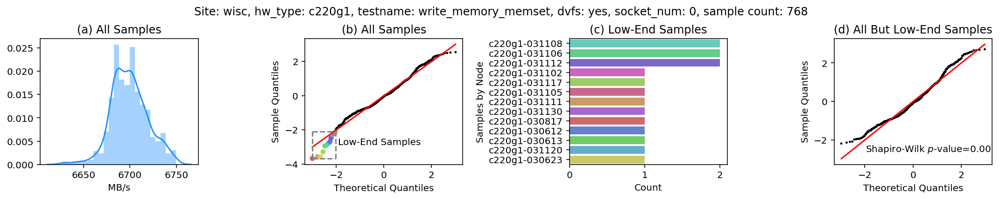

/notebooks/output/mem-qq-analysis-c220g1-write_memory_memset-yes-0.pdf

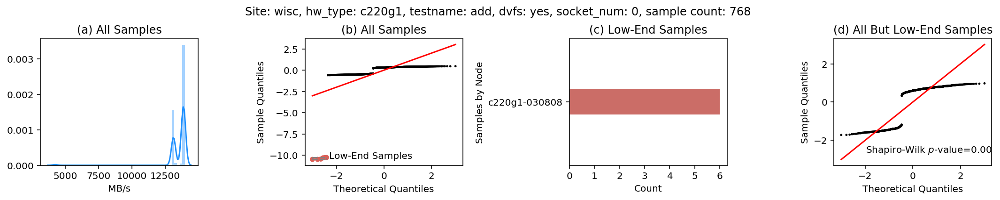

/notebooks/output/mem-qq-analysis-c220g1-add-yes-0.pdf

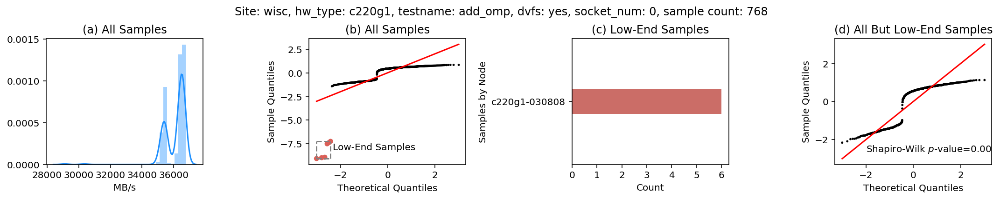

/notebooks/output/mem-qq-analysis-c220g1-add_omp-yes-0.pdf

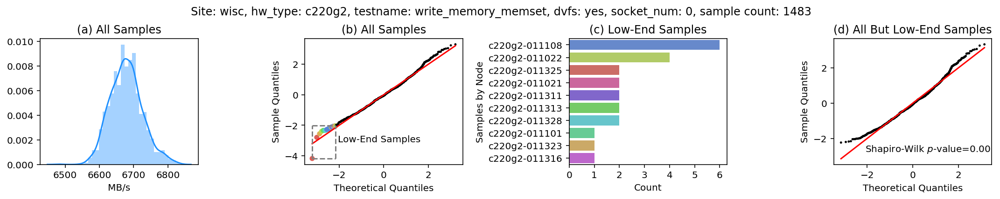

/notebooks/output/mem-qq-analysis-c220g2-write_memory_memset-yes-0.pdf

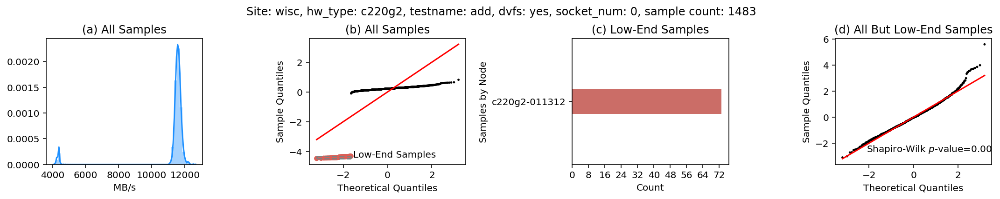

/notebooks/output/mem-qq-analysis-c220g2-add-yes-0.pdf

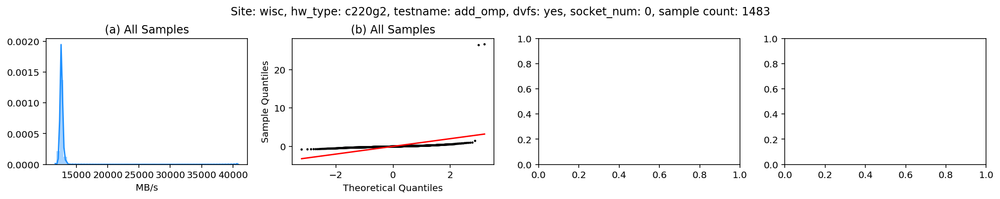

/notebooks/output/mem-qq-analysis-c220g2-add_omp-yes-0.pdf

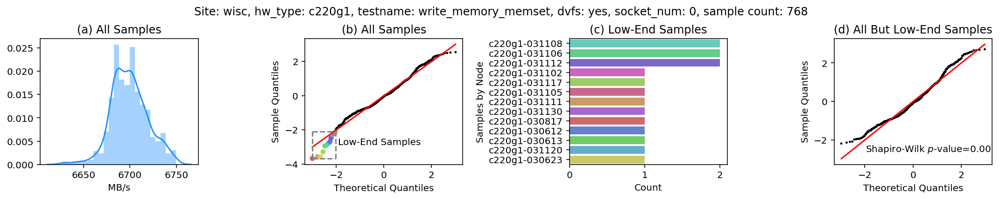

/notebooks/output/mem-qq-analysis-c220g1-write_memory_memset-yes-0.pdf

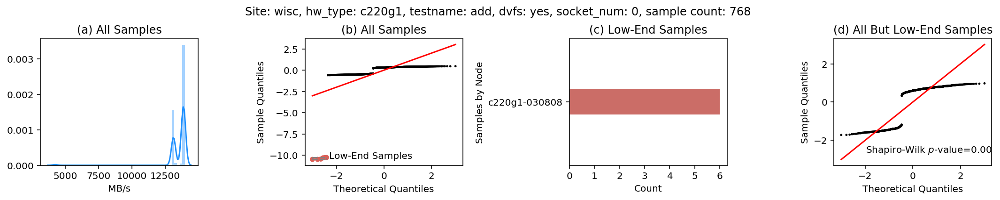

/notebooks/output/mem-qq-analysis-c220g1-add-yes-0.pdf

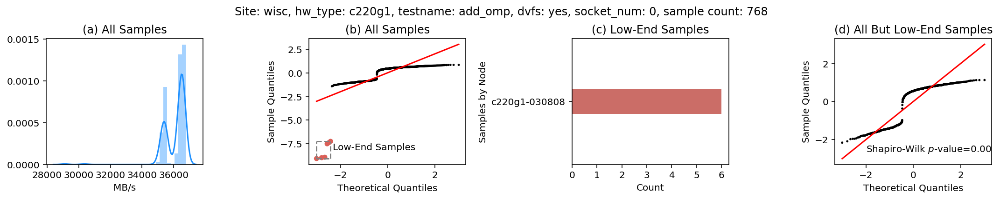

/notebooks/output/mem-qq-analysis-c220g1-add_omp-yes-0.pdf

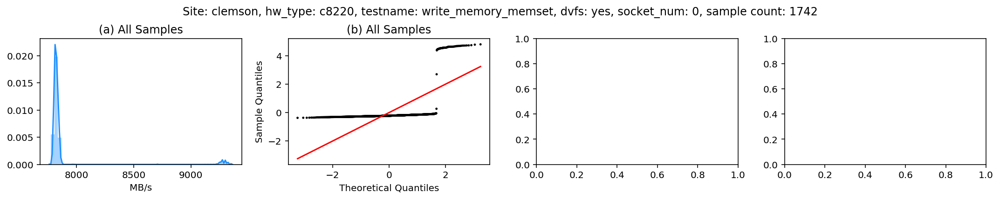

/notebooks/output/mem-qq-analysis-c8220-write_memory_memset-yes-0.pdf

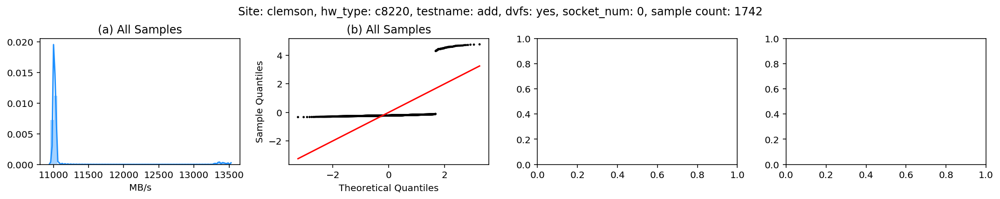

/notebooks/output/mem-qq-analysis-c8220-add-yes-0.pdf

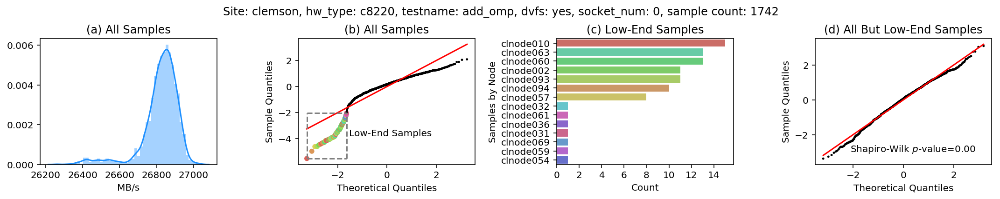

/notebooks/output/mem-qq-analysis-c8220-add_omp-yes-0.pdf

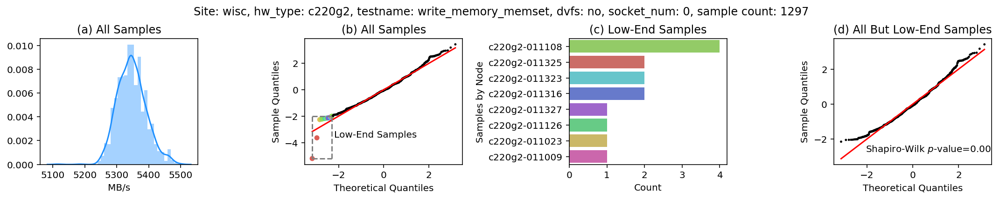

/notebooks/output/mem-qq-analysis-c220g2-write_memory_memset-no-0.pdf

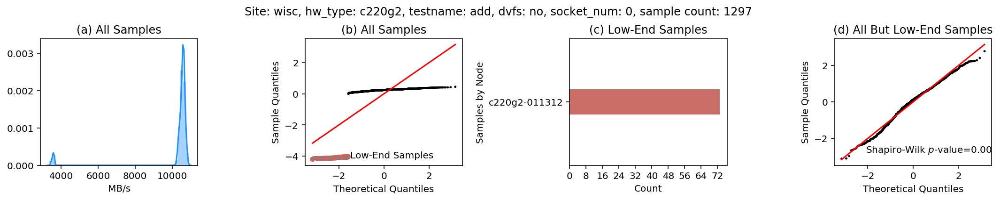

/notebooks/output/mem-qq-analysis-c220g2-add-no-0.pdf

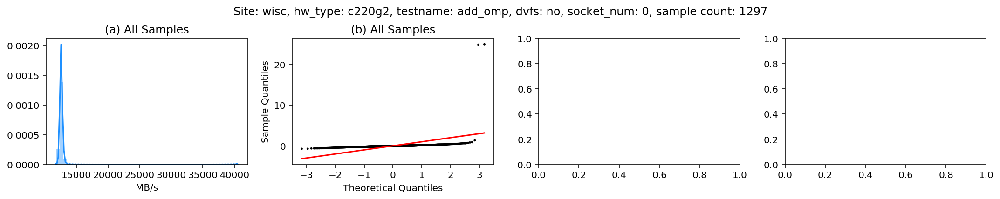

/notebooks/output/mem-qq-analysis-c220g2-add_omp-no-0.pdf

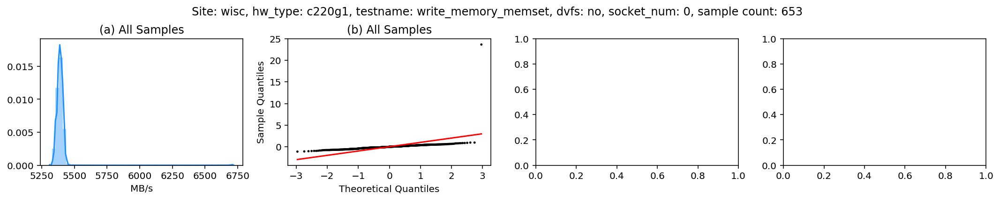

/notebooks/output/mem-qq-analysis-c220g1-write_memory_memset-no-0.pdf

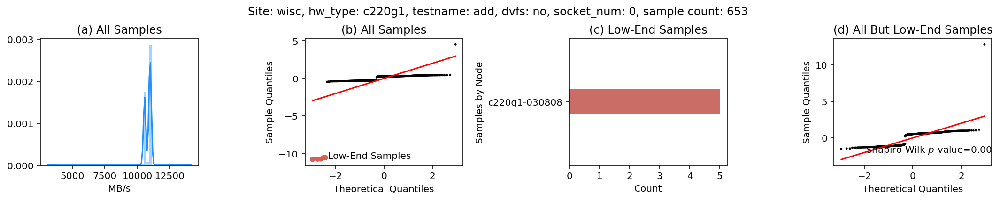

/notebooks/output/mem-qq-analysis-c220g1-add-no-0.pdf

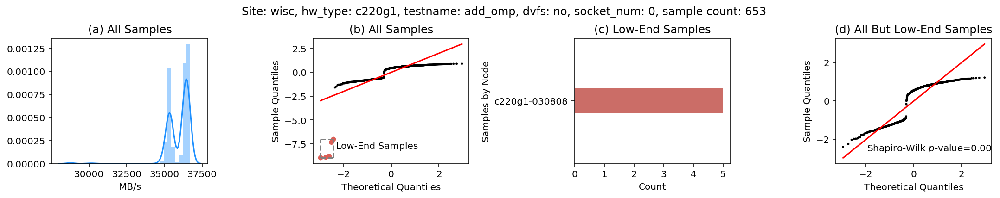

/notebooks/output/mem-qq-analysis-c220g1-add_omp-no-0.pdf

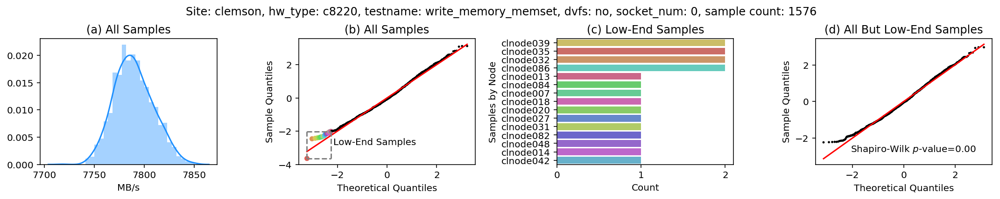

/notebooks/output/mem-qq-analysis-c8220-write_memory_memset-no-0.pdf

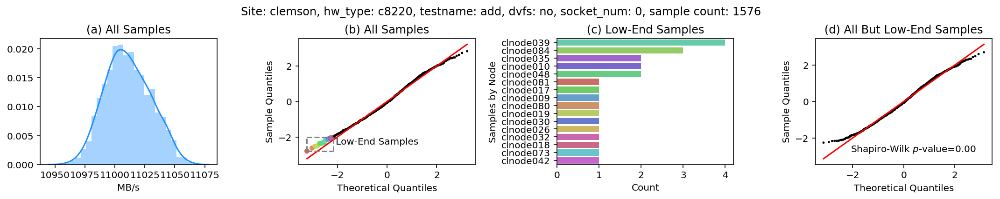

/notebooks/output/mem-qq-analysis-c8220-add-no-0.pdf

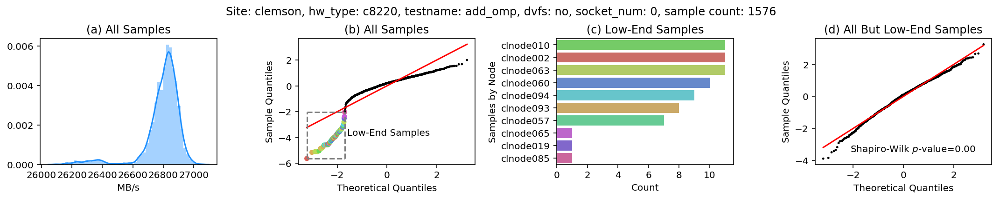

/notebooks/output/mem-qq-analysis-c8220-add_omp-no-0.pdf

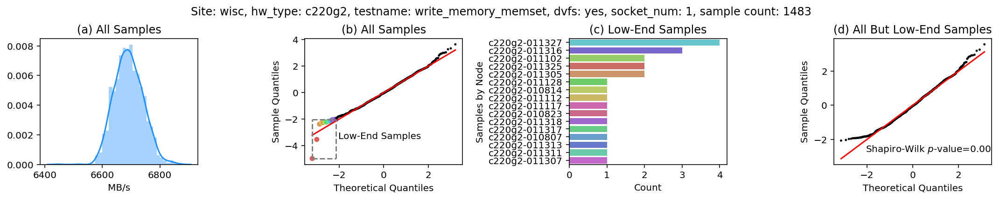

/notebooks/output/mem-qq-analysis-c220g2-write_memory_memset-yes-1.pdf

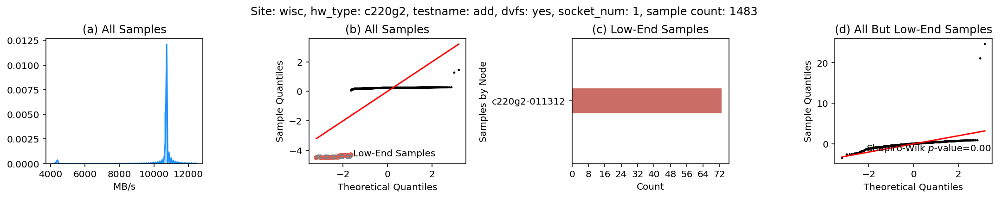

/notebooks/output/mem-qq-analysis-c220g2-add-yes-1.pdf

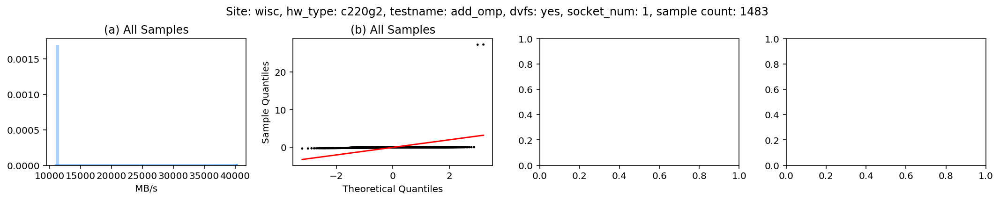

/notebooks/output/mem-qq-analysis-c220g2-add_omp-yes-1.pdf

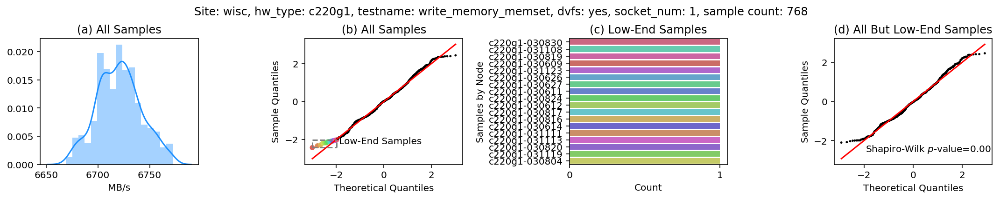

/notebooks/output/mem-qq-analysis-c220g1-write_memory_memset-yes-1.pdf

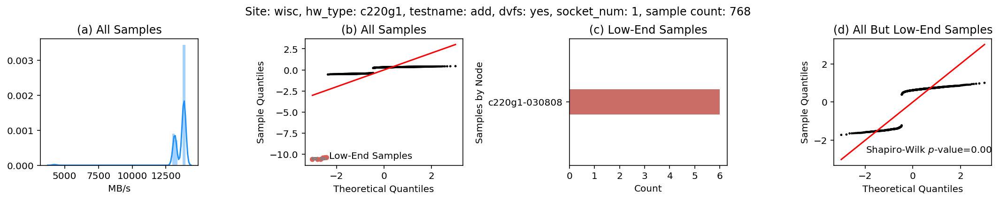

/notebooks/output/mem-qq-analysis-c220g1-add-yes-1.pdf

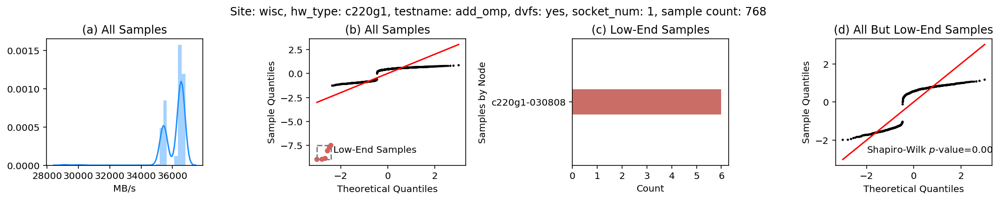

/notebooks/output/mem-qq-analysis-c220g1-add_omp-yes-1.pdf

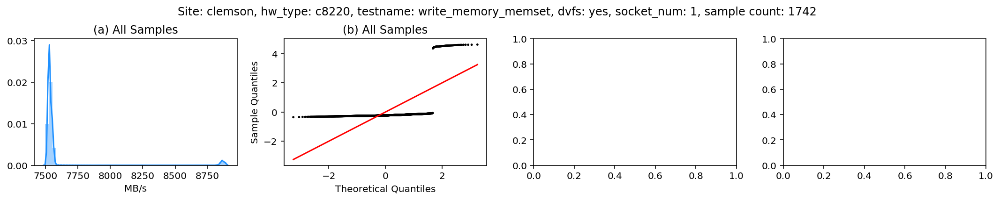

/notebooks/output/mem-qq-analysis-c8220-write_memory_memset-yes-1.pdf

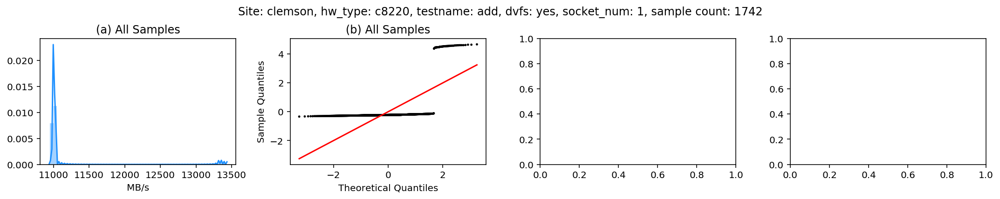

/notebooks/output/mem-qq-analysis-c8220-add-yes-1.pdf

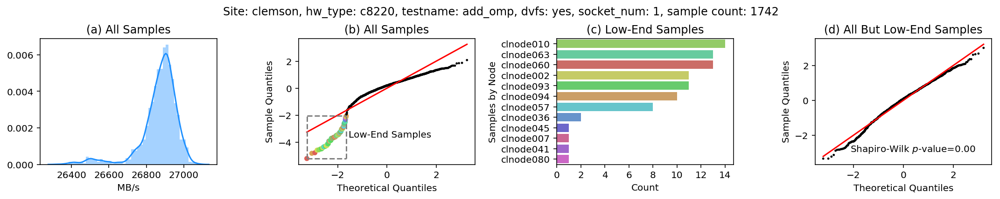

/notebooks/output/mem-qq-analysis-c8220-add_omp-yes-1.pdf

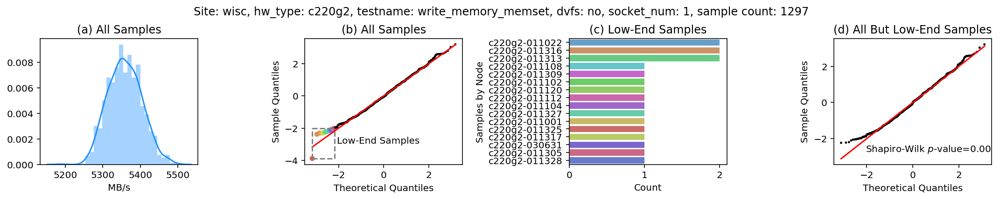

/notebooks/output/mem-qq-analysis-c220g2-write_memory_memset-no-1.pdf

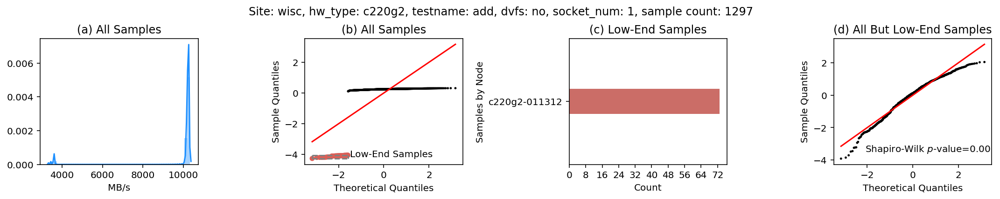

/notebooks/output/mem-qq-analysis-c220g2-add-no-1.pdf

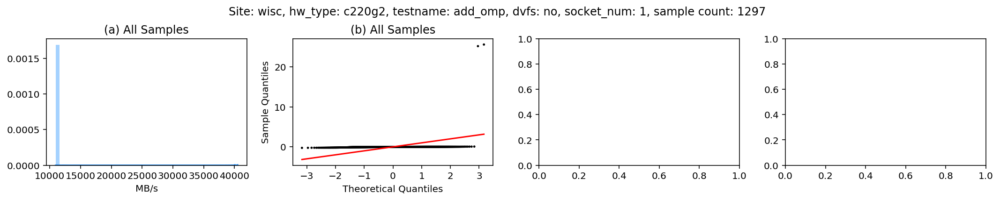

/notebooks/output/mem-qq-analysis-c220g2-add_omp-no-1.pdf

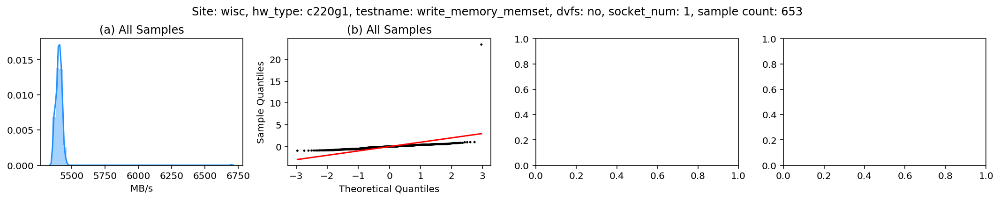

/notebooks/output/mem-qq-analysis-c220g1-write_memory_memset-no-1.pdf

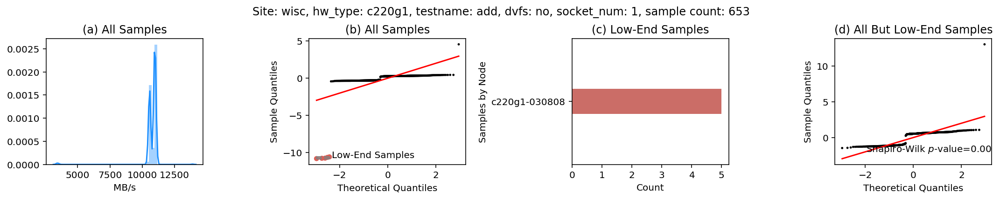

/notebooks/output/mem-qq-analysis-c220g1-add-no-1.pdf

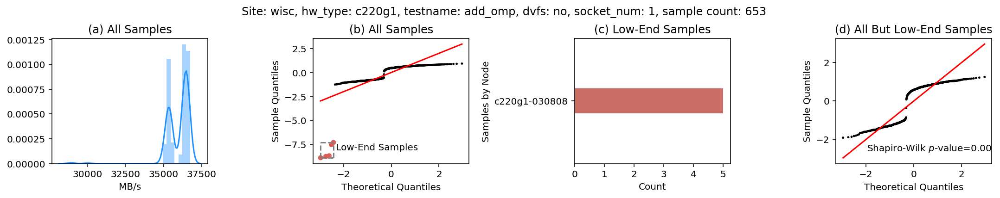

/notebooks/output/mem-qq-analysis-c220g1-add_omp-no-1.pdf

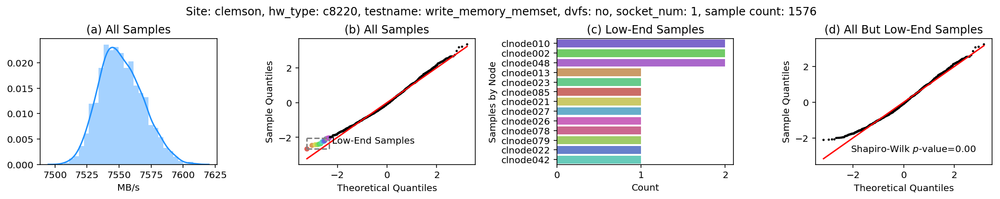

/notebooks/output/mem-qq-analysis-c8220-write_memory_memset-no-1.pdf

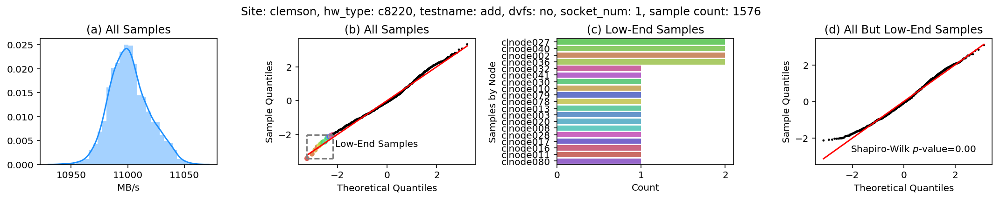

/notebooks/output/mem-qq-analysis-c8220-add-no-1.pdf

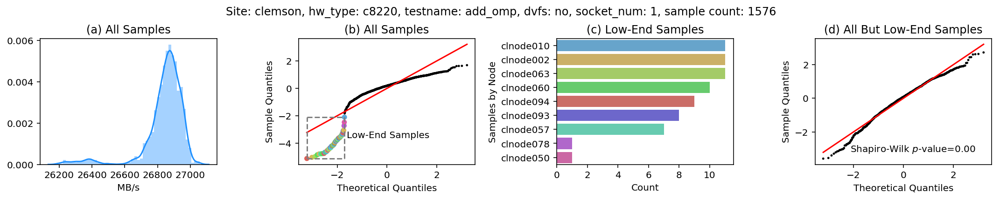

/notebooks/output/mem-qq-analysis-c8220-add_omp-no-1.pdf

In [16]:
# New version of qq analysis, copied from disk-process notebook

def qq_plot(df, col, empirical_q_thresh, ax, rectangle=True, title="(b) All Samples", show_sw=False):
    
    tmp_df = df.copy()
    
    tmp_df["z"] = (tmp_df[col]-tmp_df[col].mean())/tmp_df[col].std()
    
    ordered_df = tmp_df.sort_values("z")

    # Manually constructs vectors for qq-plot
    n = len(df)
    q = np.linspace(1.0/(n+1), 1.0 - 1.0/(n+1), num=n)  
    ordered_df["theor_qv"] = norm.ppf(q)
    
    low_end = ordered_df[ordered_df["z"] < empirical_q_thresh]

    node_color_map = get_cmap(low_end, "nodeid", palette="hls")
    low_end_x = ordered_df["theor_qv"].tolist()
    low_end_y = ordered_df["z"].tolist()
    low_end_c = ["black" if row["z"] >= empirical_q_thresh else node_color_map[row["nodeid"]] 
                 for idx, row in ordered_df.iterrows()]
    low_end_s = [2.0 if row["z"] >= empirical_q_thresh else 20.0 
                 for idx, row in ordered_df.iterrows()]
    
    ax.scatter(low_end_x, low_end_y, c=low_end_c, s=low_end_s);
    
    ax.plot([ordered_df["theor_qv"].min(), ordered_df["theor_qv"].max()], 
                 [ordered_df["theor_qv"].min(), ordered_df["theor_qv"].max()], '-', c="red")
    
    ax.set_xlabel("Theoretical Quantiles")
    ax.set_ylabel("Sample Quantiles")
    
    ax.set_title(title)
    
    # Create rectange around points below thresh
    if rectangle and (len(low_end["nodeid"].unique()) > 0):
        r_x_min = low_end["theor_qv"].min()
        r_x_max = low_end["theor_qv"].max()
        r_y_min = low_end["z"].min()
        r_y_max = low_end["z"].max()
        ax.plot([r_x_min, r_x_max], [r_y_min, r_y_min], '--', c="gray")
        ax.plot([r_x_min, r_x_max], [r_y_max, r_y_max], '--', c="gray")
        ax.plot([r_x_min, r_x_min], [r_y_min, r_y_max], '--', c="gray")
        ax.plot([r_x_max, r_x_max], [r_y_min, r_y_max], '--', c="gray")
        
        ax.annotate("Low-End Samples", xy=(r_x_max+0.1, (r_y_min + r_y_max)/2.0))
        
    if show_sw:
        (xmin, xmax) = ax.get_xlim()
        (ymin, ymax) = ax.get_ylim()
        ax.annotate(r'Shapiro-Wilk $p$-value=%.2f'% stats.shapiro(ordered_df[col])[1], 
                     xy=(xmin + 0.2 * (xmax - xmin), ymin + 0.1 * (ymax - ymin))) 
    
    #print stats.shapiro(ordered_df[col])[1]
    
    return low_end["nodeid"].value_counts(), node_color_map 
    
def qq_analysis(hw_type, testname, dvfs, socket_num, thresh=-3.0, label_offset_scale=160, label=True):
    color_map = get_cmap(mem_all, "hw_type")
    
    subset = subset_df(mem_all, {"hw_type": hw_type, "testname": testname, "dvfs": dvfs, "socket_num": socket_num})
    
    #if column2val(subset, "units") == "KB/s":
    #    subset["mean"] = subset["mean"] / 1024.0 
    #    subset["min"] = subset["min"] / 1024.0 
    #    subset["max"] = subset["max"] / 1024.0
    #    new_unit = "MB/s"
    #else:
    #    print "Error: unexpected bw performance unit"
    new_unit = column2val(subset, "units")

    #fig, axes = plt.subplots(1, 4, figsize=(15, 7.0))
    fig, axes = plt.subplots(1, 4, figsize=(15, 3))

    sns.distplot(subset["mean"], color="dodgerblue", ax = axes[0]);
    #sns.distplot(subset["min"], color="gray", ax = axes[0]);
    #sns.distplot(subset["max"], color="gray", ax = axes[0]);

    axes[0].set_xlabel(new_unit)
    axes[0].set_title("(a) All Samples")

    node_counts, node_color_map = qq_plot(subset, "mean", thresh, axes[1])
    low_end_nodes = node_counts.index.tolist()
    #print "Low-end nodes:", sorted(low_end_nodes)
    #print "All nodes:", sorted(subset.nodeid.unique())

    if low_end_nodes:

        if len(low_end_nodes) > 0:
            
            sns.barplot(x=node_counts.tolist(), y=low_end_nodes,  
                            palette=sns.color_palette([node_color_map[v] for v in low_end_nodes]), ax=axes[2])
            
            axes[2].xaxis.set_major_locator(MaxNLocator(integer=True))
            
            if len(low_end_nodes) == 1:
                # Example of changing width (changed to height) of bars:
                # https://stackoverflow.com/questions/34888058/changing-width-of-bars-in-bar-chart-created-using-seaborn-factorplot
                
                for patch in axes[2].patches :
                    current_width = patch.get_height()
                    diff = current_width - 0.2

                    # we change the bar width
                    patch.set_height(0.2)

                    # we recenter the bar
                    patch.set_y(patch.get_y() + diff * .5)

        #axes[2].set_xticks(range(node_counts.max() + 1)) 

        axes[2].set_xlabel("Count")
        axes[2].set_ylabel("Samples by Node")
        axes[2].set_title("(c) Low-End Samples")

        # Draw qq-plot without the low_end
        _,_ = qq_plot(subset[subset["nodeid"].apply(lambda x: not x in low_end_nodes)], "mean", -100, 
                      axes[3], rectangle=False, title="(d) All But Low-End Samples", show_sw=True)
    
    #fig.suptitle("hw_type: %s, device: %s, testname: %s, iodepth: %d, # of samples: %d" % \
    #             (hw_type, device, testname, iodepth, len(subset)))
    
    fig.suptitle("Site: %s, hw_type: %s, testname: %s, dvfs: %s, socket_num: %s, sample count: %d" % \
                 (column2val(subset, "site"), hw_type, testname, dvfs, socket_num, len(subset)))
    
    fig.tight_layout()
    plt.subplots_adjust(top=0.82);
    #plt.subplots_adjust(wspace = 0.3)
    
    plot_show_and_save(fig, "mem-qq-analysis-%s-%s-%s-%s.pdf" % (hw_type, testname, dvfs, socket_num), dest_dir)
    #plot_show_and_save(fig, show_only=True)


for d in ["yes"]:
    for t in  ["m400", "c220g2", "c220g1"]:
        for tn in ["write_memory_memset", "add", "add_omp"]:
            qq_analysis(t, tn, d, 0, thresh=-2.0, label=False)

for s in [0, 1]:
    for d in ["yes", "no"]:
        for t in  ["c220g2", "c220g1", "c8220"]:
            for tn in ["write_memory_memset", "add", "add_omp"]:
                qq_analysis(t, tn, d, s, thresh=-2.0, label=False)

('c220g2', 'add', 'no', 0) 1297


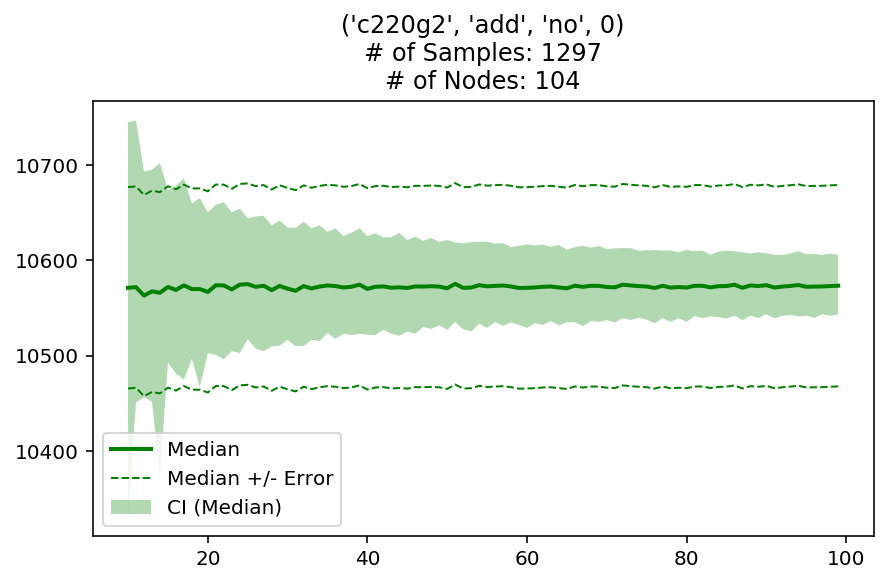

('c220g2', 'add', 'no', 1) 1297


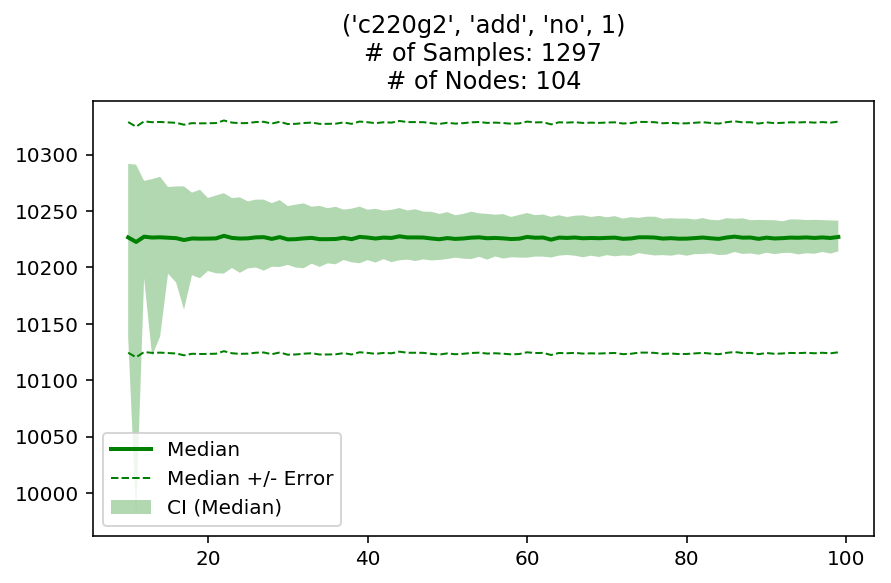

('c220g2', 'add', 'yes', 0) 1483


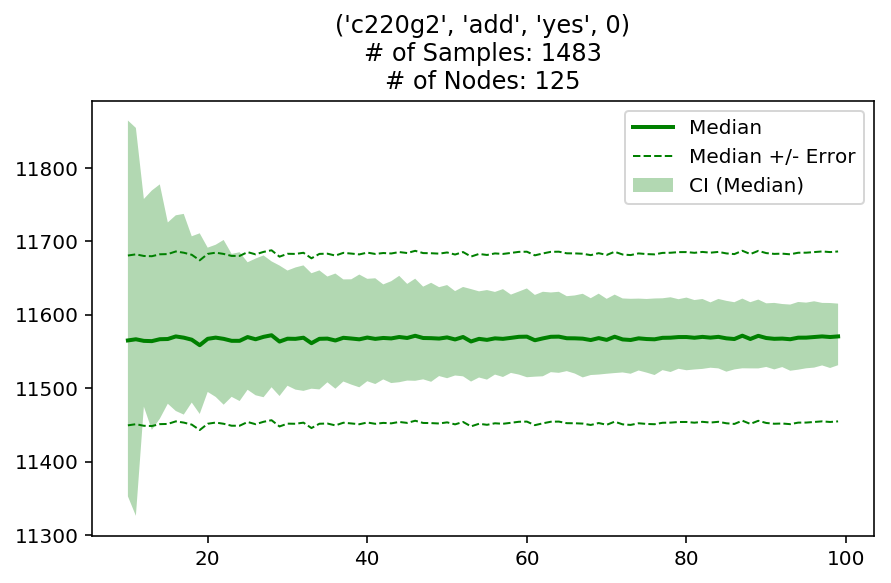

('c220g2', 'add', 'yes', 1) 1483


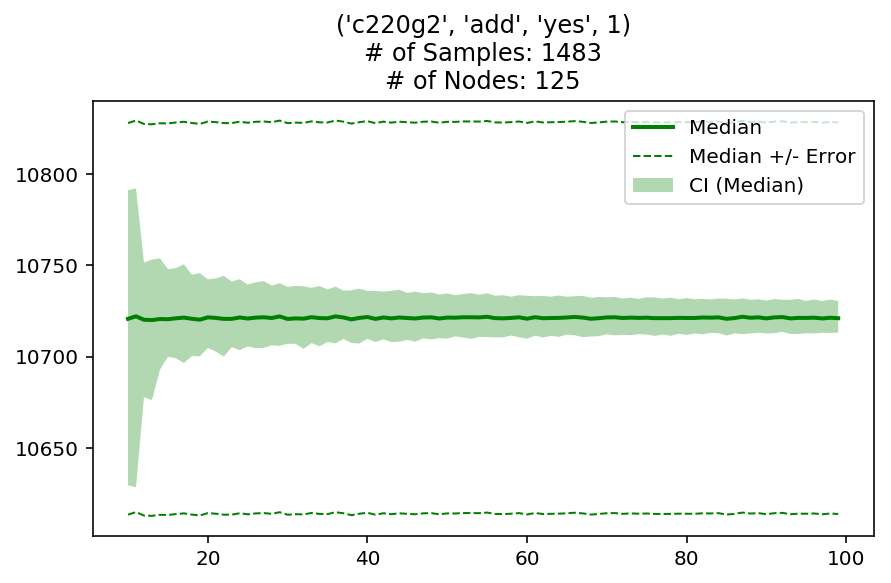

('c220g2', 'add_omp', 'no', 0) 1297


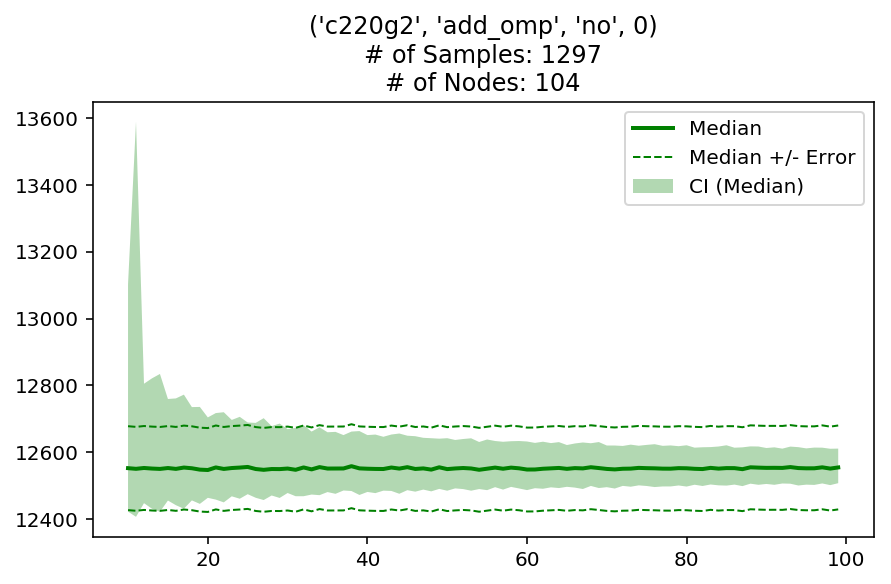

('c220g2', 'add_omp', 'no', 1) 1297


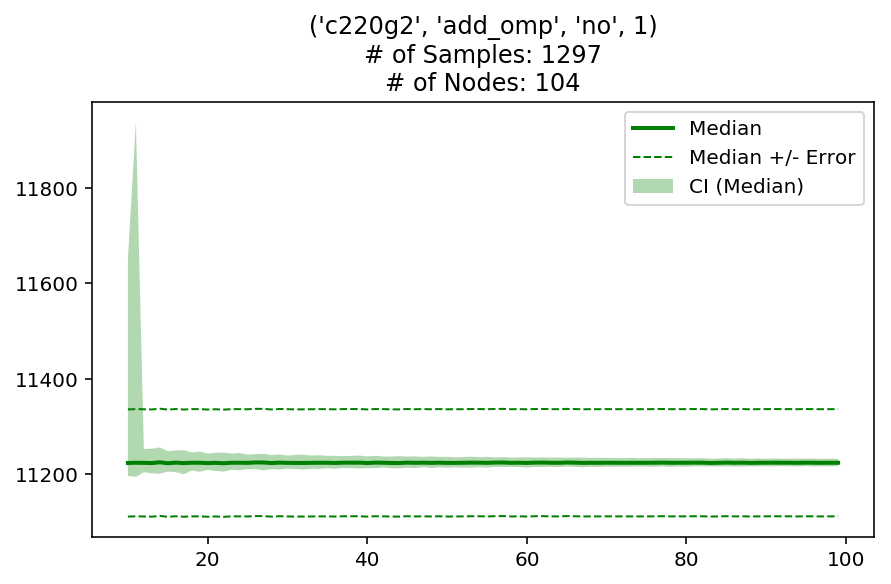

('c220g2', 'add_omp', 'yes', 0) 1483


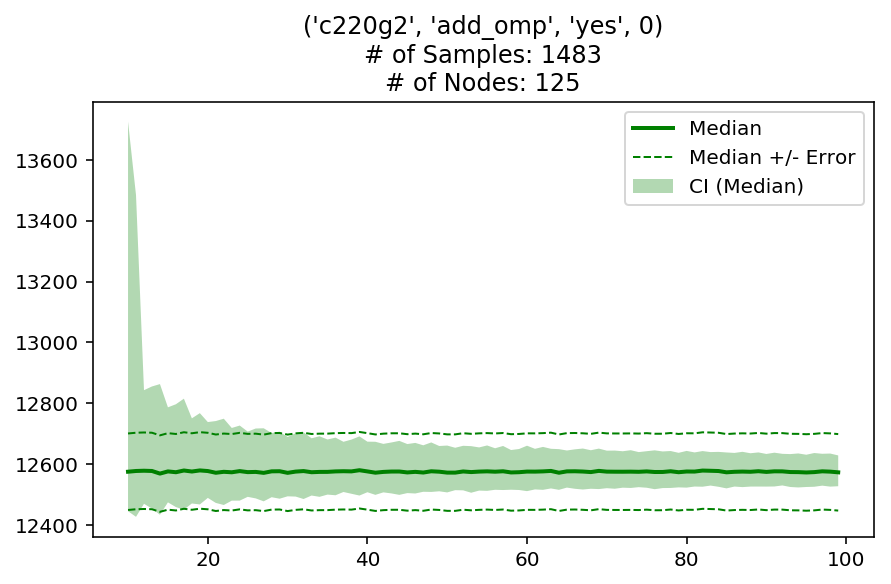

('c220g2', 'add_omp', 'yes', 1) 1483


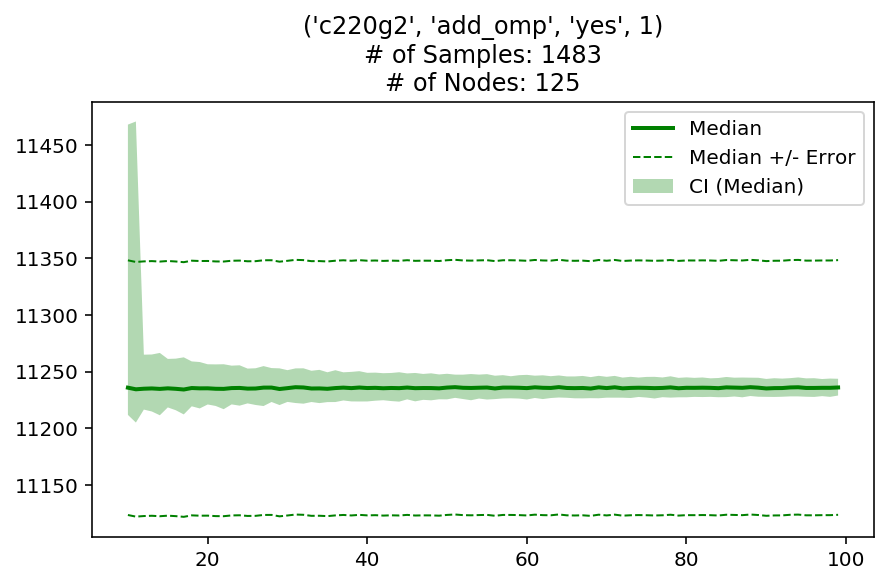

In [17]:
def median_and_ci(s):
    """ For a value series (or dataframe column), return median and median CI, as defined 
    using nonparametric statistics
    
    - Details: http://www.ucl.ac.uk/ich/short-courses-events/about-stats-courses/stats-rm/Chapter_8_Content/confidence_interval_single_median
    - 1.96 is the factor computed for 0.95 confidence limit
    """
    n = len(s)
    s_median = s.median()
    lo_rank = int(np.rint(n / 2.0 - 1.96 * np.sqrt(n) / 2.0))
    hi_rank = int(np.rint(1 + n / 2.0 + 1.96 * np.sqrt(n) / 2.0))
    s_sorted = sorted(s.tolist())
    lo_val = s_sorted[lo_rank]
    hi_val = s_sorted[hi_rank]
    
    return s_median, lo_val, hi_val 


allowed_err = 0.01

selected_mem_all = mem_all[mem_all["testname"].isin(["add", "add_omp"])]
selected_mem_all = selected_mem_all[selected_mem_all["hw_type"] == "c220g2"]

for idx, grp in selected_mem_all.groupby(["hw_type", "testname", "dvfs", "socket_num"]):
    print idx, len(grp)

    sample_stats = []
    for sample_size in range(10, 100):
        for rep in range(300):

            # Use different seed for each repetition
            np.random.seed()
            selected_sample = grp.sample(sample_size)
            med, ci_lb, ci_ub = median_and_ci(selected_sample["mean"])

            sample_stats.append({"rep": rep, 
                                 "sample_size": sample_size, 
                                 "med": med, 
                                 "ci_lb": ci_lb, 
                                 "ci_ub": ci_ub})

    sample_df = pd.DataFrame(sample_stats)
    
    fig, ax = plt.subplots(1, figsize=(7,4))

    df_avg = sample_df.groupby(['sample_size']).mean()
    df_avg["desired_lb"] = df_avg.med - allowed_err * df_avg.med
    df_avg["desired_ub"] = df_avg.med + allowed_err * df_avg.med

    ax.plot(df_avg.index, df_avg.med, lw = 2.0, c="green", alpha = 1.0, label="Median")
    ax.plot(df_avg.index, df_avg["desired_lb"], '--', lw = 1.0, c="green", alpha = 1.0, label="Median +/- Error")
    ax.plot(df_avg.index, df_avg["desired_ub"], '--', lw = 1.0, c="green", alpha = 1.0, label="_nolegend_")

    ax.fill_between(df_avg.index, 
                    df_avg.ci_lb, 
                    df_avg.ci_ub, 
                    facecolor="green", alpha=0.3, label="CI (Median)")
    
    ax.set_title(str(idx) + "\n# of Samples: %d\n# of Nodes: %d" % (len(grp), len(grp.nodeid.unique())))

    ax.legend()
    plot_show_and_save(fig, show_only=True)